# N=1, M=5, T=10: Observation Sequence Optimization Analysis

This notebook analyzes the precision sampling results to select optimal observation sequences for the final experiment.

**Design**: N=1 (simple utterance space: 8 utterances), M=5 trials, T=10 time steps

**Goal**: Find observation sequences that:
1. Have high discriminability (large ll_gap) for BOTH T and F speaker variants
2. Have reasonable observation likelihood (not too extreme)

**Key difference from N>1**: Observations are single integers 0-5 (successes in 5 trials) rather than frequency tuples.

# Data Extraction

In [1]:
import pickle
import numpy as np
import pandas as pd
from pathlib import Path
from typing import Dict, List, Tuple
import warnings

warnings.filterwarnings('ignore')

# Configuration for N=1, M=5, T=10
RESULTS_DIR = "/home/groups/rxdh/optimize_obs_seq_n1m5"

# All files to load based on coarse screening results
# Format: (psi, theta, speaker_version)
FILE_CONFIGS = [
    # Informative (theta 0.3, 0.7)
    ("inf", 0.3, "T"),
    ("inf", 0.3, "F"),
    ("inf", 0.7, "T"),
    ("inf", 0.7, "F"),
    # Persuade-up (theta 0.2, 0.3)
    ("persp", 0.2, "T"),
    ("persp", 0.2, "F"),
    ("persp", 0.3, "T"),
    ("persp", 0.3, "F"),
    # Persuade-down (theta 0.7, 0.8)
    ("persm", 0.7, "T"),
    ("persm", 0.7, "F"),
    ("persm", 0.8, "T"),
    ("persm", 0.8, "F"),
]

# Model names
ALL_MODELS = ["literal", "inf_T", "inf_F", "persp_T", "persp_F", "persm_T", "persm_F"]

FITTED_KEYS = {
    "literal": "literal_fitted",
    "inf_T": "inf_T_fitted",
    "inf_F": "inf_F_fitted",
    "persp_T": "persp_T_fitted",
    "persp_F": "persp_F_fitted",
    "persm_T": "persm_T_fitted",
    "persm_F": "persm_F_fitted",
}

# Define wrong-goal models for each speaker
# These are models with DIFFERENT psi (goal)
WRONG_GOAL_MODELS = {
    "inf_T": ["literal", "persp_T", "persp_F", "persm_T", "persm_F"],
    "inf_F": ["literal", "persp_T", "persp_F", "persm_T", "persm_F"],
    "persp_T": ["literal", "inf_T", "inf_F", "persm_T", "persm_F"],
    "persp_F": ["literal", "inf_T", "inf_F", "persm_T", "persm_F"],
    "persm_T": ["literal", "inf_T", "inf_F", "persp_T", "persp_F"],
    "persm_F": ["literal", "inf_T", "inf_F", "persp_T", "persp_F"],
}

# T=10 for N=1 design (from coarse screening)
T = 10


def load_obs_data(filepath: Path) -> dict:
    """Load a pickle file."""
    with open(filepath, "rb") as f:
        return pickle.load(f)


def get_filepath(psi: str, theta: float, update: str) -> Path:
    """Construct filepath for a given (psi, theta, update)."""
    theta_str = str(theta).replace(".", "_")
    speaker = f"{psi}_{update}"
    filename = f"obs_seq_{speaker}_{theta_str}.pkl"
    return Path(RESULTS_DIR) / filename


# Load all files
print("\nLoading data files...")
all_data = {}

for psi, theta, update in FILE_CONFIGS:
    filepath = get_filepath(psi, theta, update)
    key = (psi, theta, update)
    
    print(f"  Loading {filepath.name}...", end=" ")
    
    if filepath.exists():
        all_data[key] = load_obs_data(filepath)
        n_obs = len(all_data[key]["observations"][theta])
        print(f"OK ({n_obs} obs_seq)")
    else:
        print(f"NOT FOUND!")
        all_data[key] = None

print(f"\nLoaded {sum(1 for v in all_data.values() if v is not None)}/{len(FILE_CONFIGS)} files")


Loading data files...
  Loading obs_seq_inf_T_0_3.pkl... OK (1000 obs_seq)
  Loading obs_seq_inf_F_0_3.pkl... OK (1000 obs_seq)
  Loading obs_seq_inf_T_0_7.pkl... OK (1000 obs_seq)
  Loading obs_seq_inf_F_0_7.pkl... OK (1000 obs_seq)
  Loading obs_seq_persp_T_0_2.pkl... OK (1000 obs_seq)
  Loading obs_seq_persp_F_0_2.pkl... OK (1000 obs_seq)
  Loading obs_seq_persp_T_0_3.pkl... OK (1000 obs_seq)
  Loading obs_seq_persp_F_0_3.pkl... OK (1000 obs_seq)
  Loading obs_seq_persm_T_0_7.pkl... OK (1000 obs_seq)
  Loading obs_seq_persm_F_0_7.pkl... OK (1000 obs_seq)
  Loading obs_seq_persm_T_0_8.pkl... OK (1000 obs_seq)
  Loading obs_seq_persm_F_0_8.pkl... OK (1000 obs_seq)

Loaded 12/12 files


In [2]:
all_data.keys()

dict_keys([('inf', 0.3, 'T'), ('inf', 0.3, 'F'), ('inf', 0.7, 'T'), ('inf', 0.7, 'F'), ('persp', 0.2, 'T'), ('persp', 0.2, 'F'), ('persp', 0.3, 'T'), ('persp', 0.3, 'F'), ('persm', 0.7, 'T'), ('persm', 0.7, 'F'), ('persm', 0.8, 'T'), ('persm', 0.8, 'F')])

In [3]:
def extract_obs_seq_data(
    obs_data: dict,
    psi: str,
    theta: float,
    update: str,  # "T" or "F"
) -> pd.DataFrame:
    """
    Extract observation-level data from a single file.
    
    For each obs_seq:
    - Observation likelihood
    - Mean ll_gap against each wrong model (averaged over utterances)
    - The actual observation sequence itself
    
    Note: For N=1, observations are single integers (0 to M), not tuples.
    
    Returns DataFrame with one row per obs_seq.
    """
    
    speaker_key = f"{psi}_{update}"  # e.g., "inf_T"
    true_fitted_key = FITTED_KEYS[speaker_key]
    
    observations = obs_data["observations"][theta]
    
    rows = []
    
    for obs_info in observations:
        obs_id = obs_info["obs_idx"]
        
        # Get observation sequence likelihood
        obs_log_lik = obs_info.get("log_lik_true_theta", {}).get(T, np.nan)
        
        # Get the observation sequence itself
        # For N=1: list of integers (e.g., [2, 3, 1, 4, 2, ...])
        # For N>1: list of tuples (e.g., [(2,1,1,0,1), ...])
        obs_seq = obs_info.get("obs_seq", None)
        
        # Get utterances for this speaker
        alpha = 4.0 if psi != "literal" else 0.0
        
        if "utterances" not in obs_info or speaker_key not in obs_info["utterances"]:
            continue
        
        utt_records = obs_info["utterances"][speaker_key].get(alpha, [])
        
        if len(utt_records) == 0:
            continue
        
        # Compute mean fitted_ll for each model across all utterances
        model_lls = {model: [] for model in ALL_MODELS}
        
        for utt_rec in utt_records:
            fitted_lls = utt_rec.get("log_lik_all_speaker", {})
            
            for model in ALL_MODELS:
                fitted_key = FITTED_KEYS[model]
                ll = fitted_lls.get(fitted_key, {}).get("max_log_lik", {}).get(T, np.nan)
                model_lls[model].append(ll)
        
        # Compute means
        mean_lls = {model: np.nanmean(lls) for model, lls in model_lls.items()}
        
        # Get true model ll
        true_ll = mean_lls[speaker_key]
        
        # Compute ll_gap against each wrong model
        ll_gaps = {}
        for model in ALL_MODELS:
            if model == speaker_key:
                continue
            ll_gaps[model] = true_ll - mean_lls[model]
        
        # Compute aggregate metrics
        all_wrong_gaps = [ll_gaps[m] for m in ALL_MODELS if m != speaker_key]
        min_all = np.min(all_wrong_gaps) if all_wrong_gaps else np.nan
        
        wrong_goal = WRONG_GOAL_MODELS[speaker_key]
        wrong_goal_gaps = [ll_gaps[m] for m in wrong_goal]
        min_goal = np.min(wrong_goal_gaps) if wrong_goal_gaps else np.nan
        
        # Store row
        row = {
            "psi": psi,
            "theta": theta,
            "update": update,
            "speaker": speaker_key,
            "obs_id": obs_id,
            "obs_seq": obs_seq,  # The actual observation sequence
            "obs_log_lik": obs_log_lik,
            "n_utterances": len(utt_records),
            "true_model_ll": true_ll,
            "min_ll_gap_all": min_all,
            "min_ll_gap_goal": min_goal,
        }
        
        # Add individual ll_gaps
        for model, gap in ll_gaps.items():
            row[f"ll_gap_{model}"] = gap
        
        # Add individual mean lls (for debugging)
        for model, ll in mean_lls.items():
            row[f"mean_ll_{model}"] = ll
        
        rows.append(row)
    
    return pd.DataFrame(rows)

In [4]:
# Extract data from all files
print("\nExtracting observation-level data...")

all_dfs = []

for psi, theta, update in FILE_CONFIGS:
    key = (psi, theta, update)
    
    if all_data[key] is None:
        print(f"  Skipping {psi}_{update} theta={theta} (no data)")
        continue
    
    print(f"  Processing {psi}_{update} theta={theta}...", end=" ")
    
    df = extract_obs_seq_data(all_data[key], psi, theta, update)
    all_dfs.append(df)
    
    print(f"{len(df)} obs_seq")

# Combine all
df_all = pd.concat(all_dfs, ignore_index=True)

print(f"\nTotal records: {len(df_all)}")
print(f"Columns: {df_all.columns.tolist()}")


Extracting observation-level data...
  Processing inf_T theta=0.3... 1000 obs_seq
  Processing inf_F theta=0.3... 1000 obs_seq
  Processing inf_T theta=0.7... 1000 obs_seq
  Processing inf_F theta=0.7... 1000 obs_seq
  Processing persp_T theta=0.2... 1000 obs_seq
  Processing persp_F theta=0.2... 1000 obs_seq
  Processing persp_T theta=0.3... 1000 obs_seq
  Processing persp_F theta=0.3... 1000 obs_seq
  Processing persm_T theta=0.7... 1000 obs_seq
  Processing persm_F theta=0.7... 1000 obs_seq
  Processing persm_T theta=0.8... 1000 obs_seq
  Processing persm_F theta=0.8... 1000 obs_seq

Total records: 12000
Columns: ['psi', 'theta', 'update', 'speaker', 'obs_id', 'obs_seq', 'obs_log_lik', 'n_utterances', 'true_model_ll', 'min_ll_gap_all', 'min_ll_gap_goal', 'll_gap_literal', 'll_gap_inf_F', 'll_gap_persp_T', 'll_gap_persp_F', 'll_gap_persm_T', 'll_gap_persm_F', 'mean_ll_literal', 'mean_ll_inf_T', 'mean_ll_inf_F', 'mean_ll_persp_T', 'mean_ll_persp_F', 'mean_ll_persm_T', 'mean_ll_persm_

In [5]:
def pair_T_F_data(df: pd.DataFrame) -> pd.DataFrame:
    """
    Pair T and F data for the same observation sequences.
    
    Since T and F files with same seed and theta have identical obs_seq,
    we can join them by (psi, theta, obs_id).
    
    Returns DataFrame with one row per observation sequence,
    containing metrics from both T and F.
    """
    
    # Split into T and F
    df_T = df[df["update"] == "T"].copy()
    df_F = df[df["update"] == "F"].copy()
    
    # Rename columns for merge
    cols_to_rename_T = {
        "speaker": "speaker_T",
        "obs_log_lik": "obs_log_lik",  # Same for both
        "obs_seq": "obs_seq",  # Keep obs_seq (same for T and F)
        "n_utterances": "n_utterances_T",
        "true_model_ll": "true_model_ll_T",
        "min_ll_gap_all": "min_ll_gap_all_T",
        "min_ll_gap_goal": "min_ll_gap_goal_T",
    }
    
    cols_to_rename_F = {
        "speaker": "speaker_F",
        "n_utterances": "n_utterances_F",
        "true_model_ll": "true_model_ll_F",
        "min_ll_gap_all": "min_ll_gap_all_F",
        "min_ll_gap_goal": "min_ll_gap_goal_F",
    }
    
    # Add ll_gap columns
    for col in df_T.columns:
        if col.startswith("ll_gap_"):
            model = col.replace("ll_gap_", "")
            cols_to_rename_T[col] = f"ll_gap_{model}_T"
    
    for col in df_F.columns:
        if col.startswith("ll_gap_"):
            model = col.replace("ll_gap_", "")
            cols_to_rename_F[col] = f"ll_gap_{model}_F"
    
    # Select and rename columns
    merge_cols = ["psi", "theta", "obs_id"]
    
    df_T_renamed = df_T[merge_cols + list(cols_to_rename_T.keys())].rename(columns=cols_to_rename_T)
    df_F_renamed = df_F[merge_cols + list(cols_to_rename_F.keys())].rename(columns=cols_to_rename_F)
    
    # Remove obs_log_lik and obs_seq from F (they're the same as T)
    df_F_renamed = df_F_renamed.drop(columns=["obs_log_lik", "obs_seq"], errors="ignore")
    
    # Merge
    df_paired = df_T_renamed.merge(df_F_renamed, on=merge_cols, how="inner")
    
    return df_paired

In [6]:
df_paired = pair_T_F_data(df_all)

print(f"\nPaired data shape: {df_paired.shape}")
print(f"Columns: {df_paired.columns.tolist()}")

# Verify pairing
print(f"\nVerification:")
for psi in df_paired["psi"].unique():
    for theta in df_paired[df_paired["psi"] == psi]["theta"].unique():
        n = len(df_paired[(df_paired["psi"] == psi) & (df_paired["theta"] == theta)])
        print(f"  {psi}, theta={theta}: {n} obs_seq")


Paired data shape: (6000, 29)
Columns: ['psi', 'theta', 'obs_id', 'speaker_T', 'obs_log_lik', 'obs_seq', 'n_utterances_T', 'true_model_ll_T', 'min_ll_gap_all_T', 'min_ll_gap_goal_T', 'll_gap_literal_T', 'll_gap_inf_F_T', 'll_gap_persp_T_T', 'll_gap_persp_F_T', 'll_gap_persm_T_T', 'll_gap_persm_F_T', 'll_gap_inf_T_T', 'speaker_F', 'n_utterances_F', 'true_model_ll_F', 'min_ll_gap_all_F', 'min_ll_gap_goal_F', 'll_gap_literal_F', 'll_gap_inf_F_F', 'll_gap_persp_T_F', 'll_gap_persp_F_F', 'll_gap_persm_T_F', 'll_gap_persm_F_F', 'll_gap_inf_T_F']

Verification:
  inf, theta=0.3: 1000 obs_seq
  inf, theta=0.7: 1000 obs_seq
  persp, theta=0.2: 1000 obs_seq
  persp, theta=0.3: 1000 obs_seq
  persm, theta=0.7: 1000 obs_seq
  persm, theta=0.8: 1000 obs_seq


In [7]:
def harmonic_mean(a: float, b: float) -> float:
    """Compute harmonic mean of two positive values."""
    if a <= 0 or b <= 0:
        raise ValueError(
            f"Harmonic mean is only defined for positive values; got a={a}, b={b}"
        )
    return 2 * a * b / (a + b)


def compute_combined_metrics(df: pd.DataFrame) -> pd.DataFrame:
    """
    Compute combined T+F metrics for each observation sequence.
    
    Adds columns:
    - min_ll_gap_all_min: min(T, F) for all wrong models
    - min_ll_gap_all_mean: mean(T, F) for all wrong models
    - min_ll_gap_all_harmonic: harmonic_mean(T, F) for all wrong models
    - min_ll_gap_goal_min: min(T, F) for wrong-goal models
    - min_ll_gap_goal_mean: mean(T, F) for wrong-goal models
    - min_ll_gap_goal_harmonic: harmonic_mean(T, F) for wrong-goal models
    """
    
    df = df.copy()
    
    # Combined metrics for ALL wrong models
    df["min_ll_gap_all_min"] = df[["min_ll_gap_all_T", "min_ll_gap_all_F"]].min(axis=1)
    df["min_ll_gap_all_mean"] = df[["min_ll_gap_all_T", "min_ll_gap_all_F"]].mean(axis=1)
    df["min_ll_gap_all_harmonic"] = df.apply(
        lambda row: harmonic_mean(row["min_ll_gap_all_T"], row["min_ll_gap_all_F"]) 
        if row["min_ll_gap_all_T"] > 0 and row["min_ll_gap_all_F"] > 0 else np.nan, 
        axis=1
    )
    
    # Combined metrics for wrong-GOAL models only
    df["min_ll_gap_goal_min"] = df[["min_ll_gap_goal_T", "min_ll_gap_goal_F"]].min(axis=1)
    df["min_ll_gap_goal_mean"] = df[["min_ll_gap_goal_T", "min_ll_gap_goal_F"]].mean(axis=1)
    df["min_ll_gap_goal_harmonic"] = df.apply(
        lambda row: harmonic_mean(row["min_ll_gap_goal_T"], row["min_ll_gap_goal_F"]) 
        if row["min_ll_gap_goal_T"] > 0 and row["min_ll_gap_goal_F"] > 0 else np.nan, 
        axis=1
    )
    
    return df

In [8]:
df_combined = compute_combined_metrics(df_paired)
print("\nCombined metrics added.")
print(f"Columns: {df_combined.columns.tolist()}")


Combined metrics added.
Columns: ['psi', 'theta', 'obs_id', 'speaker_T', 'obs_log_lik', 'obs_seq', 'n_utterances_T', 'true_model_ll_T', 'min_ll_gap_all_T', 'min_ll_gap_goal_T', 'll_gap_literal_T', 'll_gap_inf_F_T', 'll_gap_persp_T_T', 'll_gap_persp_F_T', 'll_gap_persm_T_T', 'll_gap_persm_F_T', 'll_gap_inf_T_T', 'speaker_F', 'n_utterances_F', 'true_model_ll_F', 'min_ll_gap_all_F', 'min_ll_gap_goal_F', 'll_gap_literal_F', 'll_gap_inf_F_F', 'll_gap_persp_T_F', 'll_gap_persp_F_F', 'll_gap_persm_T_F', 'll_gap_persm_F_F', 'll_gap_inf_T_F', 'min_ll_gap_all_min', 'min_ll_gap_all_mean', 'min_ll_gap_all_harmonic', 'min_ll_gap_goal_min', 'min_ll_gap_goal_mean', 'min_ll_gap_goal_harmonic']


In [9]:
def compute_per_model_combined_metrics(df: pd.DataFrame) -> pd.DataFrame:
    """
    For each wrong model, compute combined T+F metrics.
    
    This allows us to see which specific comparison is the bottleneck.
    """
    
    df = df.copy()
    
    # Get all wrong model columns from T
    wrong_models = [c.replace("ll_gap_", "").replace("_T", "") 
                    for c in df.columns if c.startswith("ll_gap_") and c.endswith("_T")]
    
    for model in wrong_models:
        col_T = f"ll_gap_{model}_T"
        col_F = f"ll_gap_{model}_F"
        
        if col_T in df.columns and col_F in df.columns:
            # Min across T and F
            df[f"ll_gap_{model}_min"] = df[[col_T, col_F]].min(axis=1)
            # Harmonic mean
            df[f"ll_gap_{model}_harmonic"] = df.apply(
                lambda row: harmonic_mean(row[col_T], row[col_F]) 
                if pd.notna(row[col_T]) and pd.notna(row[col_F]) 
                   and row[col_T] > 0 and row[col_F] > 0 else np.nan, 
                axis=1
            )
    
    return df

In [10]:
df_combined = compute_per_model_combined_metrics(df_combined)

print("\nPer-model combined metrics added.")
print(f"Columns: {df_combined.columns.tolist()}")


Per-model combined metrics added.
Columns: ['psi', 'theta', 'obs_id', 'speaker_T', 'obs_log_lik', 'obs_seq', 'n_utterances_T', 'true_model_ll_T', 'min_ll_gap_all_T', 'min_ll_gap_goal_T', 'll_gap_literal_T', 'll_gap_inf_F_T', 'll_gap_persp_T_T', 'll_gap_persp_F_T', 'll_gap_persm_T_T', 'll_gap_persm_F_T', 'll_gap_inf_T_T', 'speaker_F', 'n_utterances_F', 'true_model_ll_F', 'min_ll_gap_all_F', 'min_ll_gap_goal_F', 'll_gap_literal_F', 'll_gap_inf_F_F', 'll_gap_persp_T_F', 'll_gap_persp_F_F', 'll_gap_persm_T_F', 'll_gap_persm_F_F', 'll_gap_inf_T_F', 'min_ll_gap_all_min', 'min_ll_gap_all_mean', 'min_ll_gap_all_harmonic', 'min_ll_gap_goal_min', 'min_ll_gap_goal_mean', 'min_ll_gap_goal_harmonic', 'll_gap_literal_min', 'll_gap_literal_harmonic', 'll_gap_inf_F_min', 'll_gap_inf_F_harmonic', 'll_gap_persp_F_min', 'll_gap_persp_F_harmonic', 'll_gap_persm_F_min', 'll_gap_persm_F_harmonic']


In [11]:
# Select key columns for the final output
output_cols = [
    # Identifiers
    "psi", "theta", "obs_id", "obs_seq",
    
    # Observation likelihood
    "obs_log_lik",
    
    # Individual version metrics
    "min_ll_gap_all_T", "min_ll_gap_all_F",
    "min_ll_gap_goal_T", "min_ll_gap_goal_F",
    
    # Combined metrics (all wrong models)
    "min_ll_gap_all_min", "min_ll_gap_all_mean", "min_ll_gap_all_harmonic",
    
    # Combined metrics (wrong-goal only)
    "min_ll_gap_goal_min", "min_ll_gap_goal_mean", "min_ll_gap_goal_harmonic",
]

df_output = df_combined[output_cols].copy()

print(f"\nColumns:\n{df_output.columns.tolist()}")


Columns:
['psi', 'theta', 'obs_id', 'obs_seq', 'obs_log_lik', 'min_ll_gap_all_T', 'min_ll_gap_all_F', 'min_ll_gap_goal_T', 'min_ll_gap_goal_F', 'min_ll_gap_all_min', 'min_ll_gap_all_mean', 'min_ll_gap_all_harmonic', 'min_ll_gap_goal_min', 'min_ll_gap_goal_mean', 'min_ll_gap_goal_harmonic']


In [12]:
df_output.head(5)

,psi,theta,obs_id,obs_seq,obs_log_lik,min_ll_gap_all_T,min_ll_gap_all_F,min_ll_gap_goal_T,min_ll_gap_goal_F,min_ll_gap_all_min,min_ll_gap_all_mean,min_ll_gap_all_harmonic,min_ll_gap_goal_min,min_ll_gap_goal_mean,min_ll_gap_goal_harmonic
0,inf,0.3,0,"[(0, 1, 0, 0, 0, 0), (0, 0, 1, 0, 0, 0), (1, 0...",-14.047825,2.855945,2.969024,5.019269,4.259403,2.855945,2.912484,2.911387,4.259403,4.639336,4.608222
1,inf,0.3,1,"[(0, 1, 0, 0, 0, 0), (0, 0, 0, 1, 0, 0), (0, 0...",-15.134432,0.859881,0.652990,4.348107,4.681000,0.652990,0.756436,0.742289,4.348107,4.514554,4.508417
2,inf,0.3,2,"[(0, 0, 0, 1, 0, 0), (0, 0, 1, 0, 0, 0), (0, 0...",-15.203424,1.198012,0.552508,6.174398,4.808370,0.552508,0.875260,0.756245,4.808370,5.491384,5.406431
3,inf,0.3,3,"[(0, 1, 0, 0, 0, 0), (0, 1, 0, 0, 0, 0), (0, 1...",-10.366497,1.333750,0.592459,1.550282,0.592459,0.592459,0.963105,0.820464,0.592459,1.071370,0.857293
4,inf,0.3,4,"[(1, 0, 0, 0, 0, 0), (0, 0, 0, 1, 0, 0), (0, 0...",-13.893675,1.454617,1.549658,4.498000,4.492683,1.454617,1.502137,1.500634,4.492683,4.495342,4.495340


# Analyze

## Before combining: T vs F comparison

In [13]:
import numpy as np
import matplotlib.pyplot as plt
from scipy.stats import pearsonr

def plot_value_comparisons_by_theta_psi(df, rank=False):
    """
    Plots scatter comparisons of columns grouped by 'psi' and 'theta'.
    If rank=True, x and y values are converted to ranks before plotting.
    """

    grouped = df.groupby(["psi", "theta"])

    comparisons = [
        ("min_ll_gap_all_T", "min_ll_gap_all_F", "ALL gaps: T vs F"),
        ("min_ll_gap_goal_T", "min_ll_gap_goal_F", "GOAL gaps: T vs F"),
        ("min_ll_gap_all_T", "min_ll_gap_goal_T", "T speaker: ALL vs GOAL"),
        ("min_ll_gap_all_F", "min_ll_gap_goal_F", "F speaker: ALL vs GOAL"),
    ]

    for (psi, theta), group in grouped:
        fig, axes = plt.subplots(2, 2, figsize=(12, 10))
        axes = axes.flatten()

        for ax, (xcol, ycol, title) in zip(axes, comparisons):
            data = group[[xcol, ycol]].dropna()

            if len(data) < 2:
                ax.set_title(title + "\n(insufficient data)")
                continue

            x = data[xcol].values
            y = data[ycol].values

            if rank:
                x = np.argsort(np.argsort(x))
                y = np.argsort(np.argsort(y))

            # Scatter
            ax.scatter(x, y, alpha=0.5, s=20)

            # y = x reference
            lims = [min(x.min(), y.min()), max(x.max(), y.max())]
            ax.plot(lims, lims, 'k--', alpha=0.5)

            # Correlation
            r, p = pearsonr(x, y)
            ax.set_title(f"{title}\nr = {r:.3f}, p = {p:.2e}")
            ax.set_xlabel(xcol)
            ax.set_ylabel(ycol)

        fig.suptitle(f"psi = {psi}, theta = {theta}" + (" (ranks)" if rank else ""), fontsize=14)
        plt.tight_layout()
        plt.show()

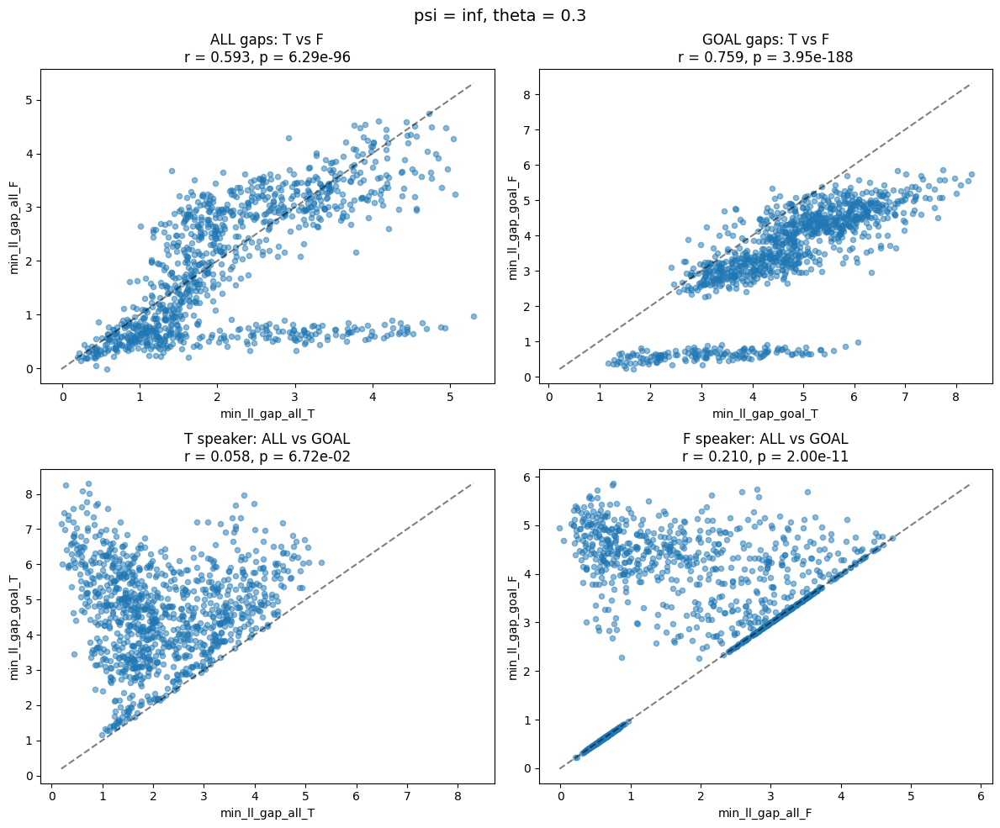

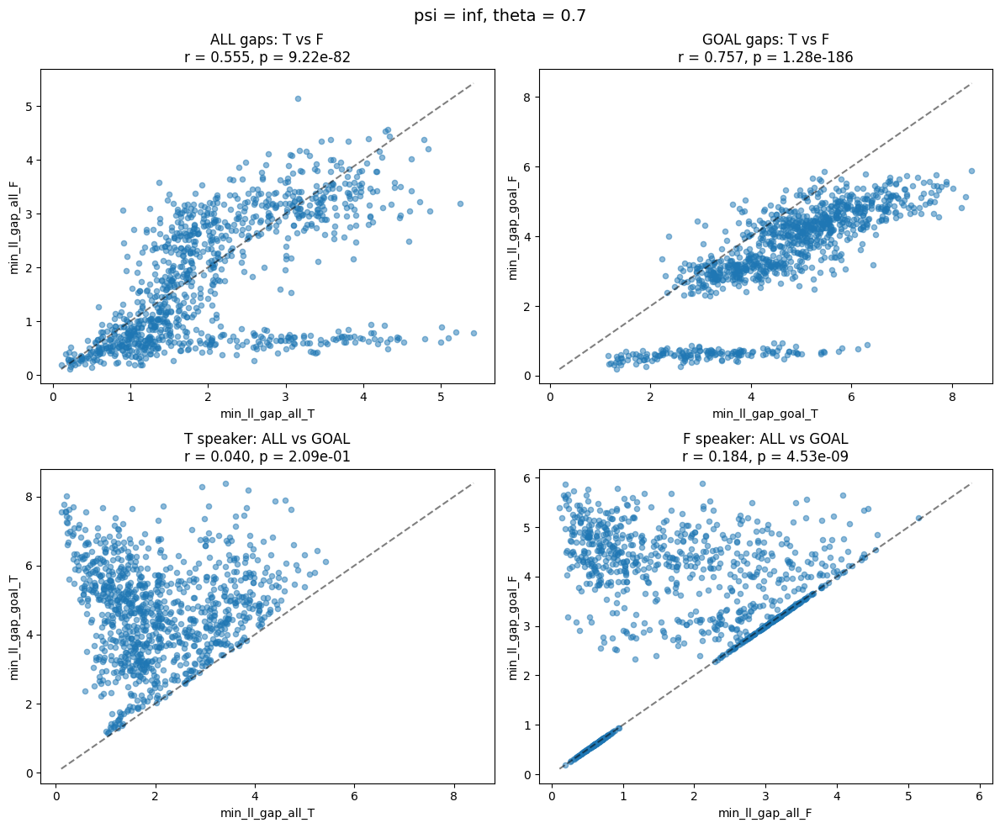

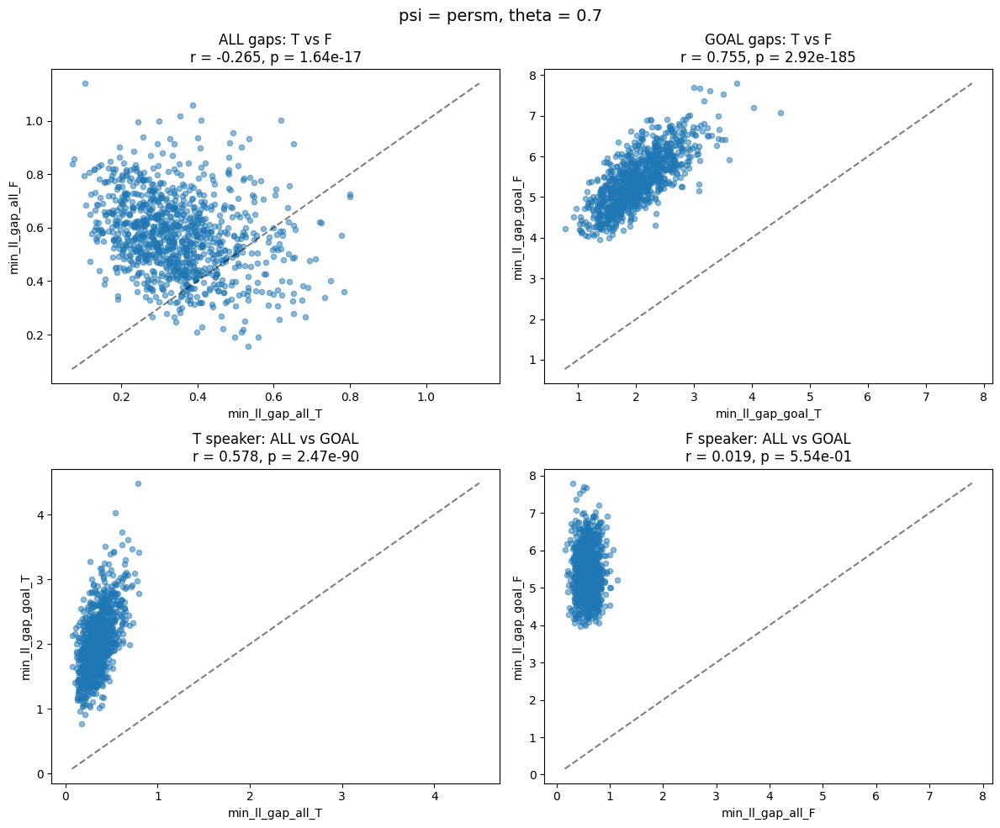

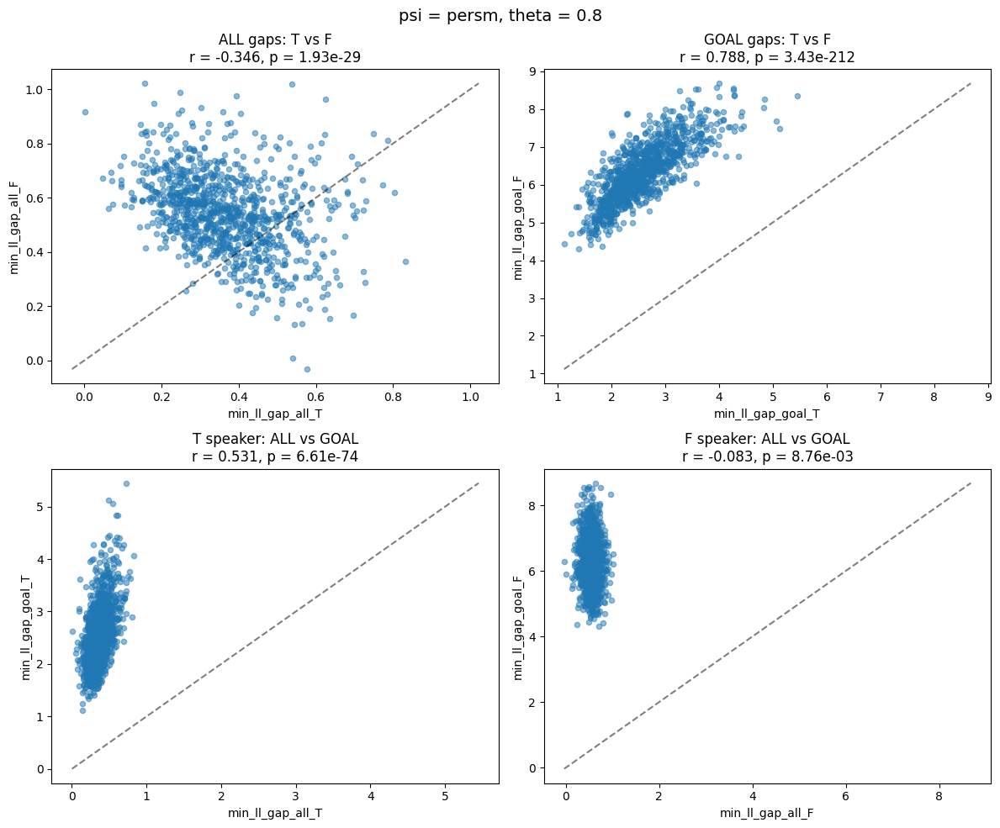

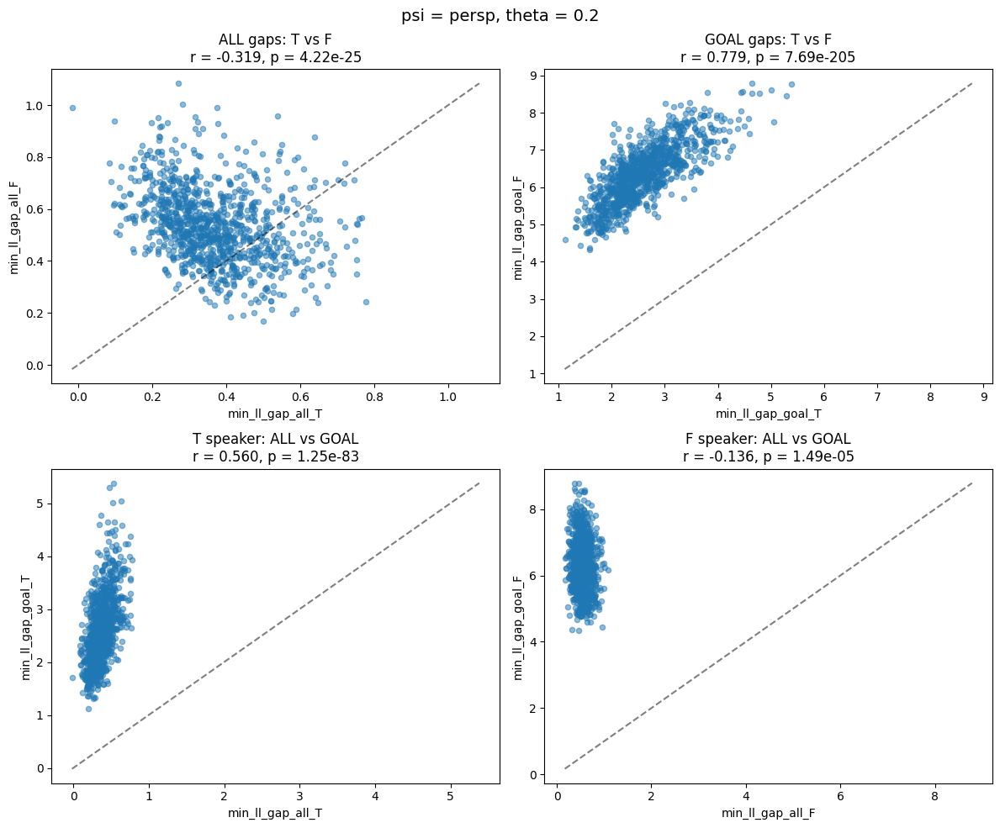

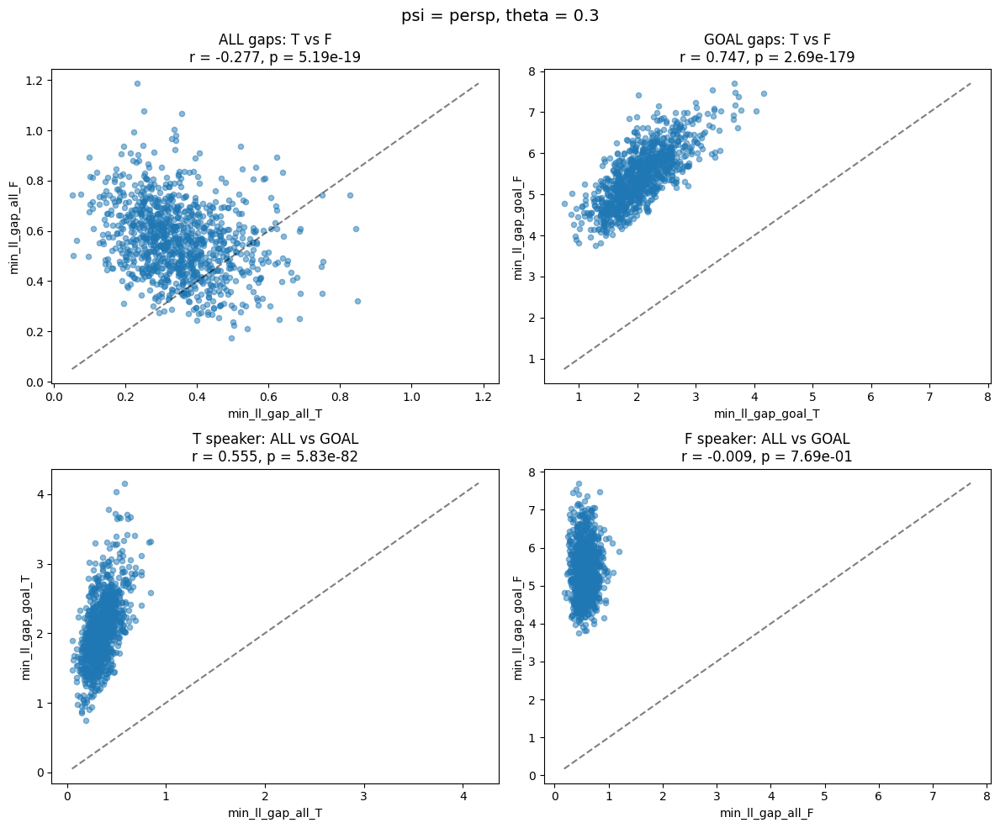

In [14]:
plot_value_comparisons_by_theta_psi(df_output, rank=False)

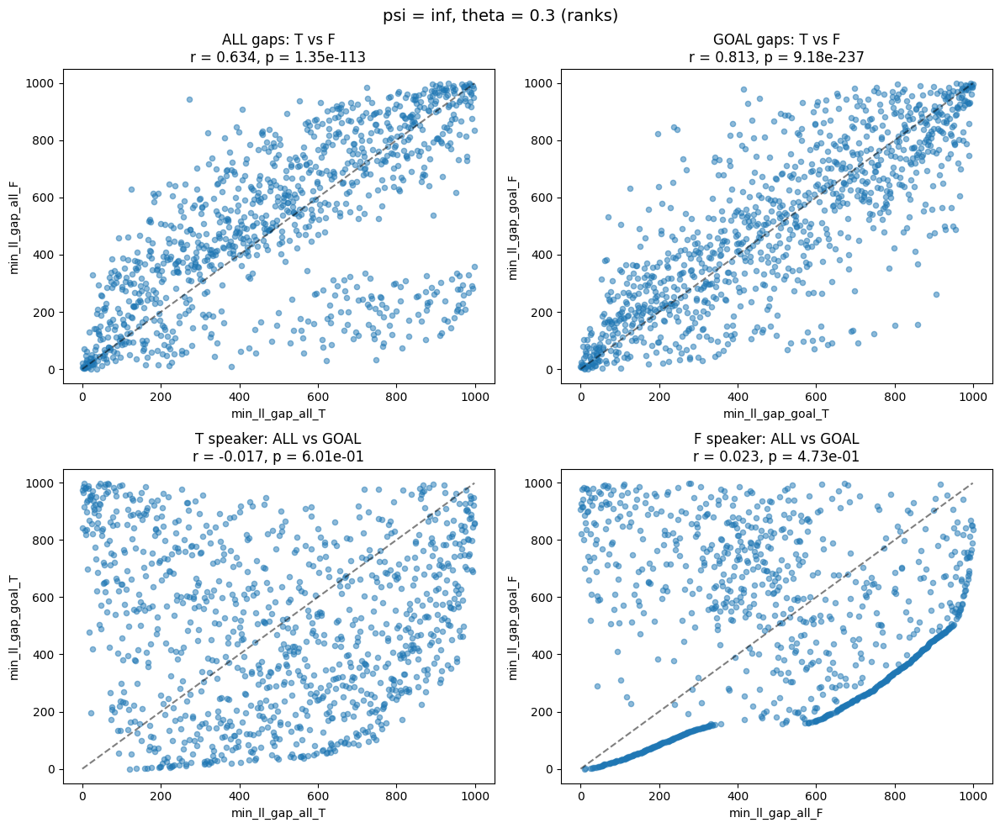

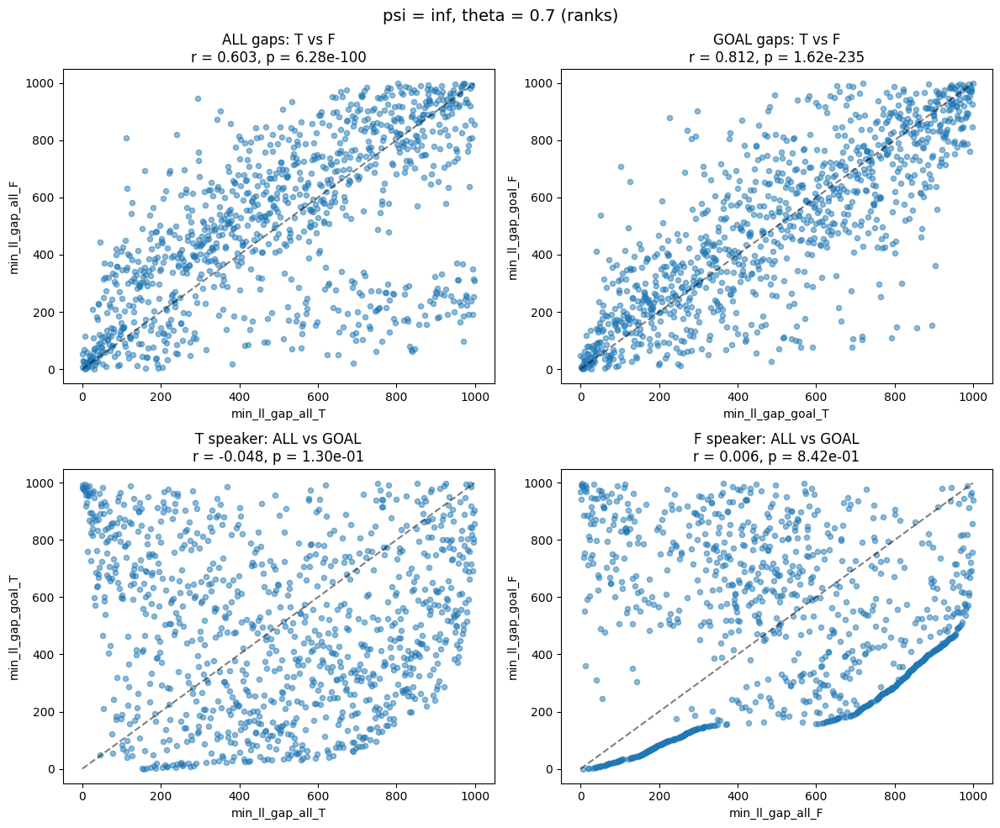

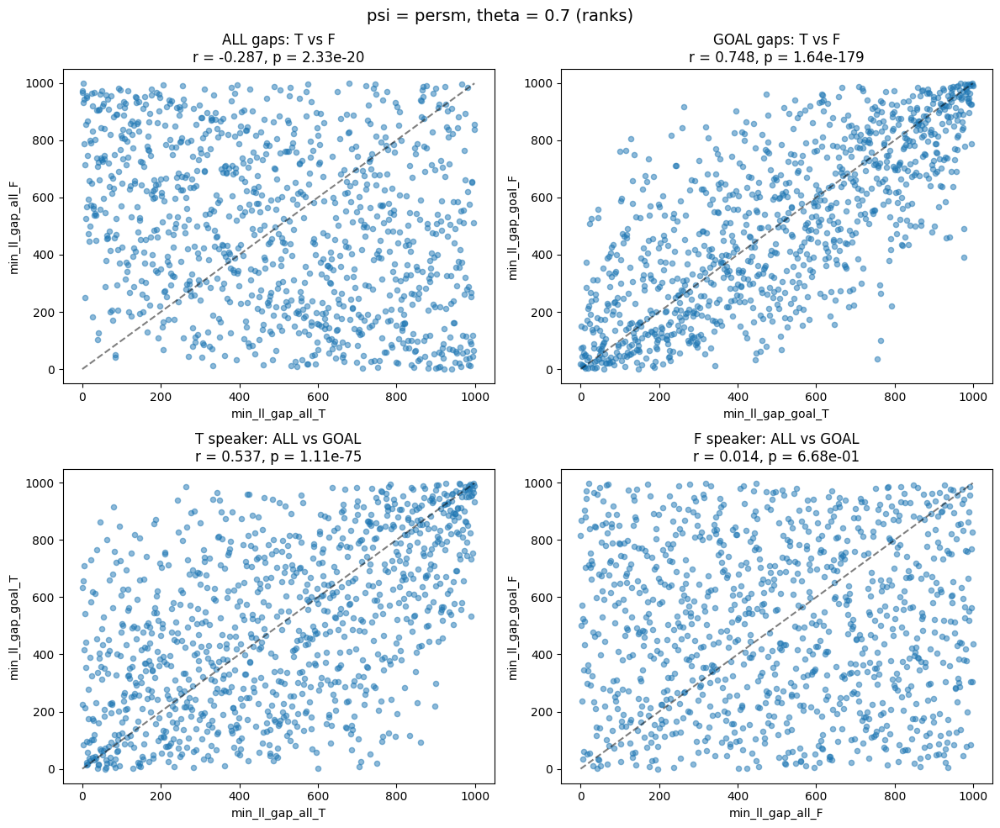

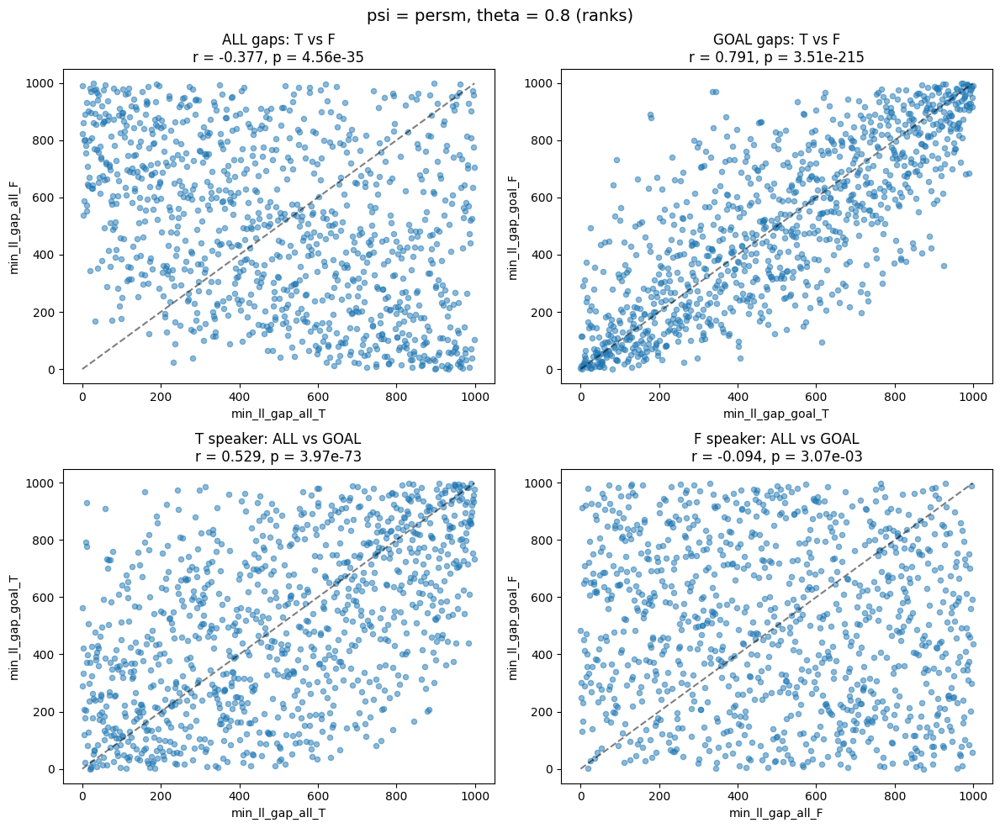

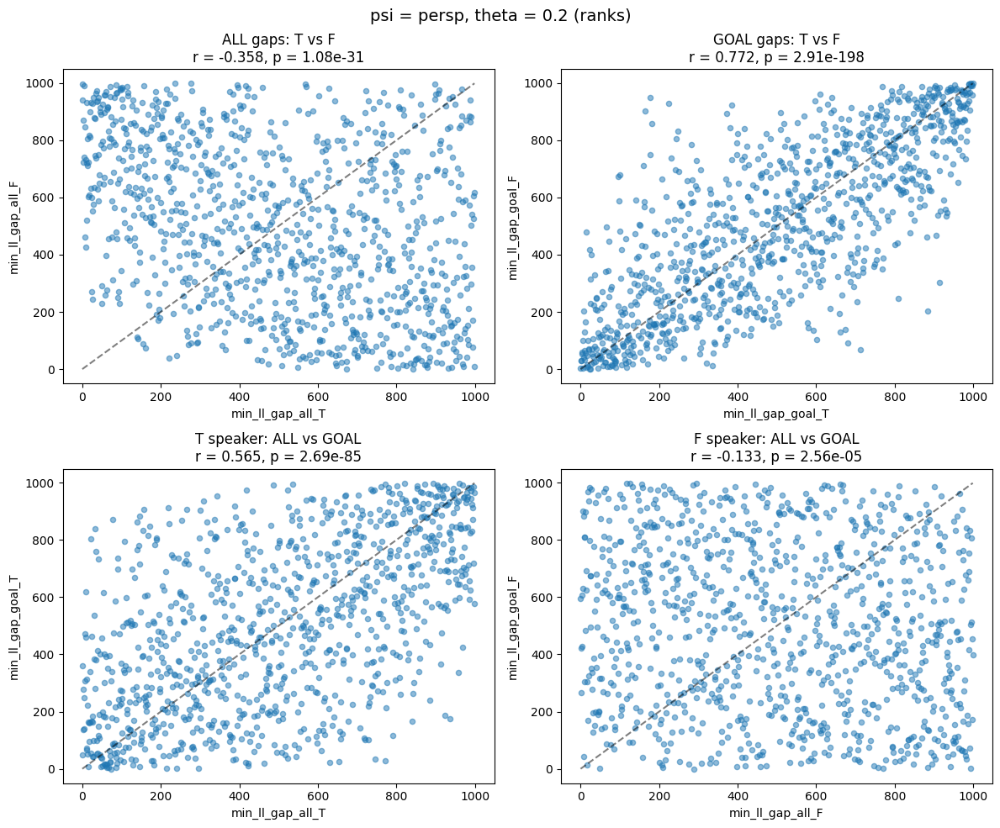

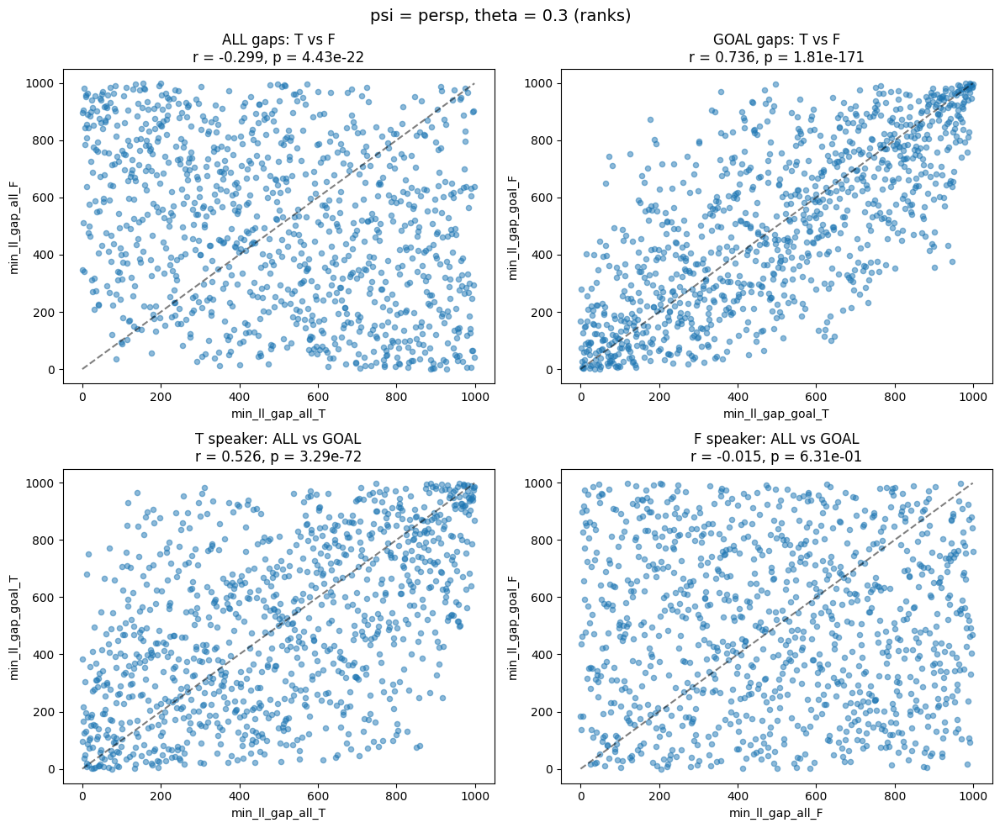

In [15]:
plot_value_comparisons_by_theta_psi(df_output, rank=True)

## Combined measures comparison

In [16]:
import numpy as np
import matplotlib.pyplot as plt
from scipy.stats import pearsonr, spearmanr, kendalltau
from scipy.stats import rankdata

def plot_ll_gap_scatter_by_theta_psi(
    df, measure1: str, measure2: str, rank: bool = False
):
    """
    Plot scatter plots for ll_gap measures grouped by theta and psi.
    """

    grouped = df.groupby(["theta", "psi"])

    for (theta, psi), group in grouped:
        fig, axes = plt.subplots(2, 2, figsize=(14, 12))
        axes = axes.flatten()

        plots = [
            (f"min_ll_gap_all_{measure1}", f"min_ll_gap_all_{measure2}", f"All: {measure1} vs {measure2}"),
            (f"min_ll_gap_goal_{measure1}", f"min_ll_gap_goal_{measure2}", f"Goal: {measure1} vs {measure2}"),
            (f"min_ll_gap_all_{measure1}", f"min_ll_gap_goal_{measure1}", f"{measure1}: All vs Goal"),
            (f"min_ll_gap_all_{measure2}", f"min_ll_gap_goal_{measure2}", f"{measure2}: All vs Goal"),
        ]

        for ax, (xcol, ycol, title) in zip(axes, plots):
            data = group[[xcol, ycol]].dropna()
            if data.empty:
                ax.set_title(f"{title} (no data)")
                continue

            x = data[xcol].values
            y = data[ycol].values

            if rank:
                x = rankdata(x)
                y = rankdata(y)

            ax.scatter(x, y, alpha=0.6)

            # Median lines
            ax.axvline(np.median(x), color='blue', linestyle='--', linewidth=1.5)
            ax.axhline(np.median(y), color='red', linestyle='--', linewidth=1.5)

            # y = x reference
            min_val = min(x.min(), y.min())
            max_val = max(x.max(), y.max())
            ax.plot([min_val, max_val], [min_val, max_val], linestyle=":", color="gray")

            # Correlation
            if len(x) > 1:
                if rank:
                    tau, p = kendalltau(x, y)
                    ax.text(0.05, 0.95, f"Kendall τ = {tau:.2f}\np = {p:.2g}",
                            transform=ax.transAxes, va="top", fontsize=9,
                            bbox=dict(facecolor='white', alpha=0.6))
                else:
                    r, p = pearsonr(x, y)
                    ax.text(0.05, 0.95, f"Pearson r = {r:.2f}\np = {p:.2g}",
                            transform=ax.transAxes, va="top", fontsize=9,
                            bbox=dict(facecolor='white', alpha=0.6))

            ax.set_title(title)
            ax.set_xlabel(xcol)
            ax.set_ylabel(ycol)

        fig.suptitle(f"psi = {psi}, theta = {theta}" + (" (ranks)" if rank else ""), fontsize=14)
        plt.tight_layout()
        plt.show()

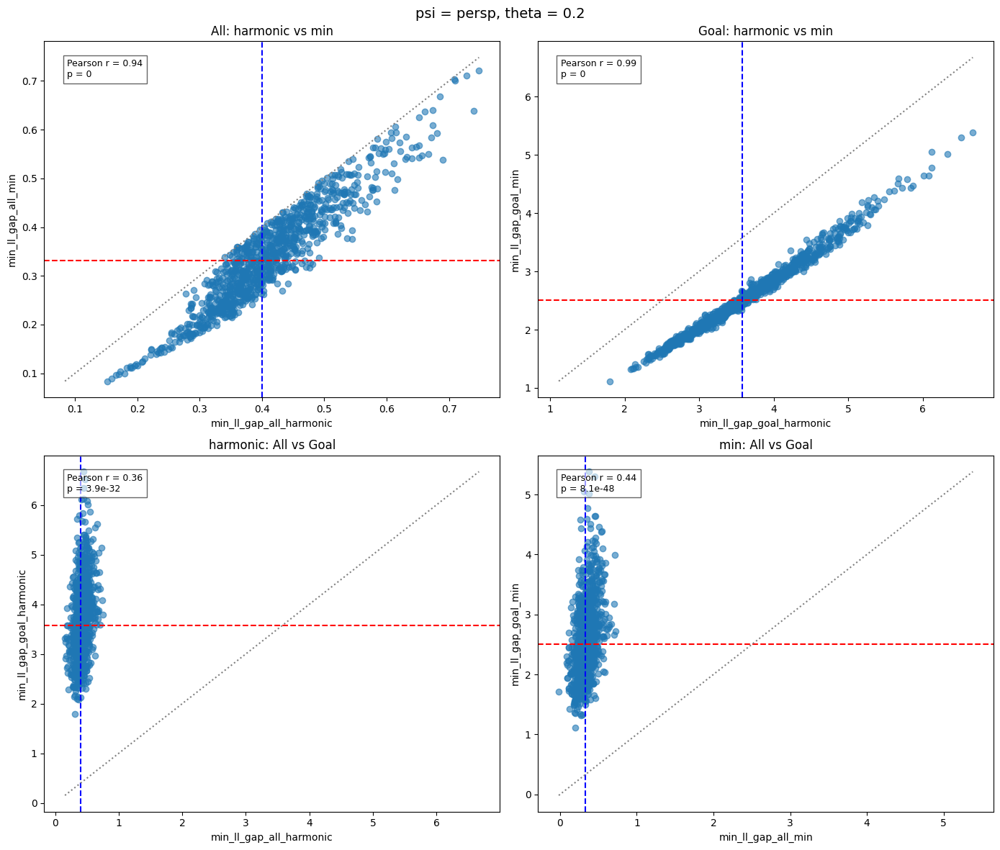

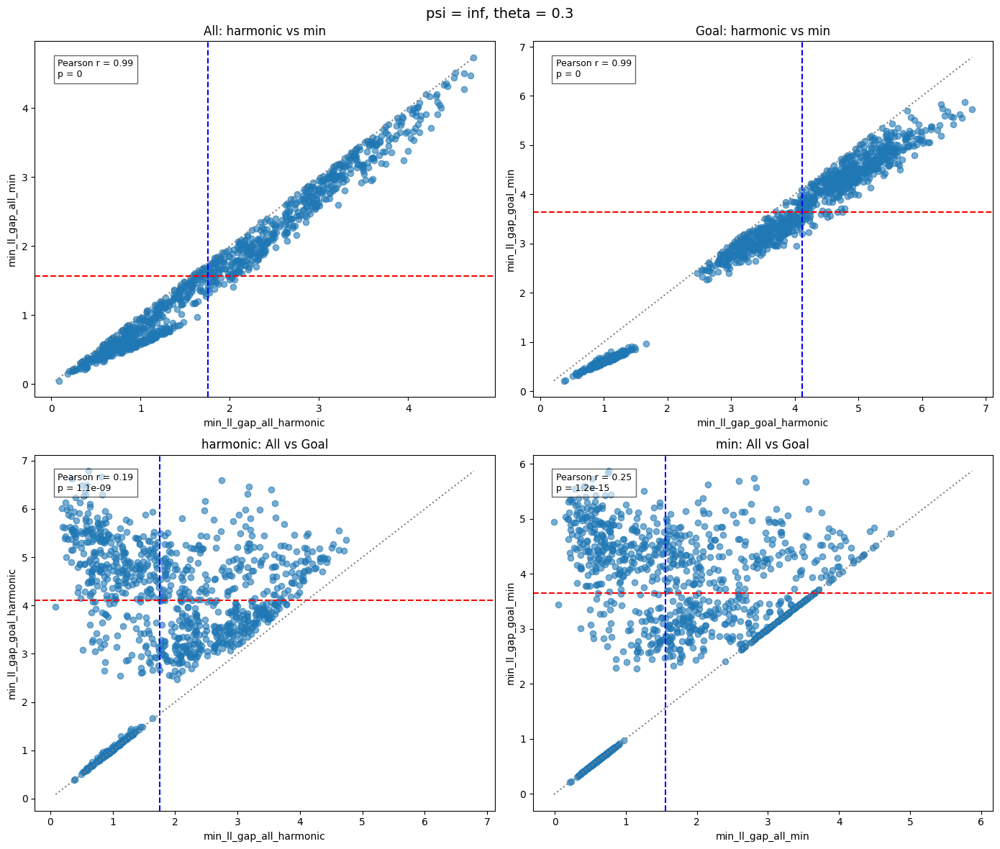

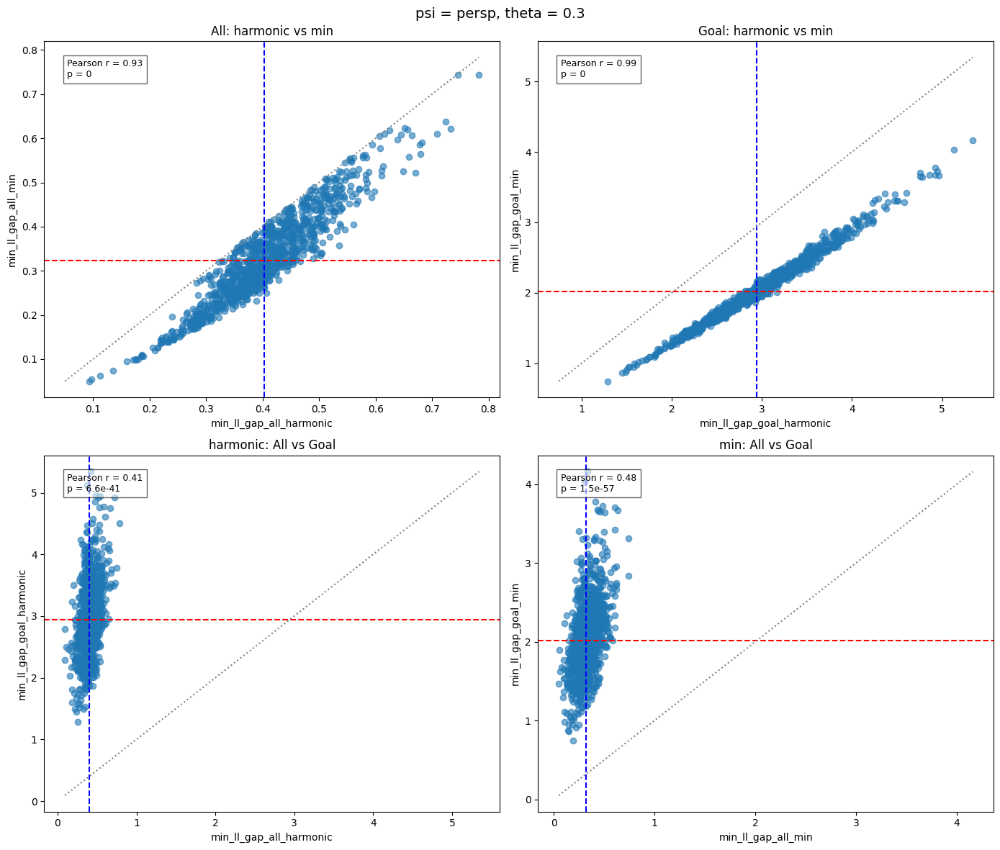

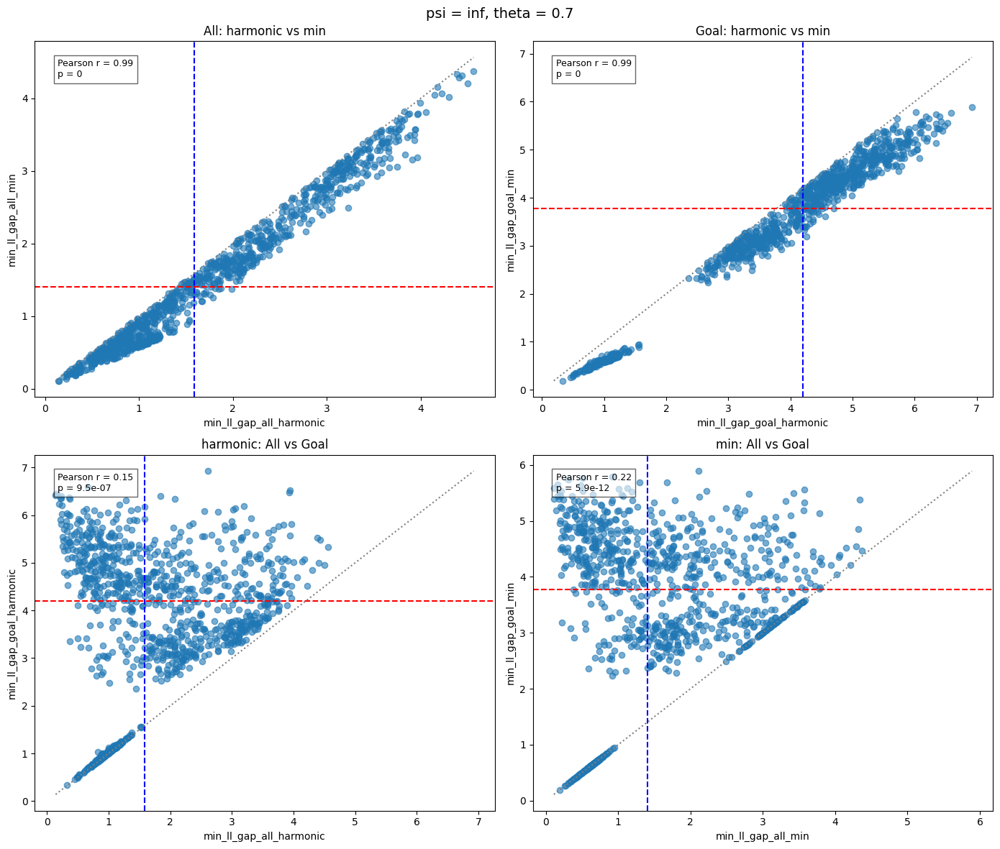

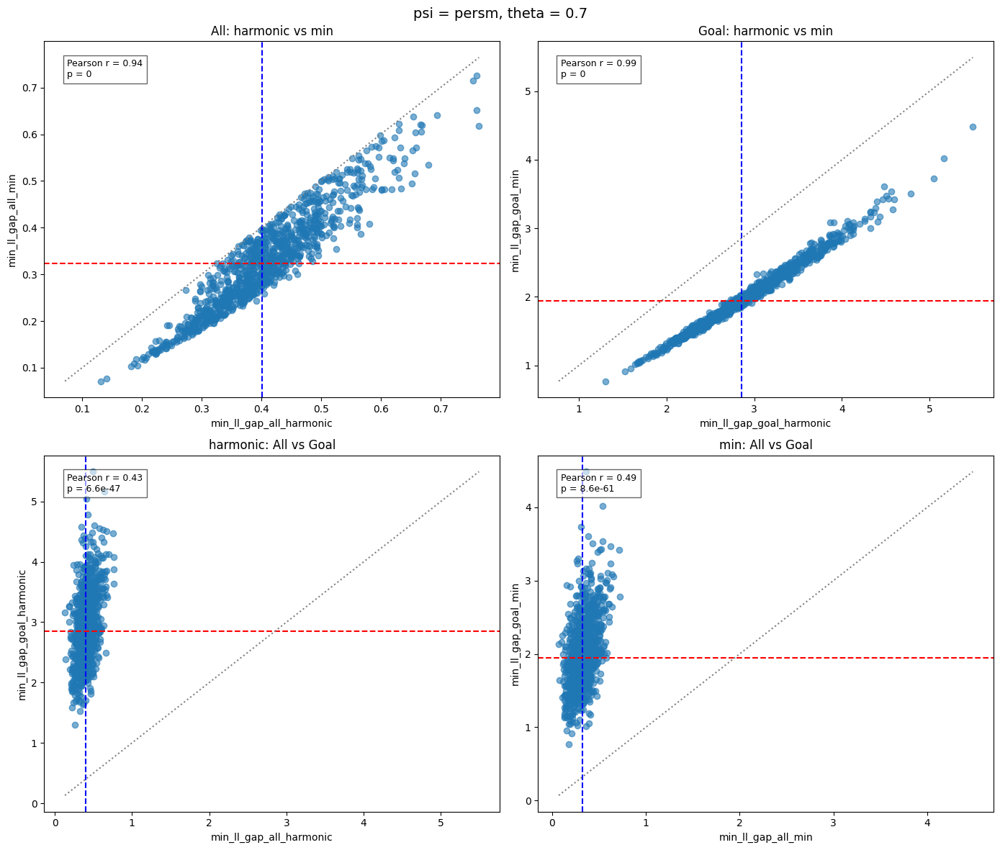

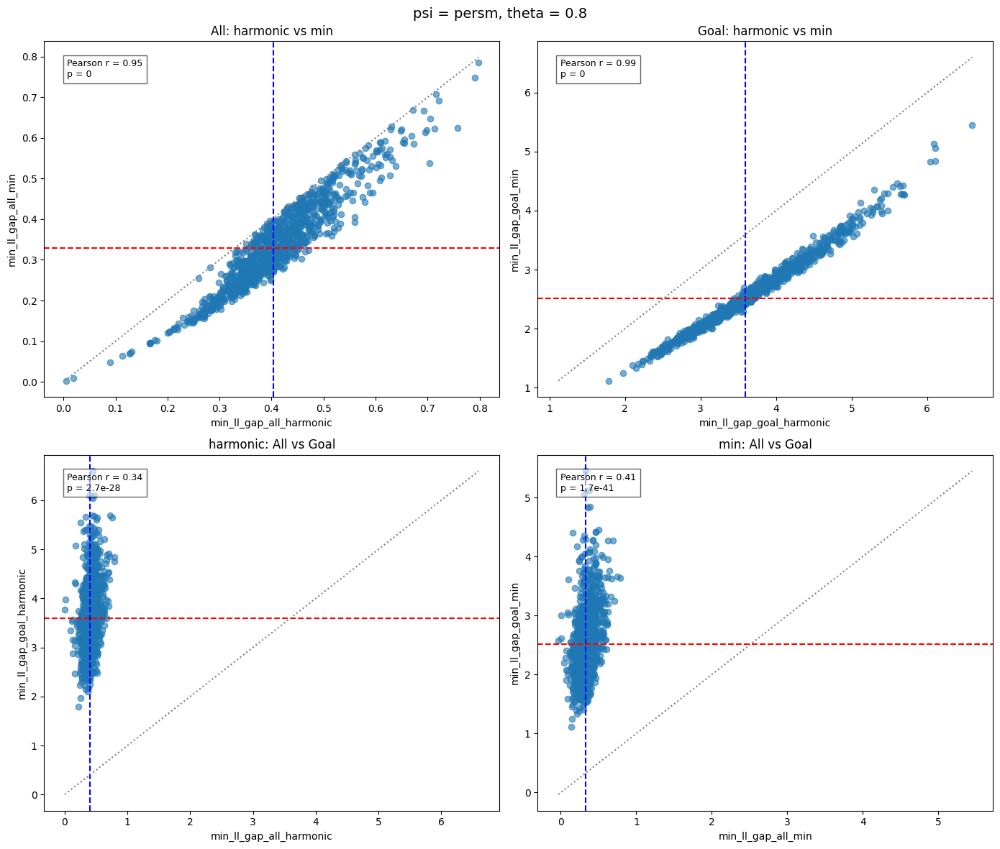

In [17]:
# Compare min vs harmonic methods
plot_ll_gap_scatter_by_theta_psi(df_output, "harmonic", "min", rank=False)

### Harmonic and mean

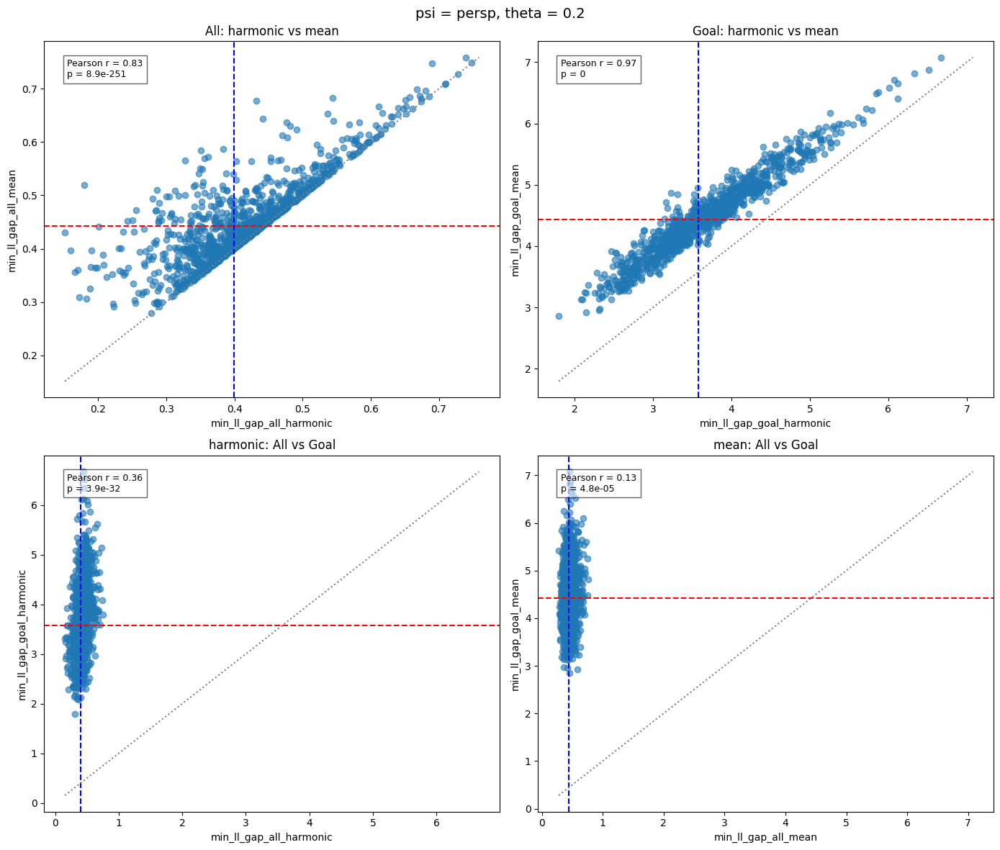

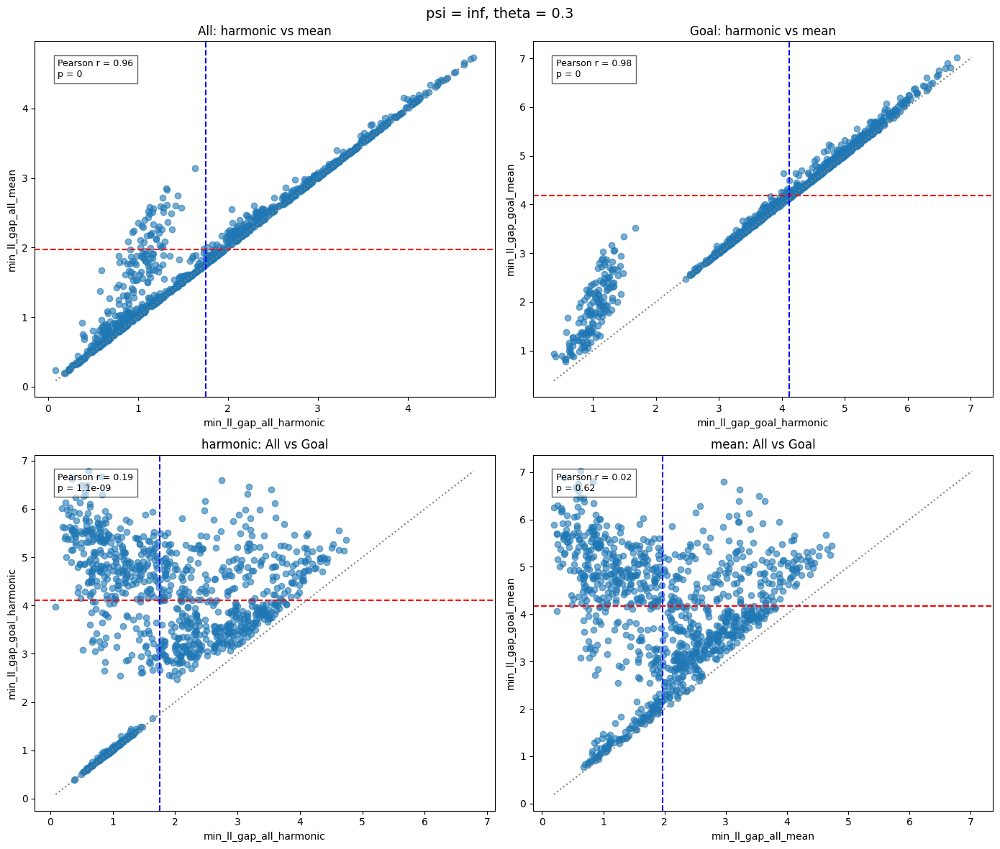

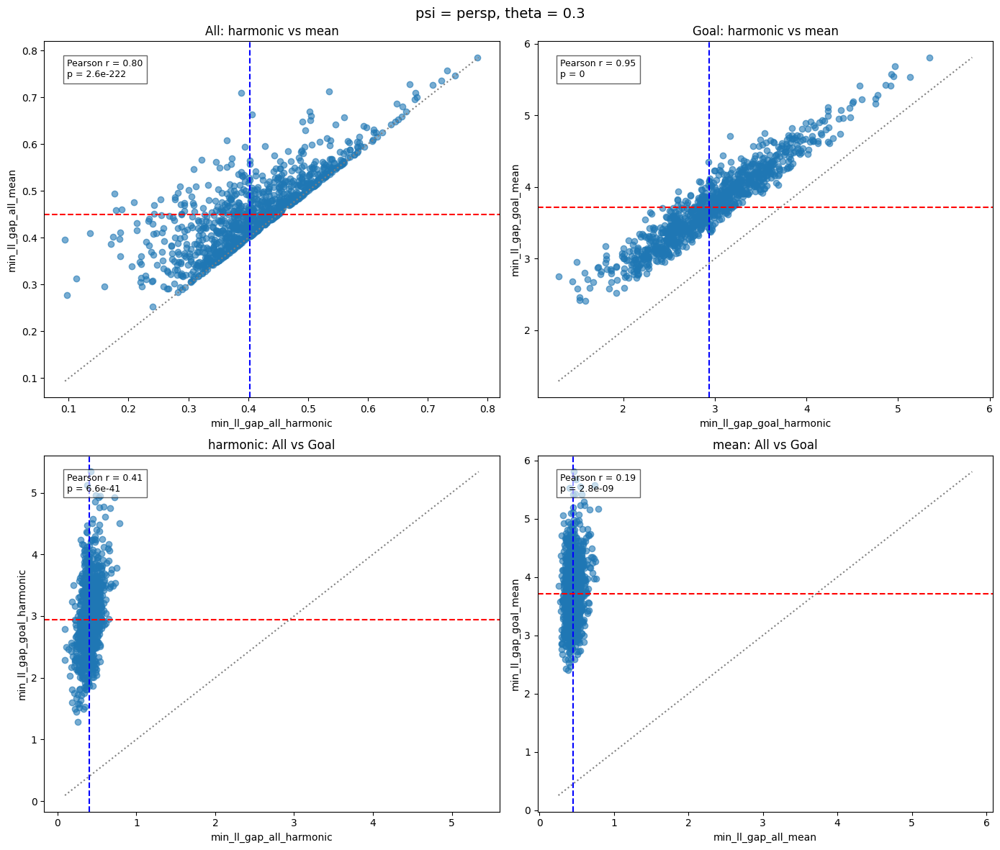

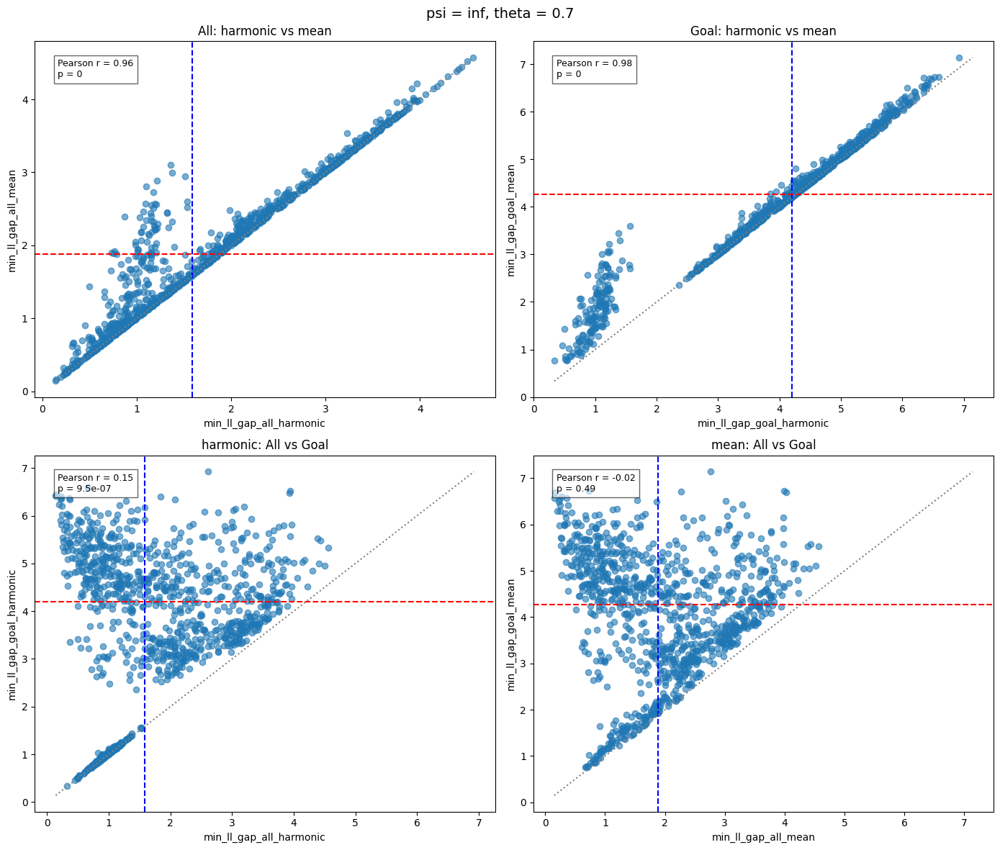

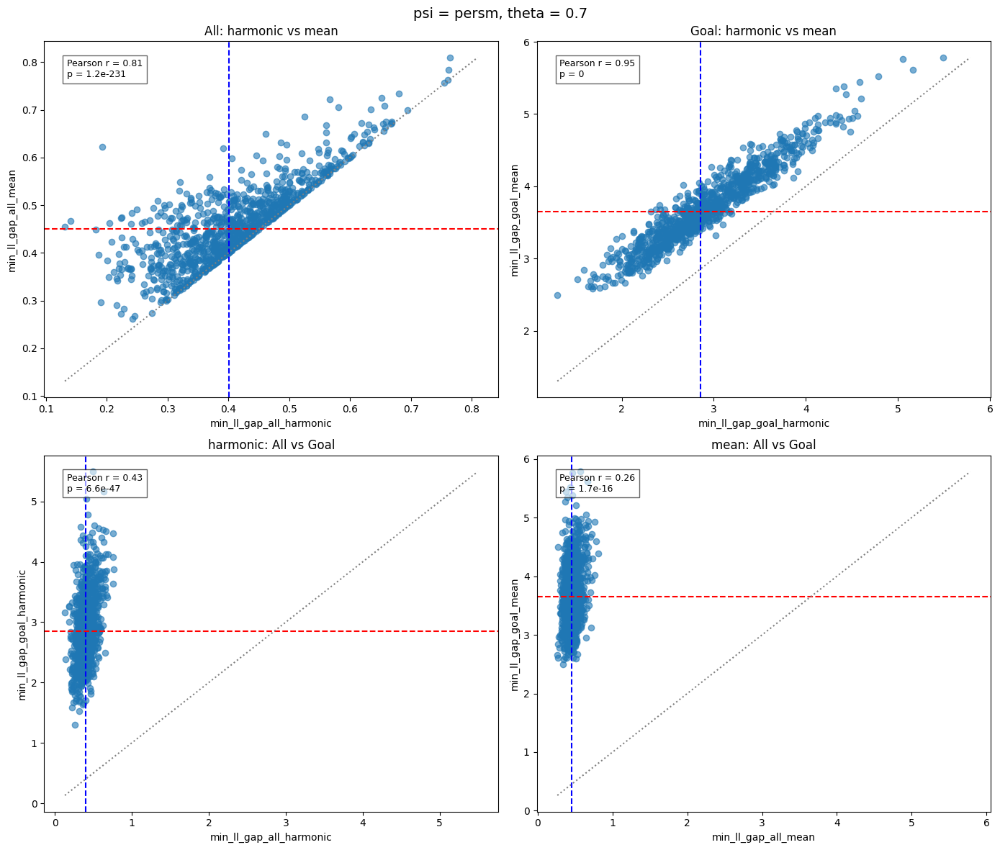

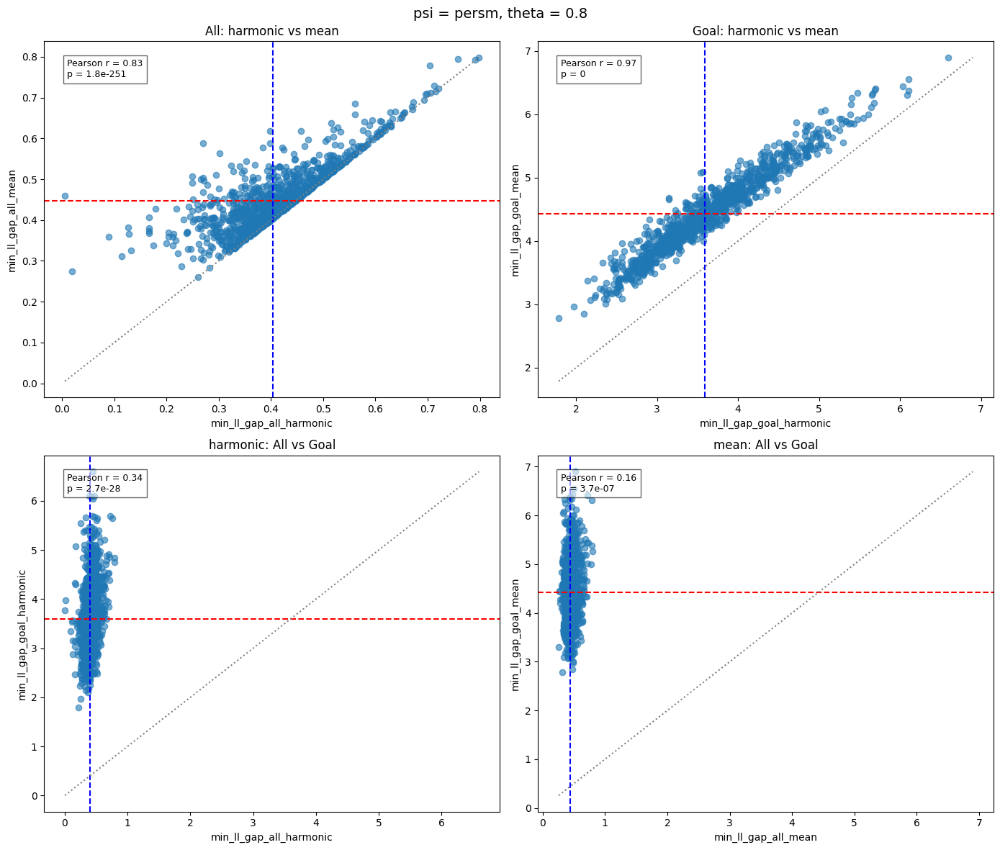

In [18]:
# Compare min vs harmonic methods
plot_ll_gap_scatter_by_theta_psi(df_output, "harmonic", "mean", rank=False)

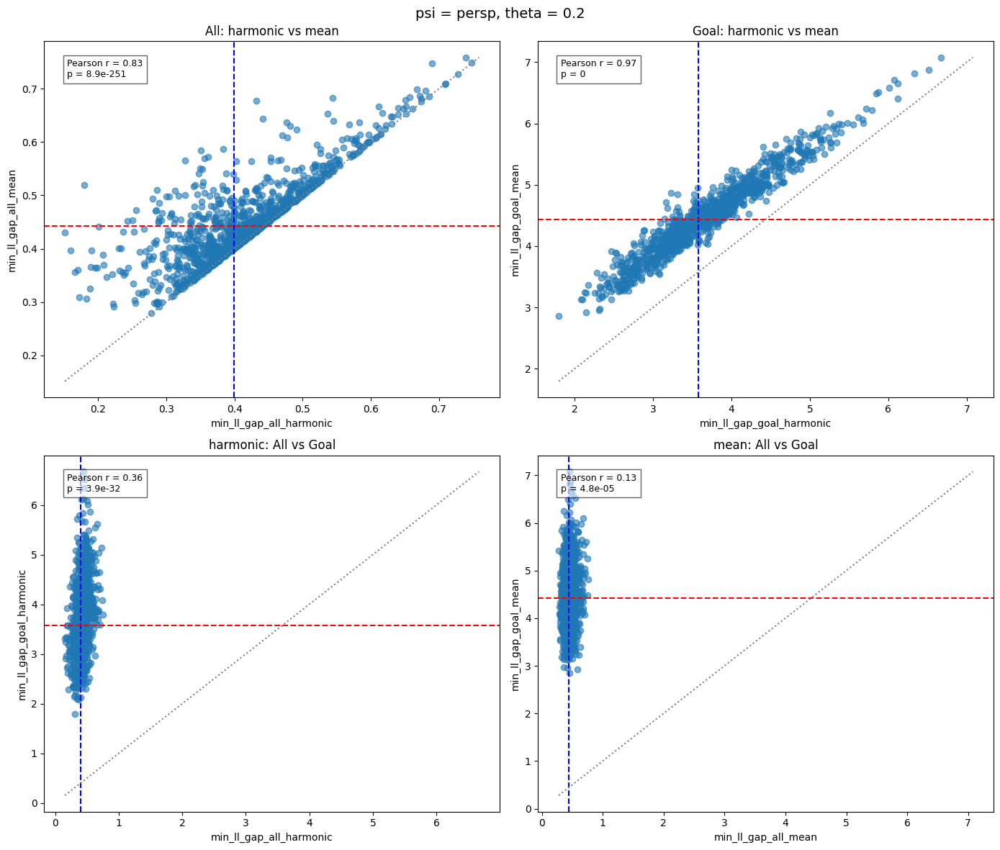

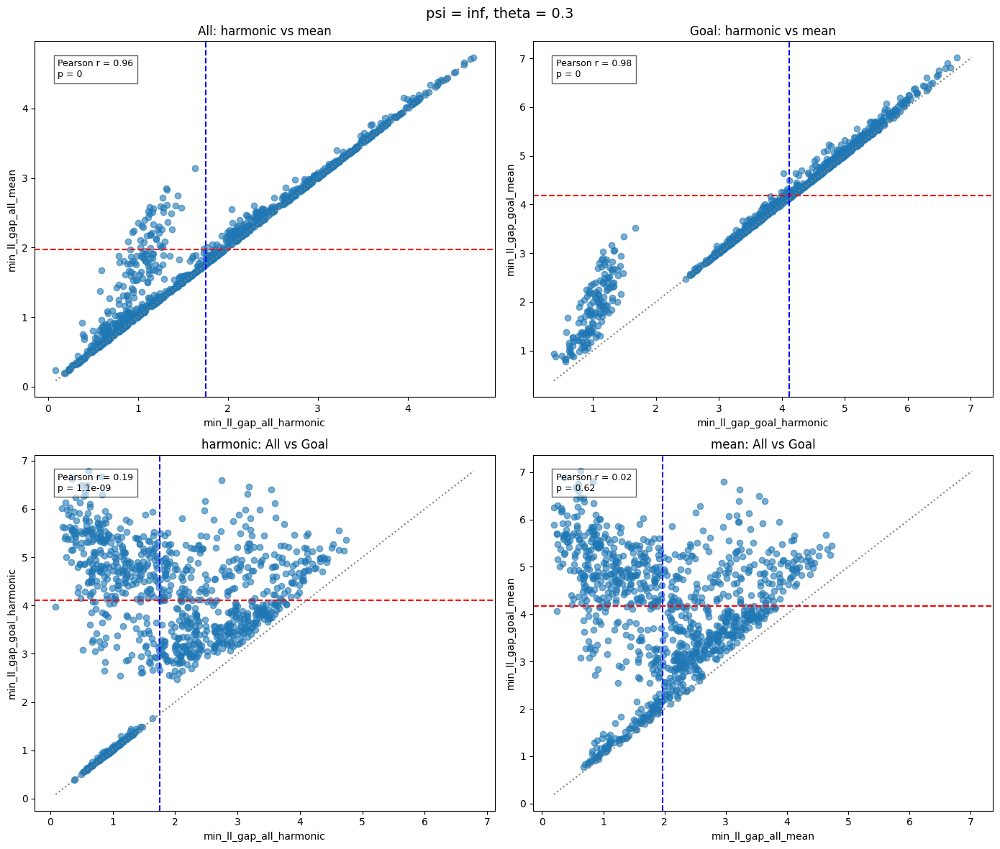

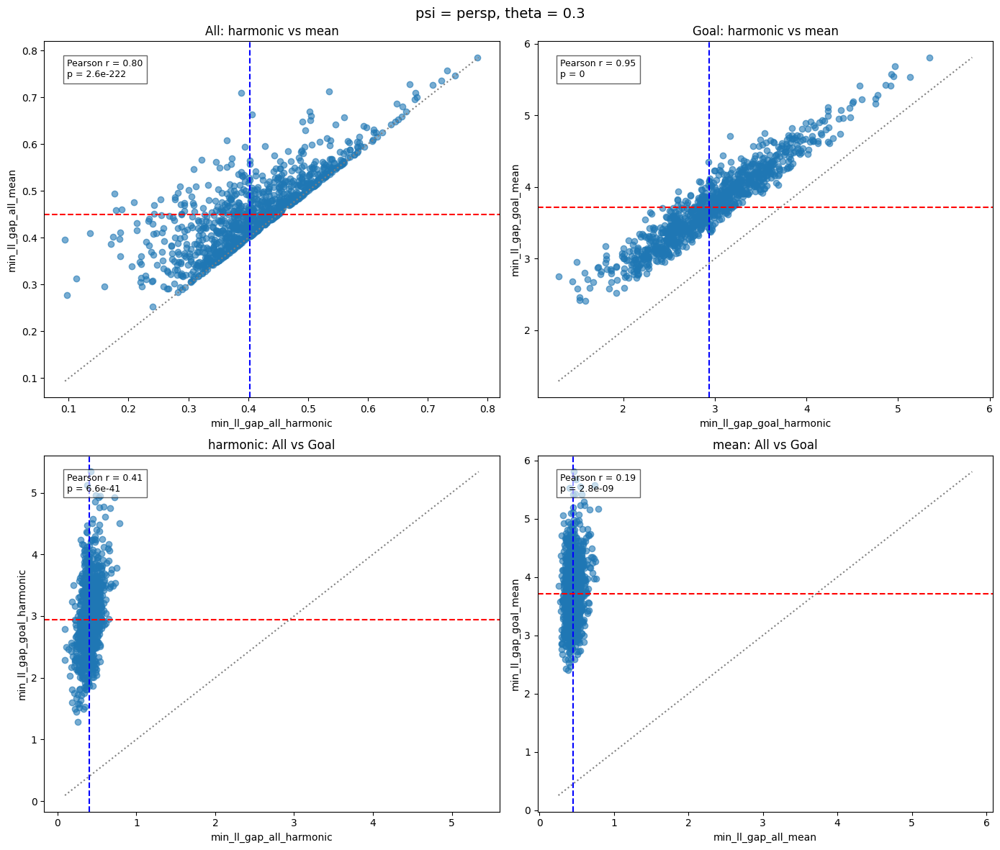

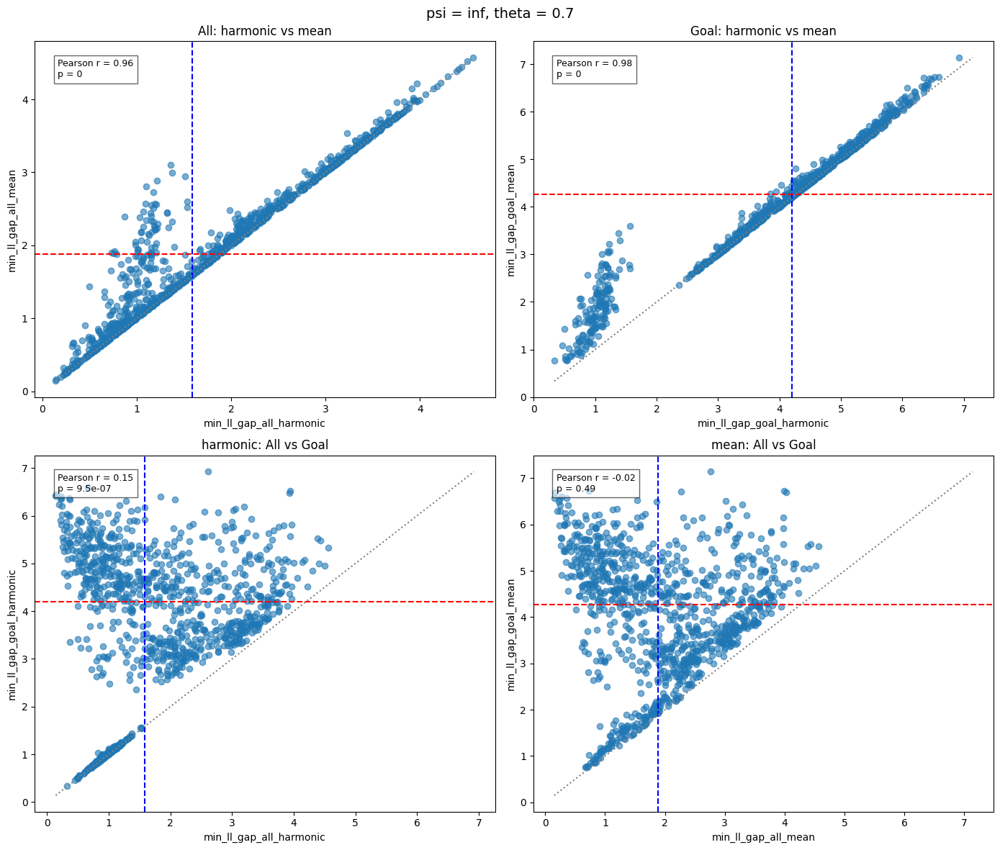

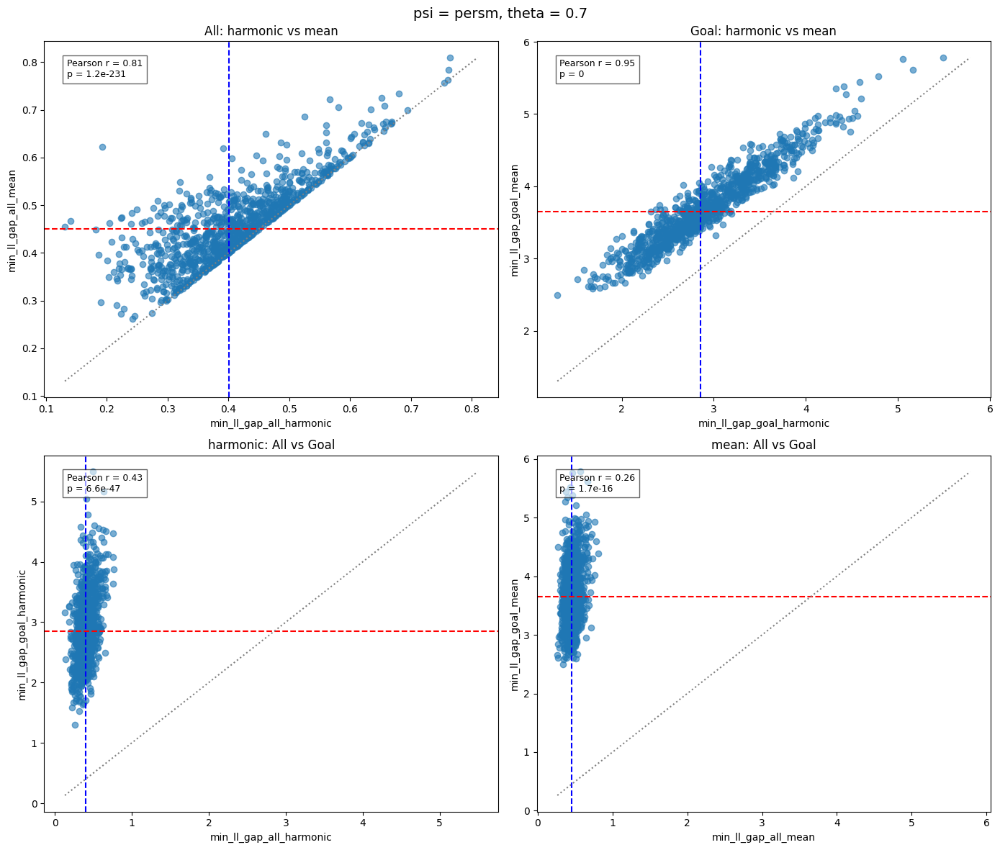

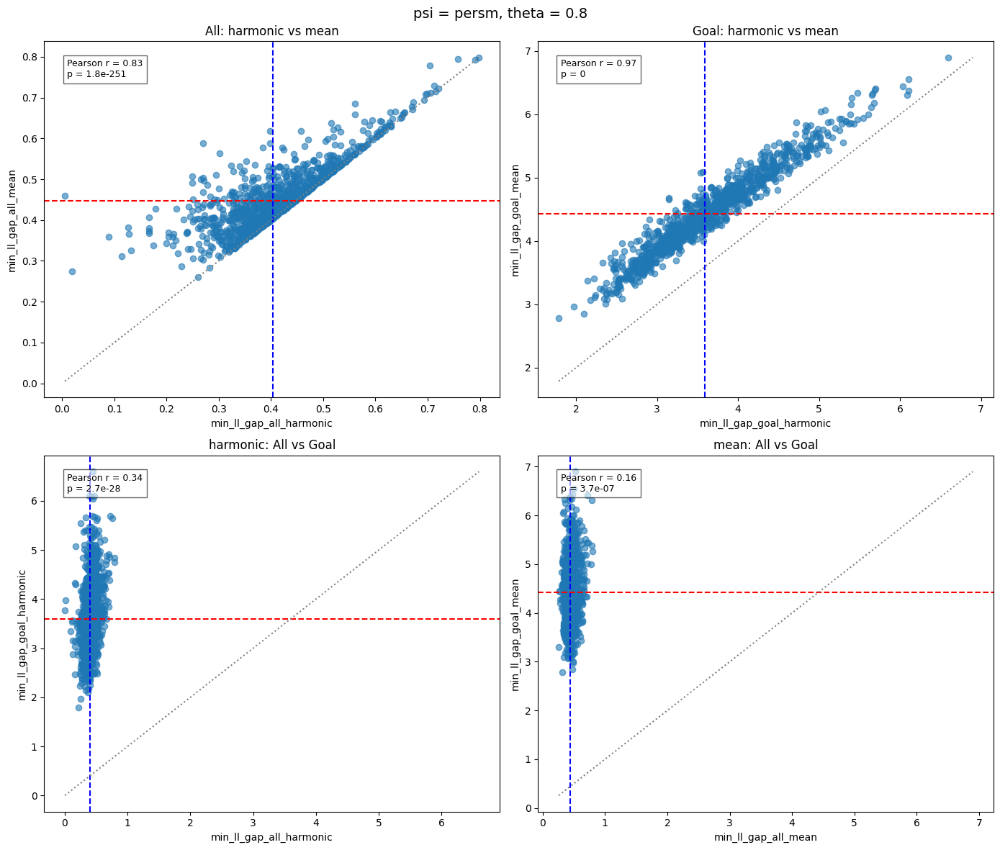

In [19]:
# Compare min vs harmonic methods
plot_ll_gap_scatter_by_theta_psi(df_output, "harmonic", "mean", rank=False)

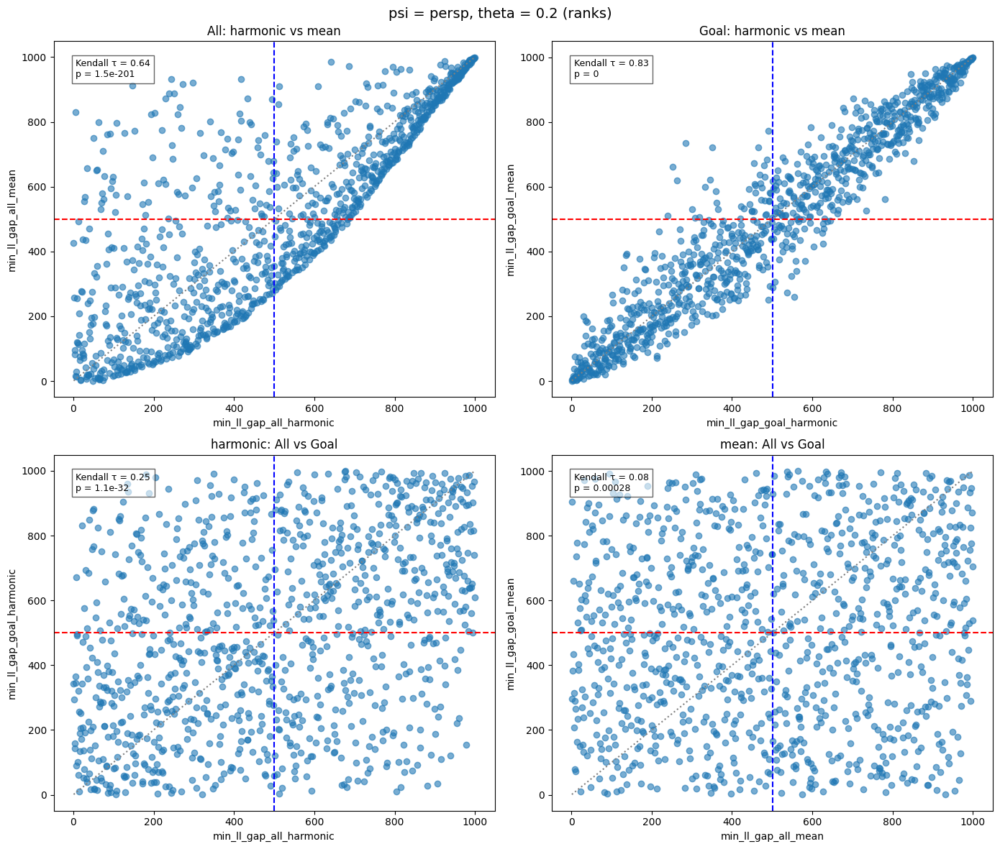

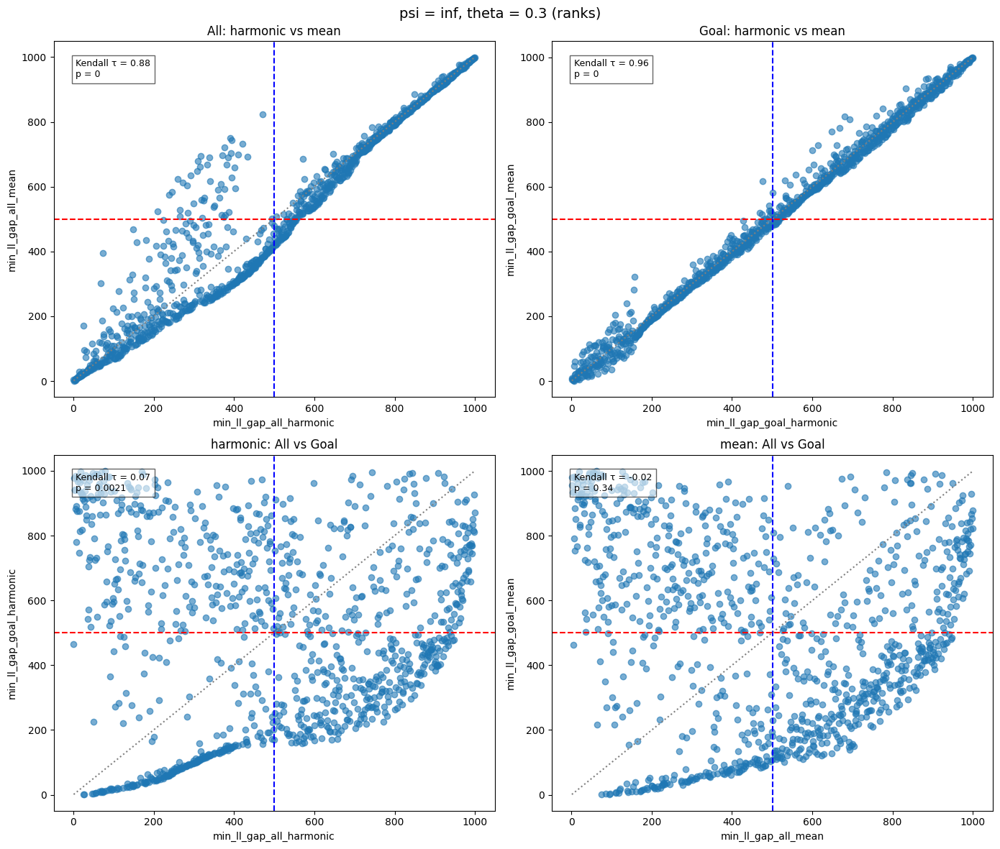

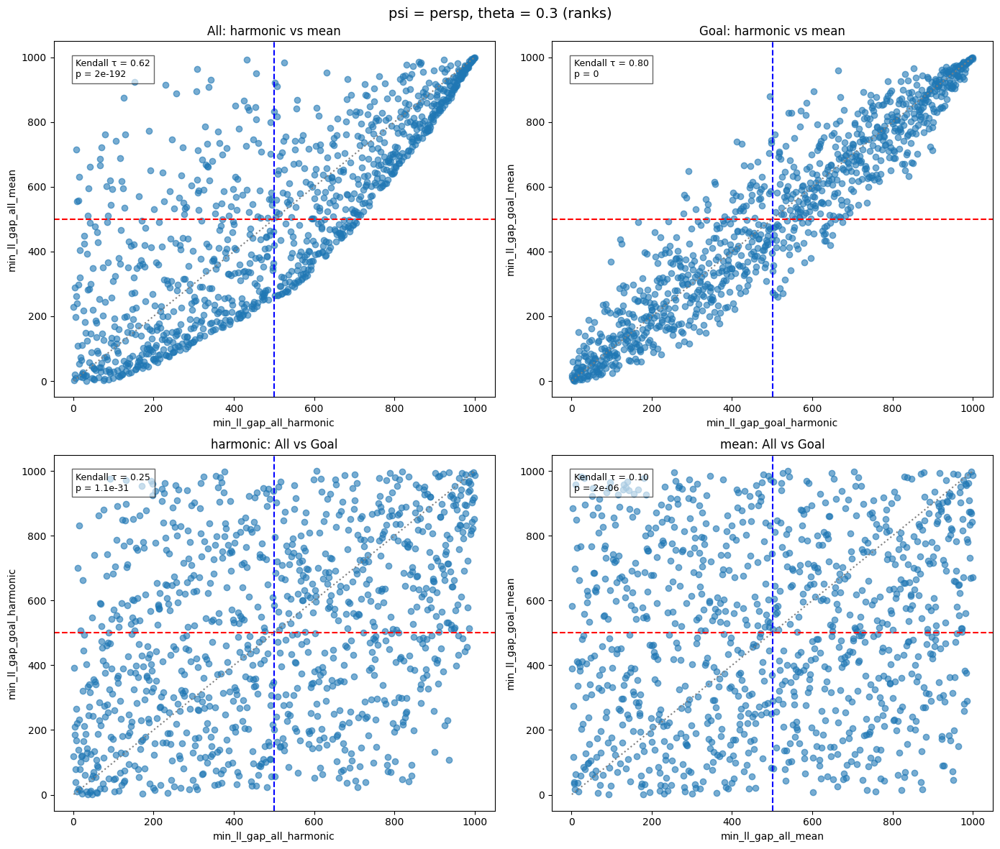

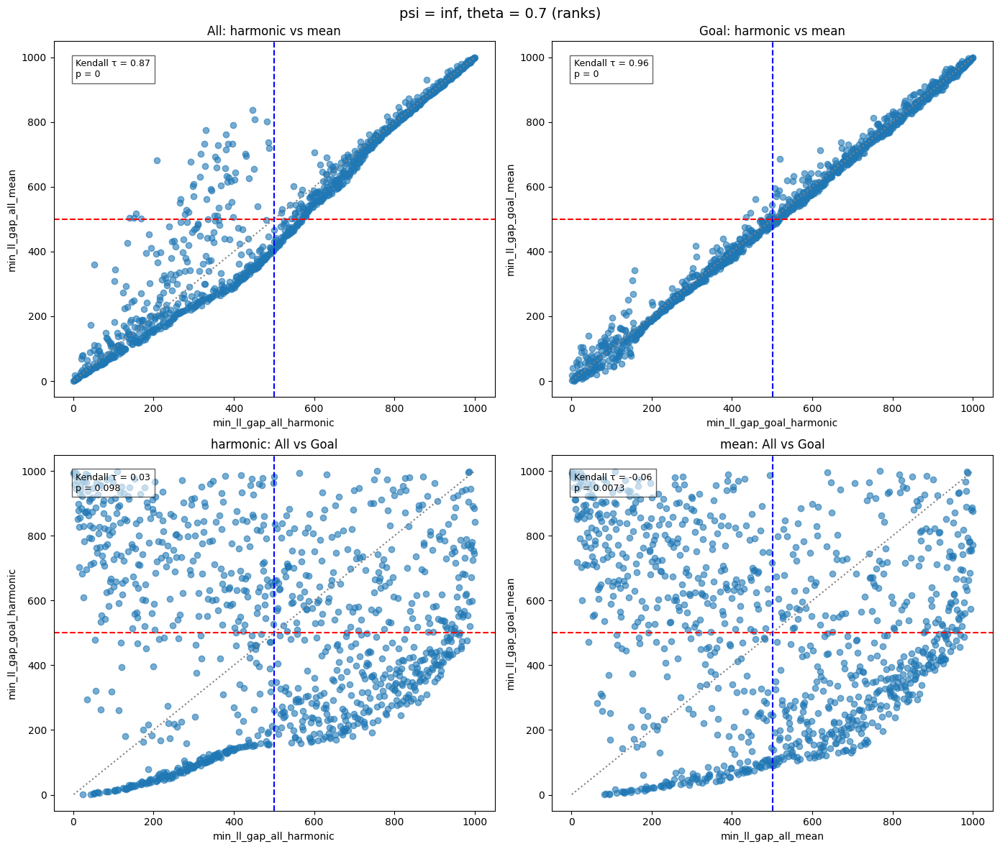

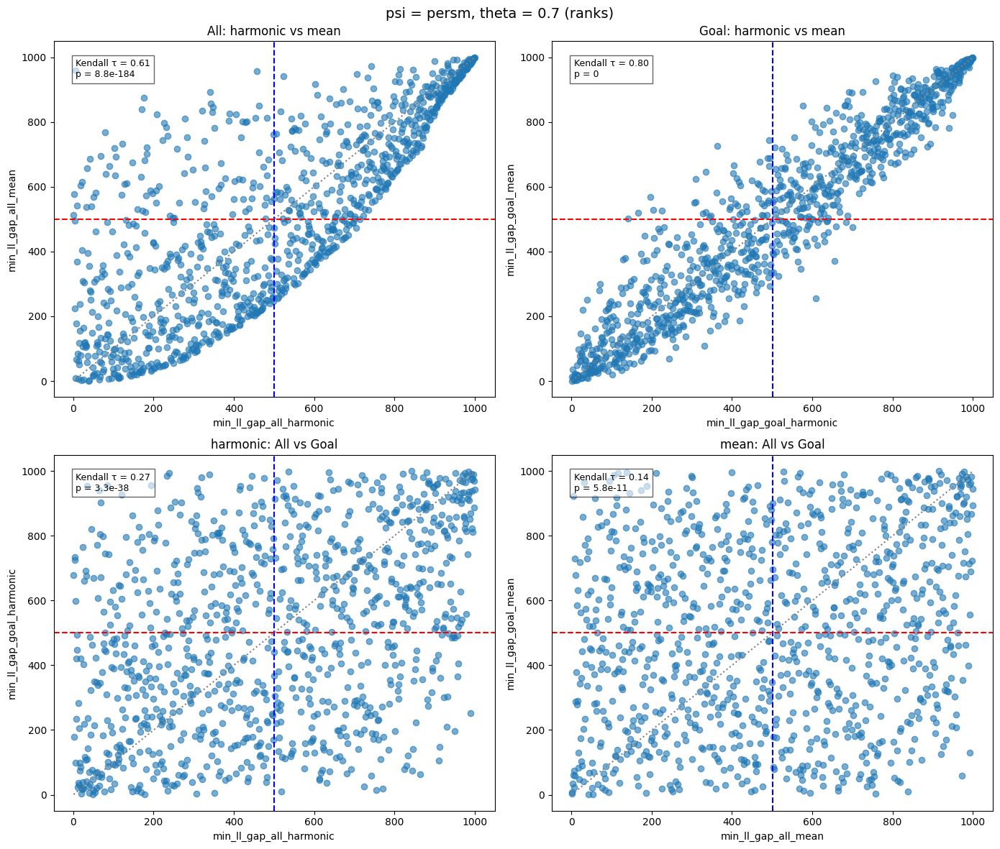

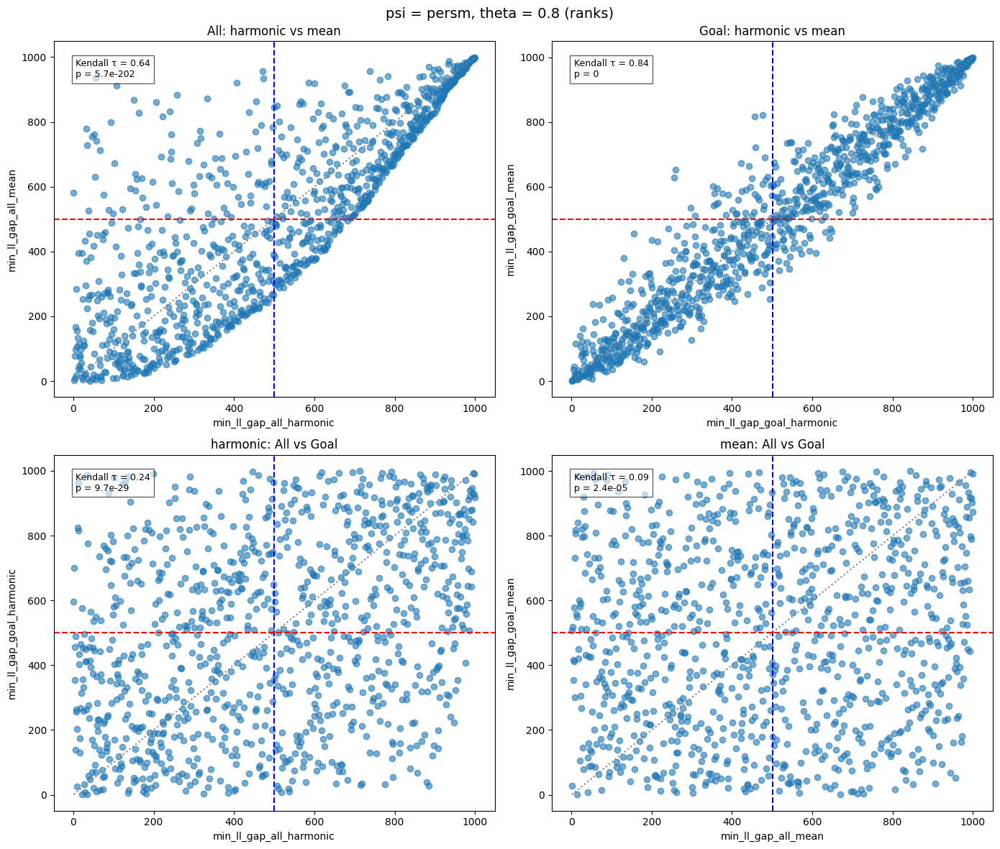

In [20]:
# Compare min vs harmonic methods
plot_ll_gap_scatter_by_theta_psi(df_output, "harmonic", "mean", rank=True)

### min and mean

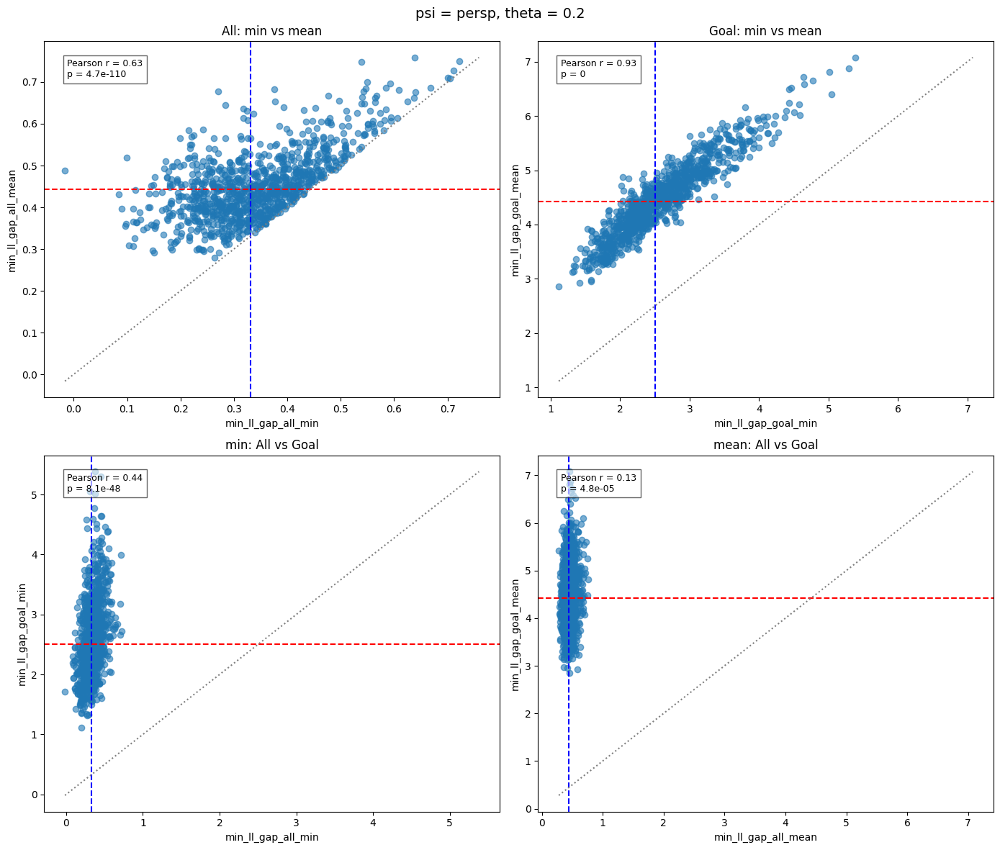

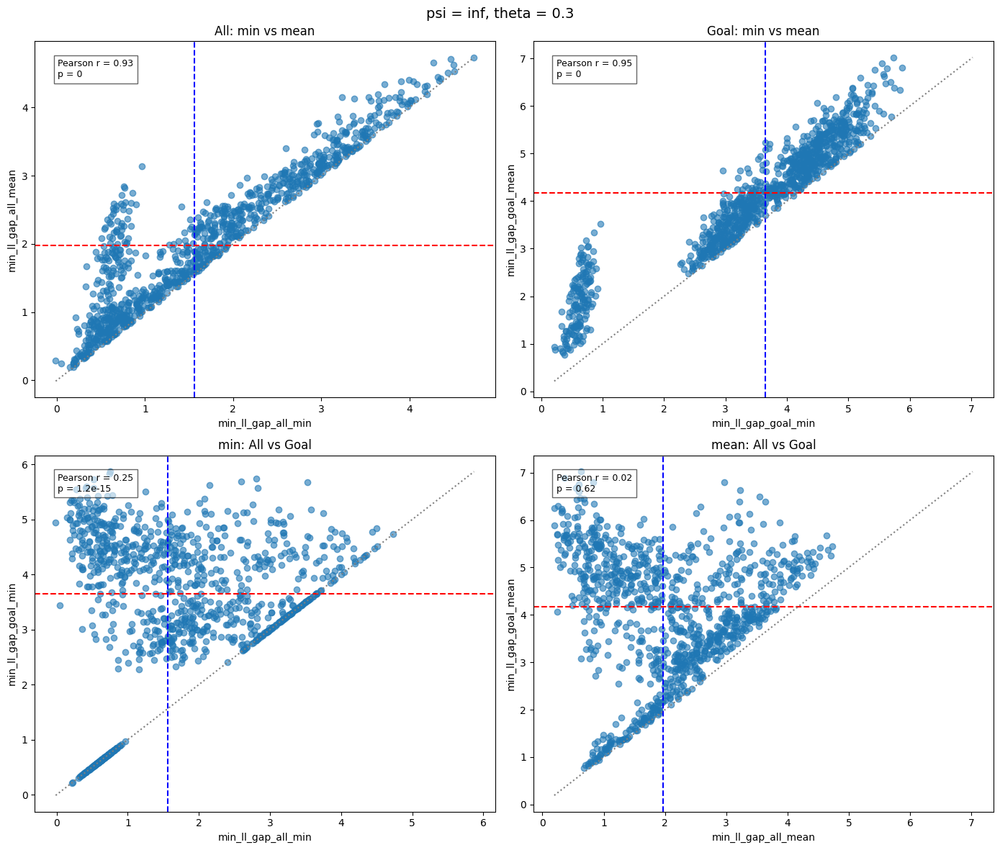

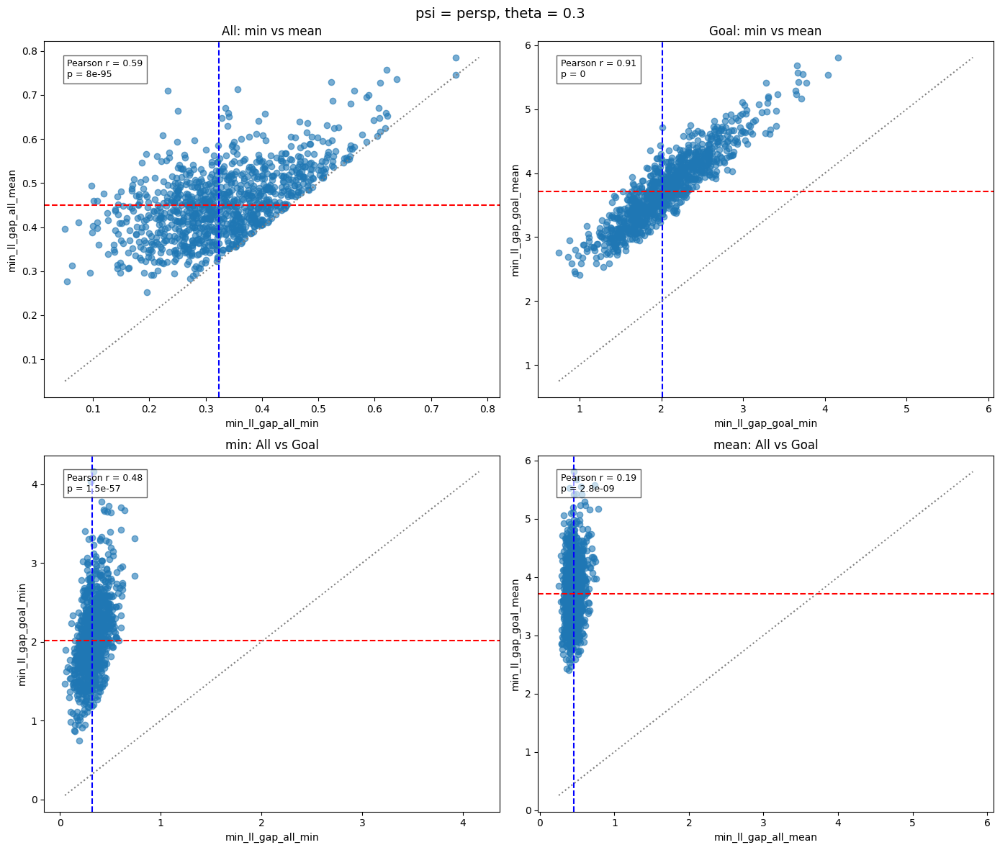

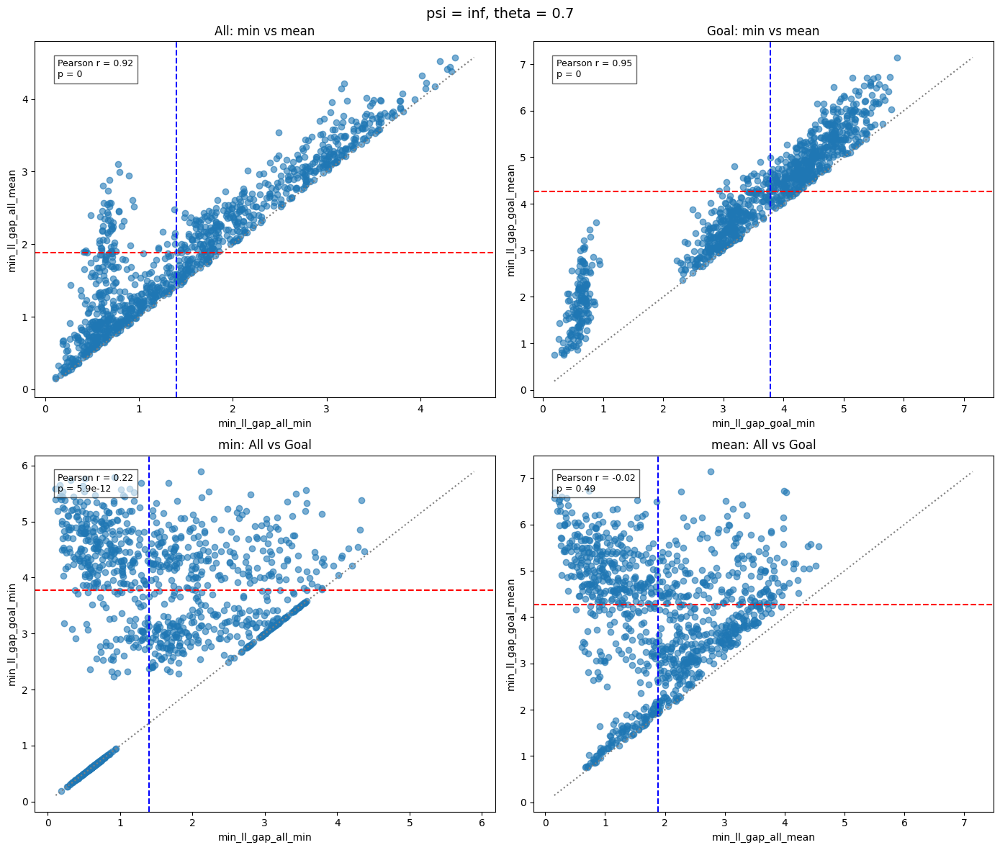

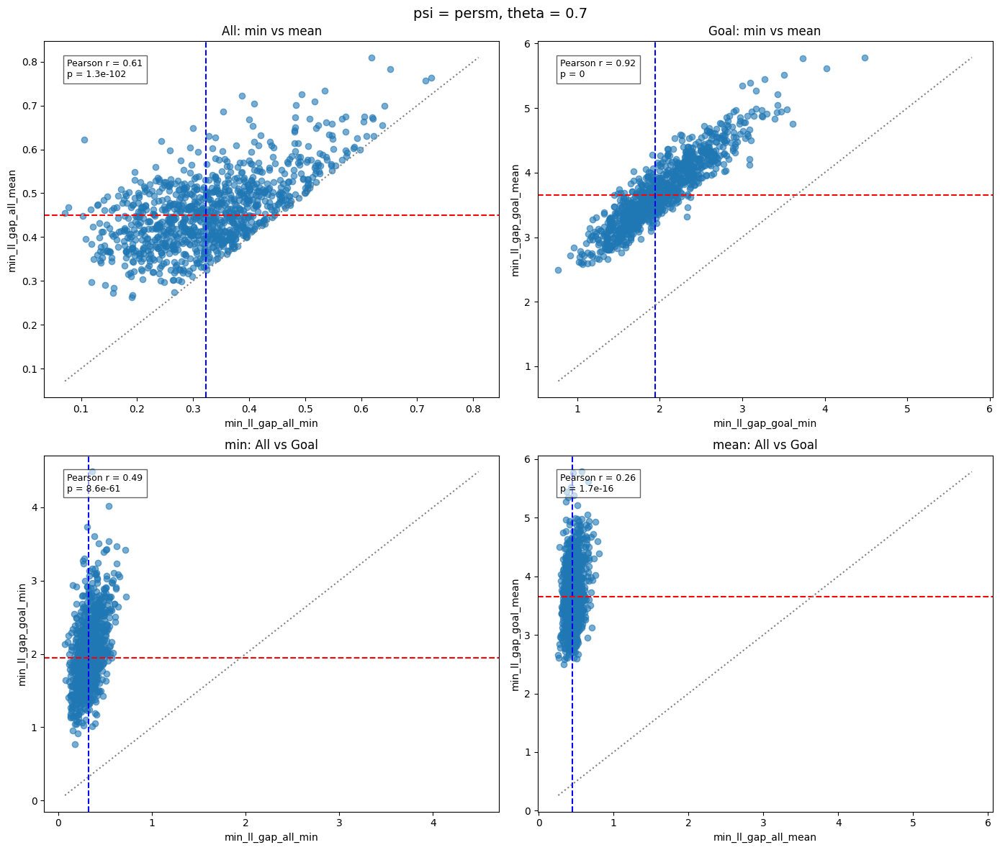

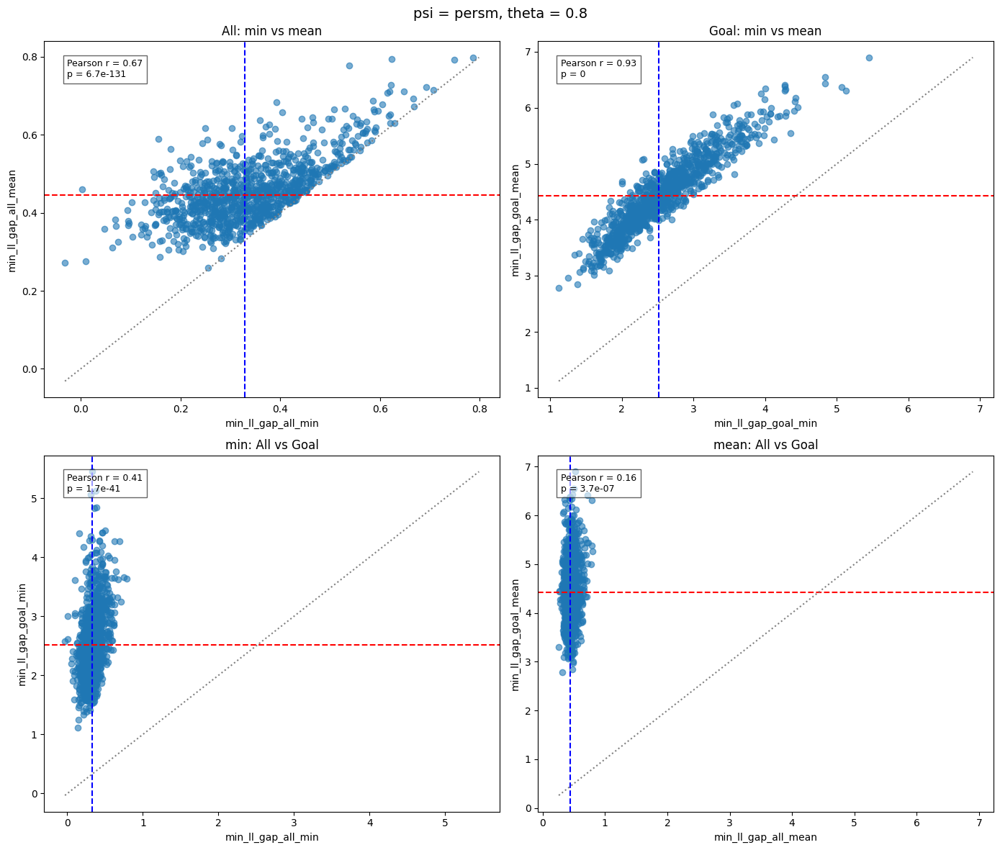

In [21]:
# Compare min vs harmonic methods
plot_ll_gap_scatter_by_theta_psi(df_output, "min", "mean", rank=False)

# Deciding observation sequences

In [14]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

from scipy.stats import (
    pearsonr,
    spearmanr,
    mannwhitneyu,
    kruskal
)


def analyze_ll_gap_by_theta(
    df,
    psi,
    scope="goal",          # "all" or "goal"
    method="harmonic",     # "min", "mean", "harmonic"
    top_p_ll=1,            # top X% by LL gap
    top_n_obs=2,           # top N obs_log_lik per theta
    show_plots=True,
    run_tests=True
):
    """
    Full analysis pipeline:
      1. Global plots + tests (per psi)
      2. Per-theta plots + tests
      3. Collect top-N obs per theta from top-P% LL gap

    Returns:
      DataFrame with top-N obs per theta
    """

    assert scope in {"all", "goal"}
    assert method in {"min", "mean", "harmonic"}

    ll_col = f"min_ll_gap_{scope}_{method}"

    df_psi = df[df["psi"] == psi]

    if df_psi.empty:
        raise ValueError(f"No data for psi = {psi}")

    collected_rows = []

    # ============================================================
    # GLOBAL OVERVIEW (per psi)
    # ============================================================
    print(f"\n=== GLOBAL ANALYSIS: psi = {psi} ===")

    if show_plots:
        plt.figure(figsize=(10, 6))
        sns.histplot(
            data=df_psi,
            x="obs_log_lik",
            hue="theta",
            element="step",
            stat="density",
            common_norm=False,
            bins=50
        )
        plt.title(f'Distribution of obs_log_lik (psi = "{psi}")')
        plt.xlabel("obs_log_lik")
        plt.ylabel("Density")
        plt.show()

    # Kruskal-Wallis
    if run_tests:
        groups = [
            g["obs_log_lik"].values
            for _, g in df_psi.groupby("theta")
            if len(g) > 1
        ]
        if len(groups) >= 2:
            stat, p_kw = kruskal(*groups)
            print(f"Kruskal–Wallis H = {stat:.2f}, p = {p_kw:.3g}")

    if show_plots:
        plt.figure(figsize=(8, 6))
        palette = sns.color_palette("tab10", n_colors=df_psi["theta"].nunique())

        sns.scatterplot(
            data=df_psi,
            x="obs_log_lik",
            y=ll_col,
            hue="theta",
            palette=palette,
            alpha=0.6
        )

        for i, (_, g) in enumerate(df_psi.groupby("theta")):
            plt.axvline(g["obs_log_lik"].median(), color=palette[i], linestyle="--", linewidth=1.5)
            plt.axhline(g[ll_col].median(), color=palette[i], linestyle=":", linewidth=1.5)

        plt.title(f'obs_log_lik vs {ll_col} (psi = "{psi}")')
        plt.xlabel("obs_log_lik")
        plt.ylabel(ll_col)
        plt.legend(title="theta")
        plt.show()

    # Correlations per theta
    if run_tests:
        for theta_val, g in df_psi.groupby("theta"):
            if len(g) < 2:
                continue

            r, p_r = pearsonr(g["obs_log_lik"], g[ll_col])
            rho, p_rho = spearmanr(g["obs_log_lik"], g[ll_col])

            print(f"Theta = {theta_val}")
            print(f"  Pearson r = {r:.2f}, p = {p_r:.3g}")
            print(f"  Spearman rho = {rho:.2f}, p = {p_rho:.3g}")

    # ============================================================
    # PER-THETA ANALYSIS
    # ============================================================
    for theta_val, df_theta in df_psi.groupby("theta"):
        print(f"\n=== Theta = {theta_val} ===")

        threshold = df_theta[ll_col].quantile(1 - top_p_ll / 100)
        top = df_theta[df_theta[ll_col] >= threshold]
        rest = df_theta[df_theta[ll_col] < threshold]

        print(f"Top {top_p_ll}% threshold ({ll_col}) = {threshold:.3f}")
        print(f"Top: {len(top)}, Rest: {len(rest)}")

        if top.empty:
            continue

        if show_plots:
            plt.figure(figsize=(8, 5))
            sns.histplot(rest["obs_log_lik"], bins=30, stat="density", alpha=0.5, label="Rest")
            sns.histplot(top["obs_log_lik"], bins=30, stat="density", alpha=0.5, label=f"Top {top_p_ll}%")
            plt.axvline(rest["obs_log_lik"].median(), linestyle="--")
            plt.axvline(top["obs_log_lik"].median(), linestyle="--")
            plt.title(f"Theta = {theta_val}: obs_log_lik\nTop {top_p_ll}% of {ll_col}")
            plt.xlabel("obs_log_lik")
            plt.ylabel("Density")
            plt.legend()
            plt.show()

            plt.figure(figsize=(8, 6))
            plt.scatter(rest["obs_log_lik"], rest[ll_col], alpha=0.3, label="Rest")
            plt.scatter(top["obs_log_lik"], top[ll_col], alpha=0.7, label=f"Top {top_p_ll}%")
            plt.axvline(rest["obs_log_lik"].median(), linestyle="--")
            plt.axvline(top["obs_log_lik"].median(), linestyle="--")
            plt.axhline(rest[ll_col].median(), linestyle=":")
            plt.axhline(top[ll_col].median(), linestyle=":")
            plt.title(f"Theta = {theta_val}: obs_log_lik vs {ll_col}")
            plt.xlabel("obs_log_lik")
            plt.ylabel(ll_col)
            plt.legend()
            plt.show()

        # Mann-Whitney
        if run_tests and len(top) > 0 and len(rest) > 0:
            u, p_u = mannwhitneyu(top["obs_log_lik"], rest["obs_log_lik"], alternative="two-sided")
            print(f"Mann–Whitney U = {u:.1f}, p = {p_u:.3g}")

        # Collect top-N obs
        top_obs = top.sort_values("obs_log_lik", ascending=False).head(top_n_obs).copy()

        top_obs["psi"] = psi
        top_obs["theta"] = theta_val
        top_obs["scope"] = scope
        top_obs["method"] = method
        top_obs["top_p_ll"] = top_p_ll
        top_obs["top_n_obs"] = top_n_obs

        collected_rows.append(top_obs)

    return pd.concat(collected_rows, ignore_index=True)

## Informative speakers


=== GLOBAL ANALYSIS: psi = inf ===


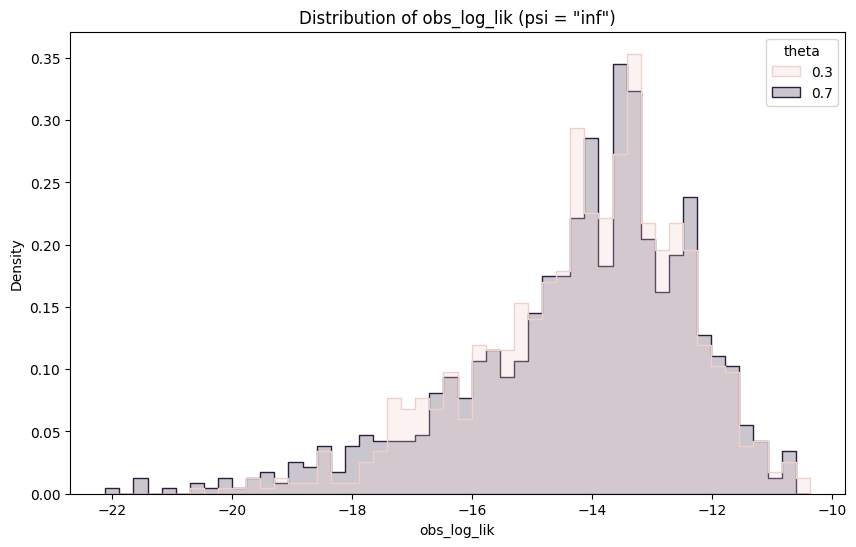

Kruskal–Wallis H = 0.01, p = 0.936


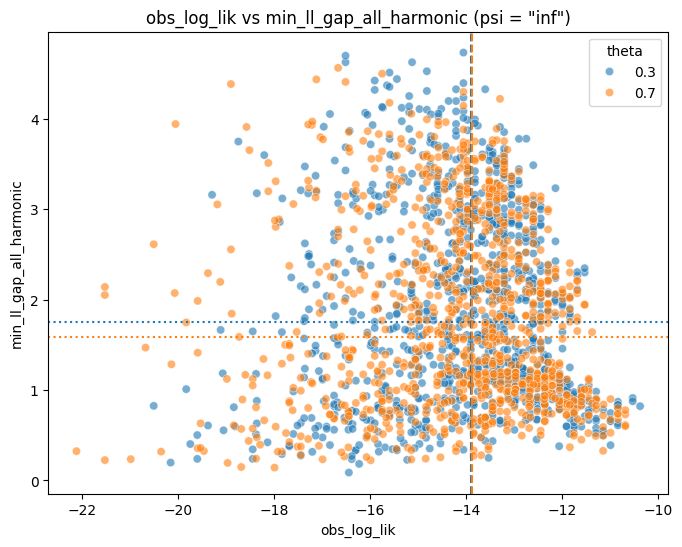

Theta = 0.3
  Pearson r = nan, p = nan
  Spearman rho = nan, p = nan
Theta = 0.7
  Pearson r = -0.05, p = 0.0916
  Spearman rho = -0.08, p = 0.00811

=== Theta = 0.3 ===
Top 10% threshold (min_ll_gap_all_harmonic) = 3.473
Top: 100, Rest: 899


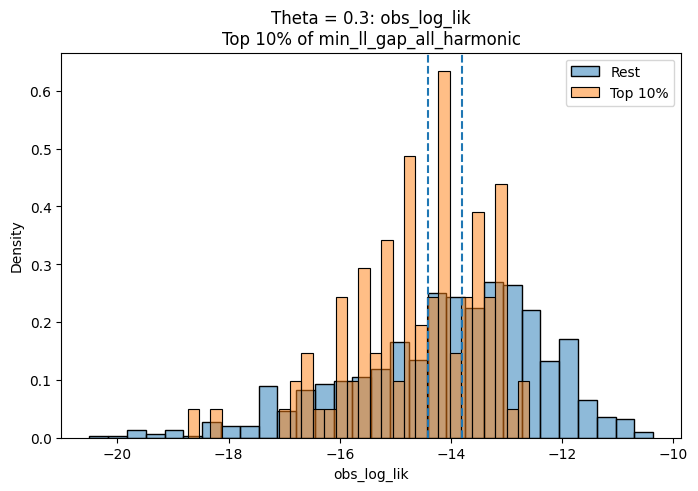

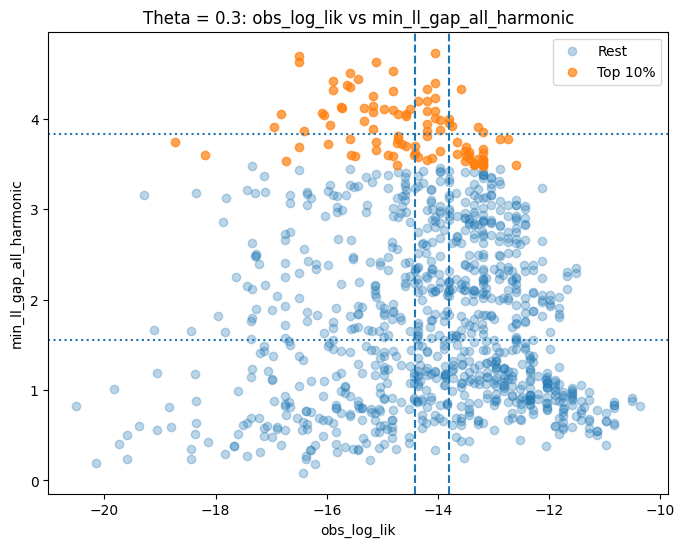

Mann–Whitney U = 33762.5, p = 4.36e-05

=== Theta = 0.7 ===
Top 10% threshold (min_ll_gap_all_harmonic) = 3.317
Top: 100, Rest: 900


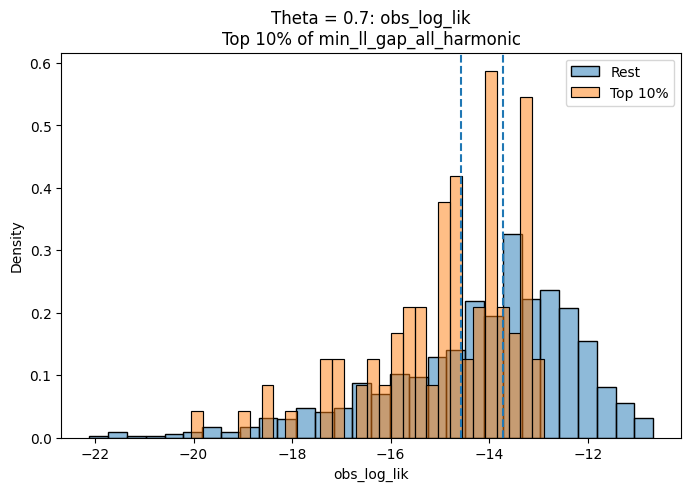

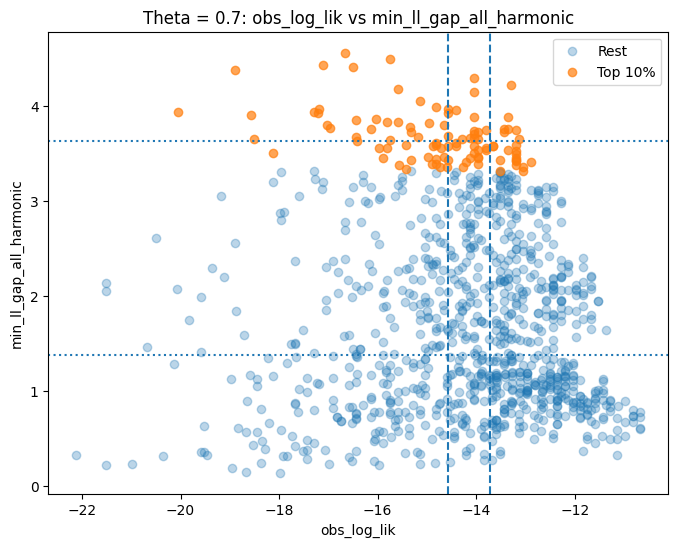

Mann–Whitney U = 31808.5, p = 1.48e-06


,psi,theta,obs_id,obs_seq,obs_log_lik,min_ll_gap_all_T,min_ll_gap_all_F,min_ll_gap_goal_T,min_ll_gap_goal_F,min_ll_gap_all_min,min_ll_gap_all_mean,min_ll_gap_all_harmonic,min_ll_gap_goal_min,min_ll_gap_goal_mean,min_ll_gap_goal_harmonic,scope,method,top_p_ll,top_n_obs
0,inf,0.3,423,"[(1, 0, 0, 0, 0, 0), (0, 0, 1, 0, 0, 0), (0, 1...",-12.592538,3.913495,3.144733,4.385167,3.144733,3.144733,3.529114,3.487248,3.144733,3.764950,3.662779,all,harmonic,10,2
1,inf,0.3,291,"[(1, 0, 0, 0, 0, 0), (0, 1, 0, 0, 0, 0), (0, 1...",-12.738075,4.063329,3.534286,4.690455,3.534286,3.534286,3.798808,3.780389,3.534286,4.112371,4.031108,all,harmonic,10,2
2,inf,0.7,644,"[(0, 0, 0, 0, 1, 0), (0, 0, 0, 0, 1, 0), (0, 0...",-12.892226,3.785418,3.113295,4.624805,3.113295,3.113295,3.449357,3.416615,3.113295,3.869050,3.721426,all,harmonic,10,2
3,inf,0.7,198,"[(0, 0, 0, 1, 0, 0), (0, 0, 0, 0, 0, 1), (0, 0...",-13.046377,4.063268,2.803821,4.821707,2.803821,2.803821,3.433544,3.318051,2.803821,3.812764,3.545775,all,harmonic,10,2


In [24]:
df_top_inf = analyze_ll_gap_by_theta(
    df_output,
    psi="inf",
    scope="all",
    method="harmonic",
    top_p_ll=10,
    top_n_obs=2,
    show_plots=True,
    run_tests=True
)

df_top_inf

In [29]:
print("Top observation sequences for INF:")
for _, row in df_top_inf.iterrows():
    print(f"  theta={row['theta']}, obs_id={row['obs_id']}: {row['obs_seq']}")

Top observation sequences for INF:
  theta=0.3, obs_id=423: [(1, 0, 0, 0, 0, 0), (0, 0, 1, 0, 0, 0), (0, 1, 0, 0, 0, 0), (0, 0, 1, 0, 0, 0), (0, 0, 1, 0, 0, 0), (0, 1, 0, 0, 0, 0), (0, 1, 0, 0, 0, 0), (0, 0, 1, 0, 0, 0), (0, 0, 0, 1, 0, 0), (0, 1, 0, 0, 0, 0)]
  theta=0.3, obs_id=291: [(1, 0, 0, 0, 0, 0), (0, 1, 0, 0, 0, 0), (0, 1, 0, 0, 0, 0), (0, 1, 0, 0, 0, 0), (1, 0, 0, 0, 0, 0), (0, 1, 0, 0, 0, 0), (0, 1, 0, 0, 0, 0), (0, 1, 0, 0, 0, 0), (0, 1, 0, 0, 0, 0), (0, 0, 0, 1, 0, 0)]
  theta=0.7, obs_id=644: [(0, 0, 0, 0, 1, 0), (0, 0, 0, 0, 1, 0), (0, 0, 0, 0, 1, 0), (0, 0, 0, 0, 0, 1), (0, 0, 0, 0, 1, 0), (0, 0, 0, 0, 0, 1), (0, 0, 0, 0, 1, 0), (0, 0, 0, 1, 0, 0), (0, 0, 0, 0, 1, 0), (0, 0, 1, 0, 0, 0)]
  theta=0.7, obs_id=198: [(0, 0, 0, 1, 0, 0), (0, 0, 0, 0, 0, 1), (0, 0, 0, 0, 1, 0), (0, 0, 0, 0, 1, 0), (0, 0, 0, 0, 1, 0), (0, 0, 0, 0, 0, 1), (0, 0, 0, 0, 1, 0), (0, 0, 0, 1, 0, 0), (0, 0, 1, 0, 0, 0), (0, 0, 0, 0, 1, 0)]


## Persuade-up speakers


=== GLOBAL ANALYSIS: psi = persp ===


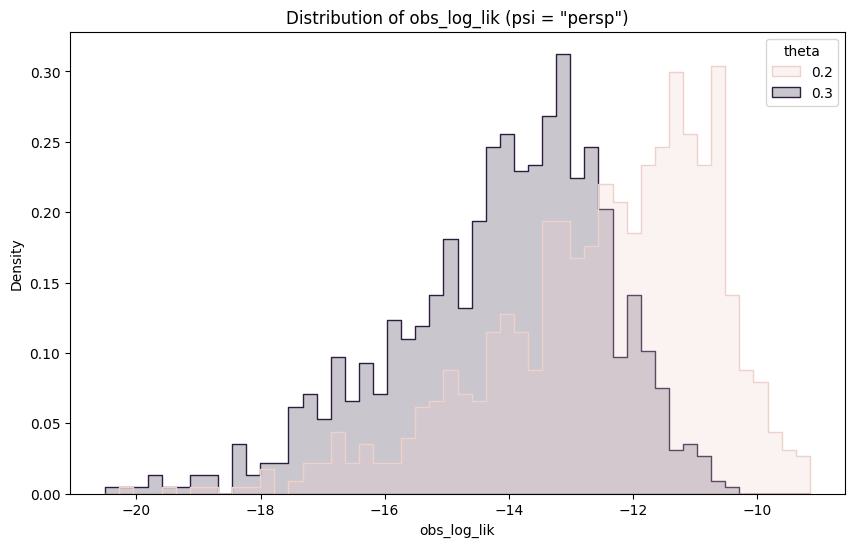

Kruskal–Wallis H = 441.22, p = 5.87e-98


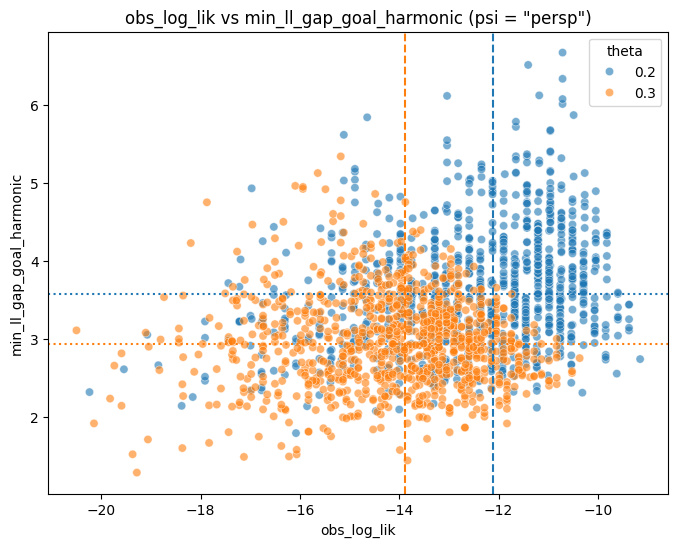

Theta = 0.2
  Pearson r = 0.24, p = 2.45e-14
  Spearman rho = 0.24, p = 8.4e-15
Theta = 0.3
  Pearson r = 0.00, p = 0.987
  Spearman rho = -0.02, p = 0.603

=== Theta = 0.2 ===
Top 5% threshold (min_ll_gap_goal_harmonic) = 4.991
Top: 50, Rest: 950


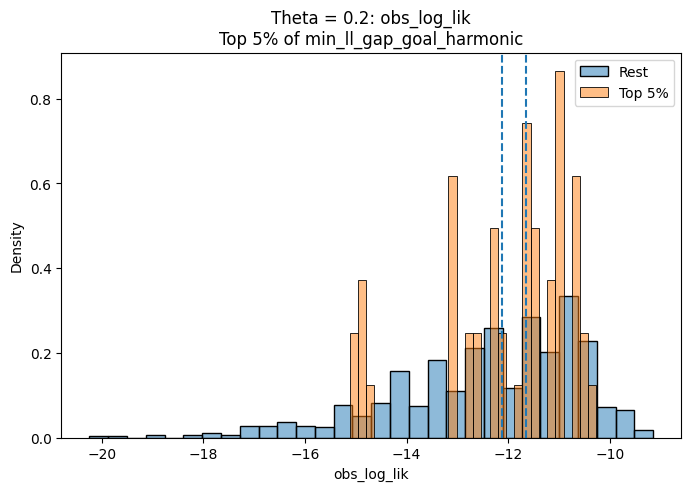

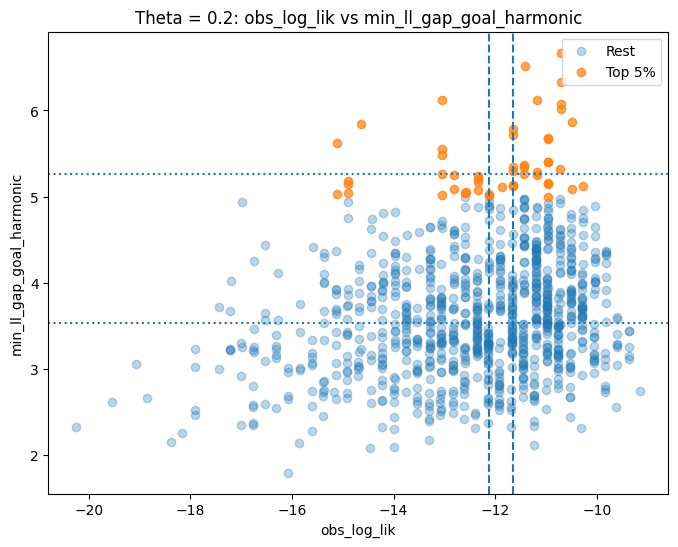

Mann–Whitney U = 26873.0, p = 0.117

=== Theta = 0.3 ===
Top 5% threshold (min_ll_gap_goal_harmonic) = 3.952
Top: 50, Rest: 950


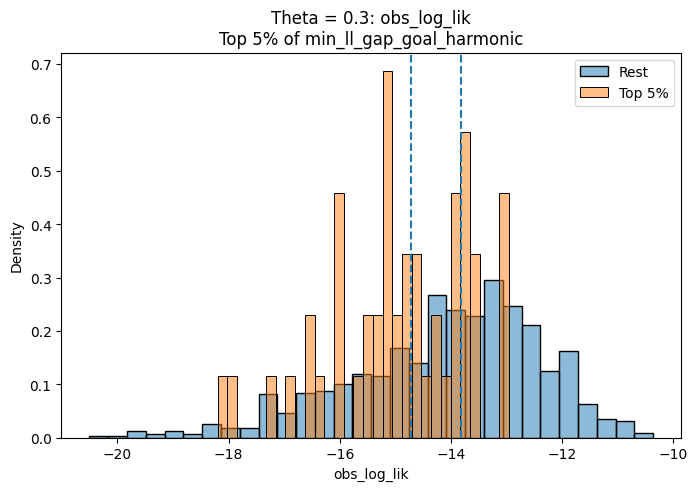

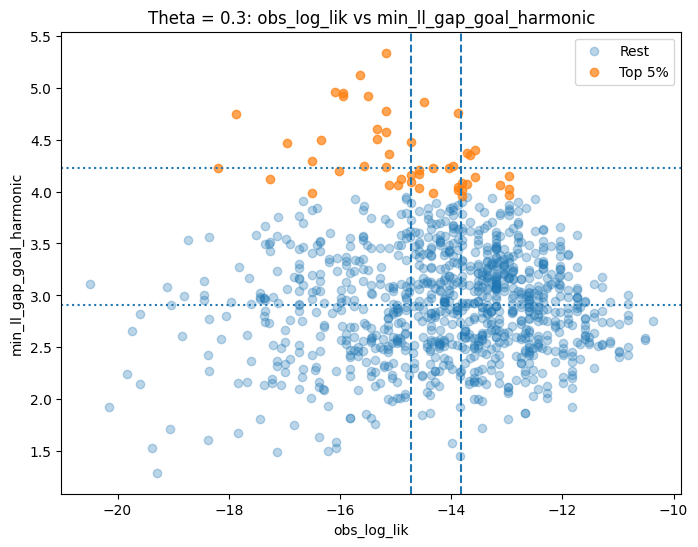

Mann–Whitney U = 15842.5, p = 7.12e-05


,psi,theta,obs_id,obs_seq,obs_log_lik,min_ll_gap_all_T,min_ll_gap_all_F,min_ll_gap_goal_T,min_ll_gap_goal_F,min_ll_gap_all_min,min_ll_gap_all_mean,min_ll_gap_all_harmonic,min_ll_gap_goal_min,min_ll_gap_goal_mean,min_ll_gap_goal_harmonic,scope,method,top_p_ll,top_n_obs
0,persp,0.2,489,"[(1, 0, 0, 0, 0, 0), (1, 0, 0, 0, 0, 0), (0, 1...",-10.264603,0.467760,0.489917,3.869331,7.598101,0.467760,0.478838,0.478582,3.869331,5.733716,5.127489,goal,harmonic,5,2
1,persp,0.2,842,"[(0, 1, 0, 0, 0, 0), (1, 0, 0, 0, 0, 0), (1, 0...",-10.487747,0.378749,0.278934,3.740070,7.930346,0.278934,0.328842,0.321267,3.740070,5.835208,5.082946,goal,harmonic,5,2
2,persp,0.3,196,"[(0, 0, 1, 0, 0, 0), (1, 0, 0, 0, 0, 0), (1, 0...",-12.961219,0.442139,0.268190,3.067964,6.433075,0.268190,0.355165,0.333866,3.067964,4.750519,4.154586,goal,harmonic,5,2
3,persp,0.3,226,"[(1, 0, 0, 0, 0, 0), (0, 1, 0, 0, 0, 0), (1, 0...",-12.961219,0.410522,0.410461,3.026115,6.008854,0.410461,0.410491,0.410491,3.026115,4.517485,4.025135,goal,harmonic,5,2


In [30]:
df_top_persp = analyze_ll_gap_by_theta(
    df_output,
    psi="persp",
    scope="goal",
    method="harmonic",
    top_p_ll=5,
    top_n_obs=2,
    show_plots=True,
    run_tests=True
)

df_top_persp

In [31]:
print("Top observation sequences for PERSP:")
for _, row in df_top_persp.iterrows():
    print(f"  theta={row['theta']}, obs_id={row['obs_id']}: {row['obs_seq']}")

Top observation sequences for PERSP:
  theta=0.2, obs_id=489: [(1, 0, 0, 0, 0, 0), (1, 0, 0, 0, 0, 0), (0, 1, 0, 0, 0, 0), (1, 0, 0, 0, 0, 0), (0, 1, 0, 0, 0, 0), (0, 1, 0, 0, 0, 0), (1, 0, 0, 0, 0, 0), (1, 0, 0, 0, 0, 0), (0, 1, 0, 0, 0, 0), (1, 0, 0, 0, 0, 0)]
  theta=0.2, obs_id=842: [(0, 1, 0, 0, 0, 0), (1, 0, 0, 0, 0, 0), (1, 0, 0, 0, 0, 0), (0, 1, 0, 0, 0, 0), (1, 0, 0, 0, 0, 0), (1, 0, 0, 0, 0, 0), (1, 0, 0, 0, 0, 0), (1, 0, 0, 0, 0, 0), (1, 0, 0, 0, 0, 0), (0, 1, 0, 0, 0, 0)]
  theta=0.3, obs_id=196: [(0, 0, 1, 0, 0, 0), (1, 0, 0, 0, 0, 0), (1, 0, 0, 0, 0, 0), (0, 1, 0, 0, 0, 0), (1, 0, 0, 0, 0, 0), (0, 1, 0, 0, 0, 0), (0, 1, 0, 0, 0, 0), (0, 0, 1, 0, 0, 0), (0, 1, 0, 0, 0, 0), (0, 0, 1, 0, 0, 0)]
  theta=0.3, obs_id=226: [(1, 0, 0, 0, 0, 0), (0, 1, 0, 0, 0, 0), (1, 0, 0, 0, 0, 0), (0, 1, 0, 0, 0, 0), (1, 0, 0, 0, 0, 0), (0, 1, 0, 0, 0, 0), (0, 1, 0, 0, 0, 0), (0, 0, 1, 0, 0, 0), (0, 0, 1, 0, 0, 0), (0, 0, 1, 0, 0, 0)]


## Persuade-down speakers


=== GLOBAL ANALYSIS: psi = persm ===


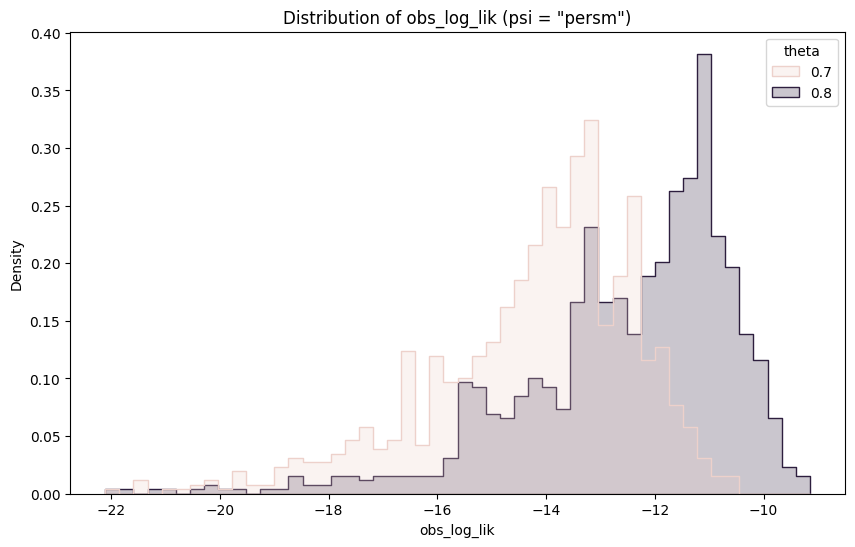

Kruskal–Wallis H = 406.06, p = 2.65e-90


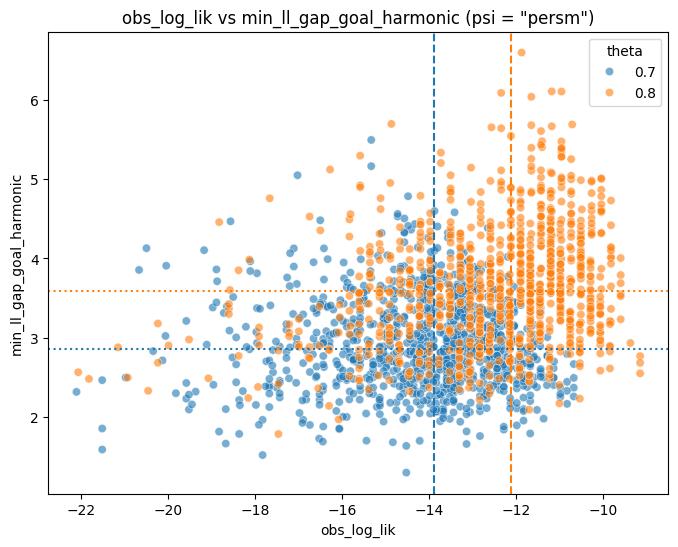

Theta = 0.7
  Pearson r = -0.02, p = 0.59
  Spearman rho = -0.03, p = 0.345
Theta = 0.8
  Pearson r = 0.24, p = 8.33e-15
  Spearman rho = 0.24, p = 7.97e-15

=== Theta = 0.7 ===
Top 4% threshold (min_ll_gap_goal_harmonic) = 3.990
Top: 40, Rest: 960


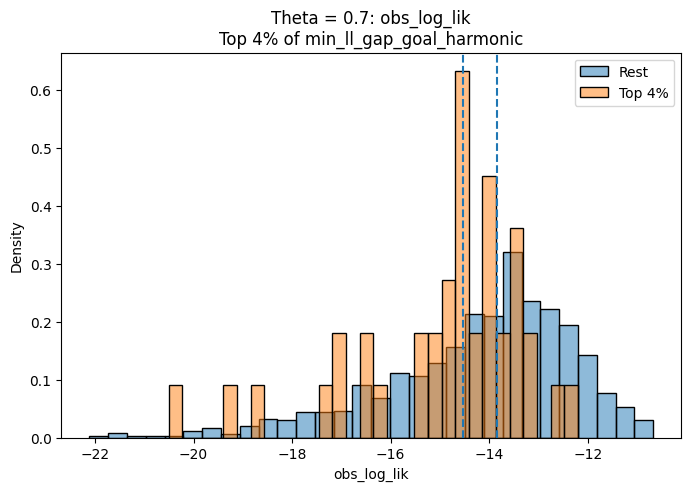

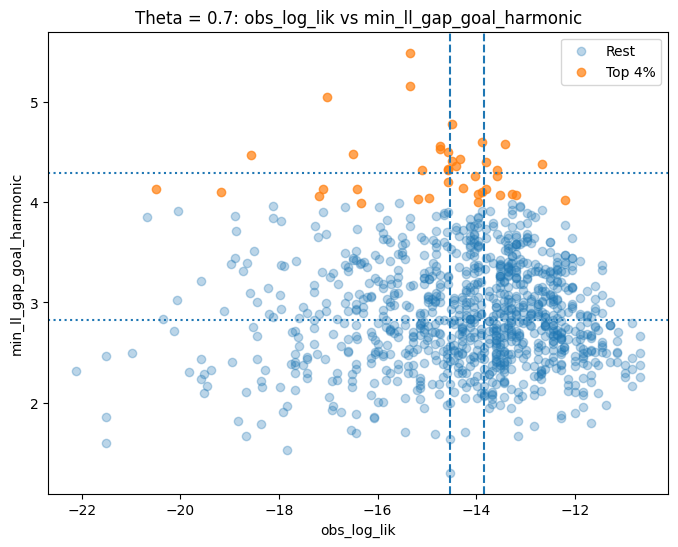

Mann–Whitney U = 13971.0, p = 0.00348

=== Theta = 0.8 ===
Top 4% threshold (min_ll_gap_goal_harmonic) = 5.023
Top: 40, Rest: 960


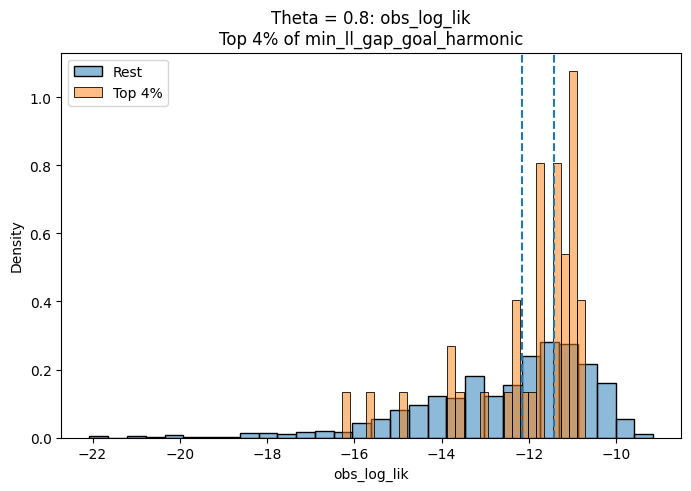

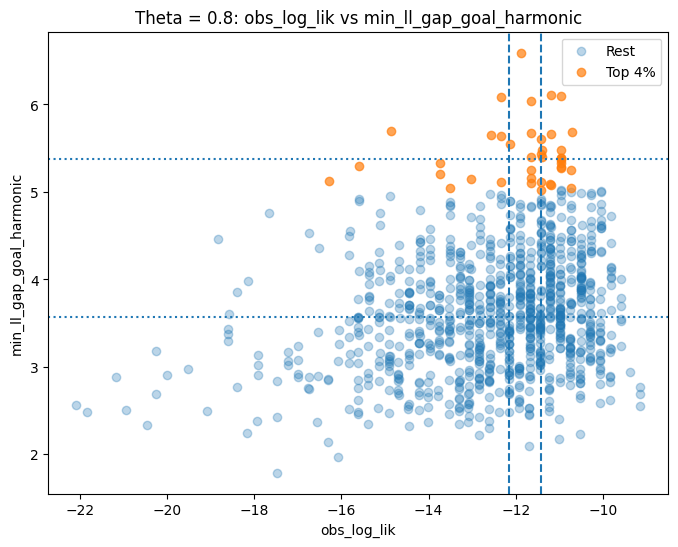

Mann–Whitney U = 23116.0, p = 0.0287


,psi,theta,obs_id,obs_seq,obs_log_lik,min_ll_gap_all_T,min_ll_gap_all_F,min_ll_gap_goal_T,min_ll_gap_goal_F,min_ll_gap_all_min,min_ll_gap_all_mean,min_ll_gap_all_harmonic,min_ll_gap_goal_min,min_ll_gap_goal_mean,min_ll_gap_goal_harmonic,scope,method,top_p_ll,top_n_obs
0,persm,0.7,374,"[(0, 0, 0, 0, 0, 1), (0, 0, 0, 0, 1, 0), (0, 0...",-12.199079,0.568891,0.361064,2.970386,6.218359,0.361064,0.464977,0.441755,2.970386,4.594373,4.020337,goal,harmonic,4,2
1,persm,0.7,650,"[(0, 0, 0, 0, 0, 1), (0, 0, 0, 0, 0, 1), (0, 0...",-12.652918,0.652105,0.277367,3.300576,6.528199,0.277367,0.464736,0.389194,3.300576,4.914387,4.384436,goal,harmonic,4,2
2,persm,0.8,412,"[(0, 0, 0, 0, 0, 1), (0, 0, 0, 0, 1, 0), (0, 0...",-10.710890,0.427823,0.453860,4.273115,8.502990,0.427823,0.440842,0.440457,4.273115,6.388052,5.687845,goal,harmonic,4,2
3,persm,0.8,538,"[(0, 0, 0, 0, 0, 1), (0, 0, 0, 0, 0, 1), (0, 0...",-10.734607,0.562326,0.463789,3.898232,7.137851,0.463789,0.513057,0.508326,3.898232,5.518041,5.042550,goal,harmonic,4,2


In [26]:
df_top_persm = analyze_ll_gap_by_theta(
    df_output,
    psi="persm",
    scope="goal",
    method="harmonic",
    top_p_ll=4,
    top_n_obs=2,
    show_plots=True,
    run_tests=True
)

df_top_persm

In [27]:
print("Top observation sequences for PERSM:")
for _, row in df_top_persm.iterrows():
    print(f"  theta={row['theta']}, obs_id={row['obs_id']}: {row['obs_seq']}")

Top observation sequences for PERSM:
  theta=0.7, obs_id=374: [(0, 0, 0, 0, 0, 1), (0, 0, 0, 0, 1, 0), (0, 0, 0, 0, 1, 0), (0, 0, 0, 1, 0, 0), (0, 0, 0, 0, 0, 1), (0, 0, 0, 1, 0, 0), (0, 0, 0, 0, 1, 0), (0, 0, 0, 1, 0, 0), (0, 0, 0, 0, 1, 0), (0, 0, 0, 0, 1, 0)]
  theta=0.7, obs_id=650: [(0, 0, 0, 0, 0, 1), (0, 0, 0, 0, 0, 1), (0, 0, 0, 0, 1, 0), (0, 0, 0, 0, 1, 0), (0, 0, 0, 0, 1, 0), (0, 0, 0, 0, 0, 1), (0, 0, 0, 0, 1, 0), (0, 0, 0, 1, 0, 0), (0, 0, 0, 0, 1, 0), (0, 0, 0, 0, 1, 0)]
  theta=0.8, obs_id=412: [(0, 0, 0, 0, 0, 1), (0, 0, 0, 0, 1, 0), (0, 0, 0, 0, 0, 1), (0, 0, 0, 0, 0, 1), (0, 0, 0, 0, 0, 1), (0, 0, 0, 0, 0, 1), (0, 0, 0, 0, 1, 0), (0, 0, 0, 0, 0, 1), (0, 0, 0, 0, 0, 1), (0, 0, 0, 0, 0, 1)]
  theta=0.8, obs_id=538: [(0, 0, 0, 0, 0, 1), (0, 0, 0, 0, 0, 1), (0, 0, 0, 0, 0, 1), (0, 0, 0, 0, 1, 0), (0, 0, 0, 1, 0, 0), (0, 0, 0, 0, 0, 1), (0, 0, 0, 0, 1, 0), (0, 0, 0, 0, 0, 1), (0, 0, 0, 0, 1, 0), (0, 0, 0, 0, 1, 0)]


# Overlap Analysis: All vs Goal scope


=== GLOBAL ANALYSIS: psi = persp ===


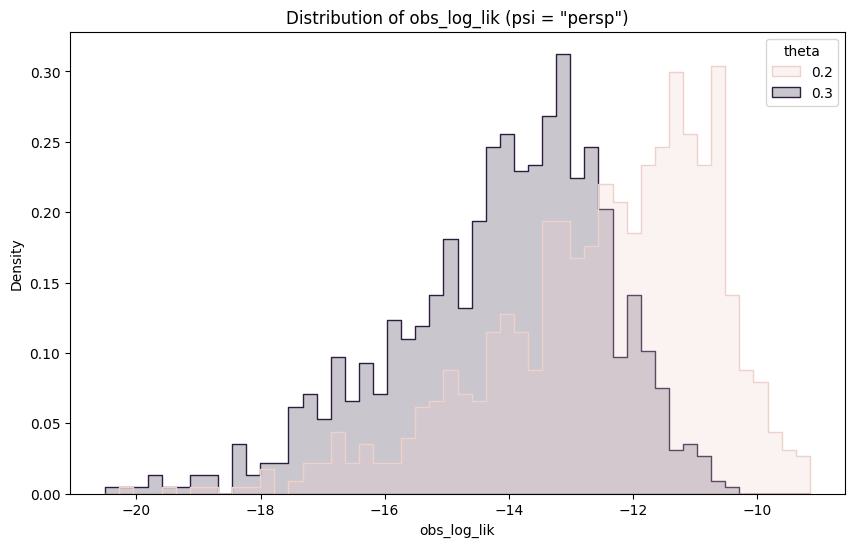

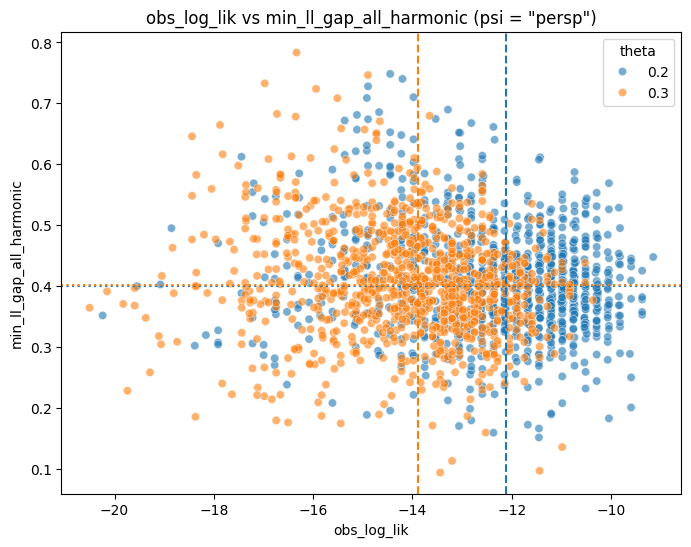


=== Theta = 0.2 ===
Top 10% threshold (min_ll_gap_all_harmonic) = 0.527
Top: 100, Rest: 899


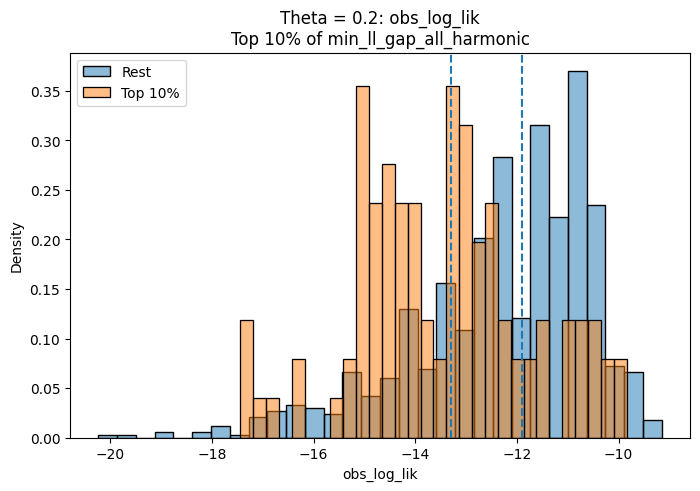

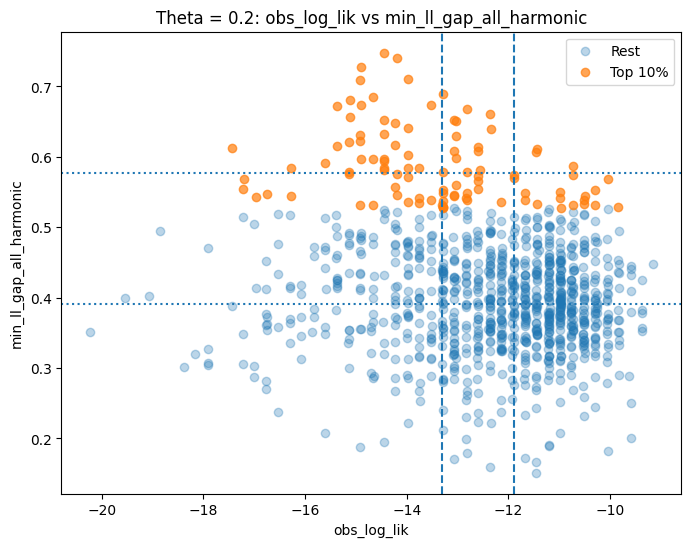


=== Theta = 0.3 ===
Top 10% threshold (min_ll_gap_all_harmonic) = 0.520
Top: 100, Rest: 900


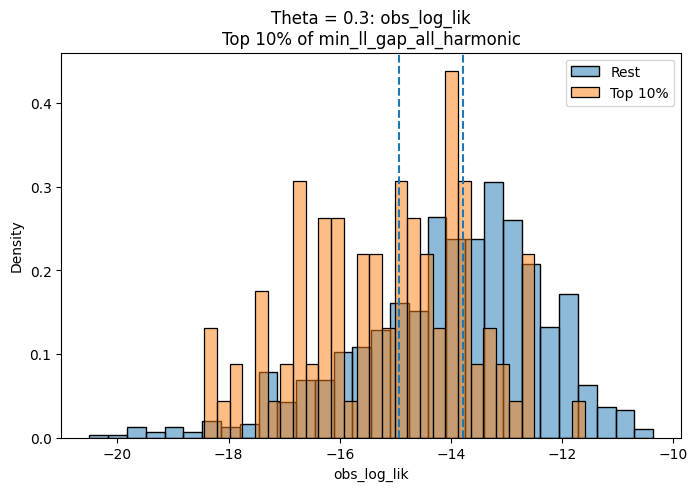

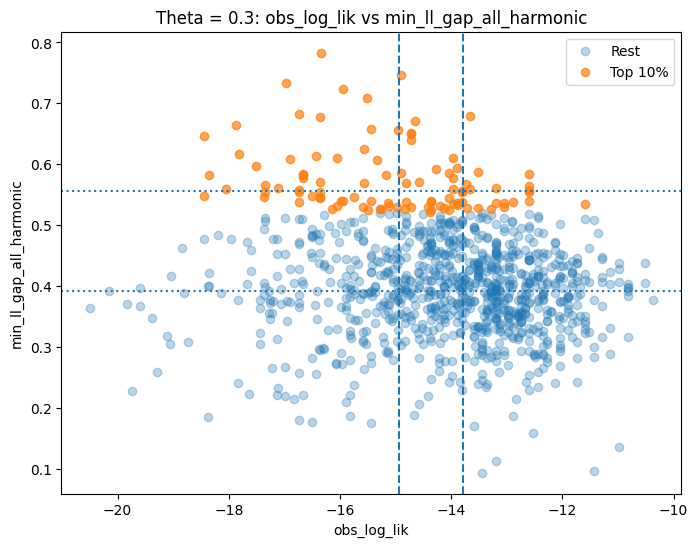


=== GLOBAL ANALYSIS: psi = persp ===


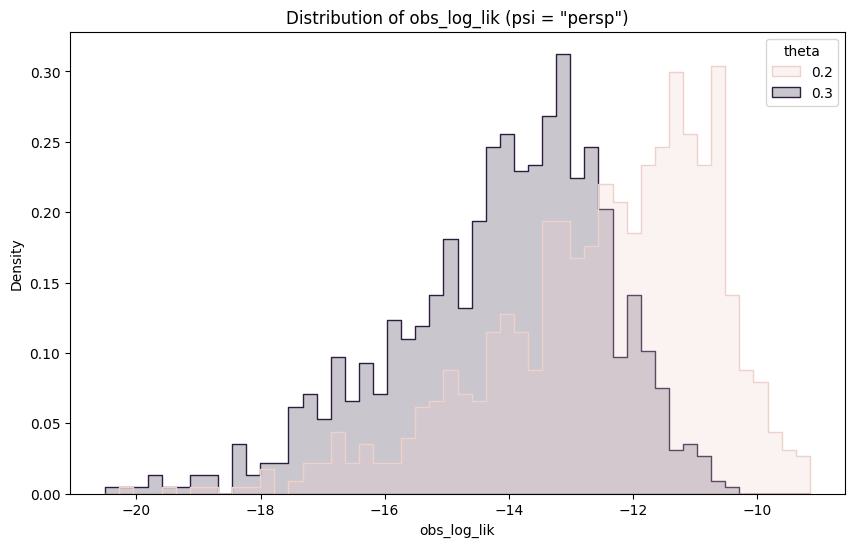

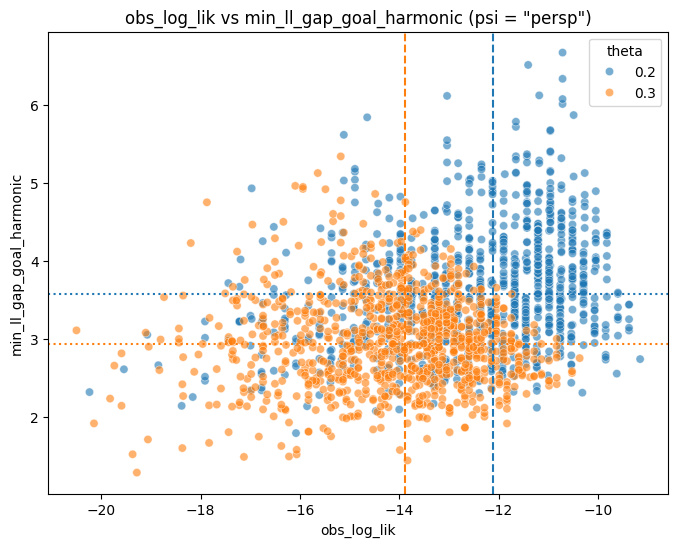


=== Theta = 0.2 ===
Top 5% threshold (min_ll_gap_goal_harmonic) = 4.991
Top: 50, Rest: 950


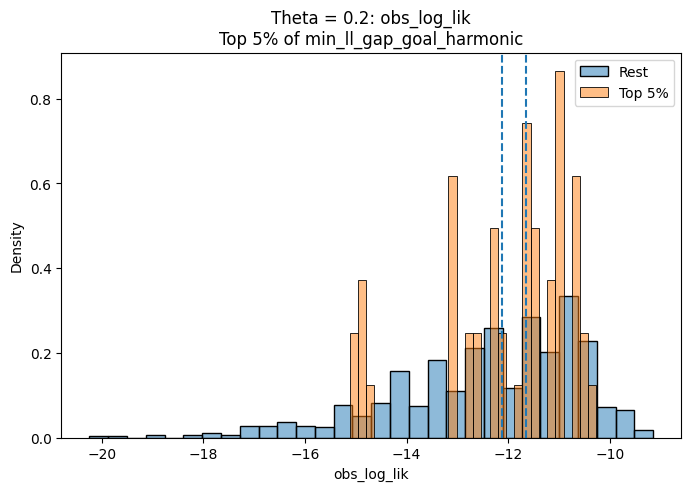

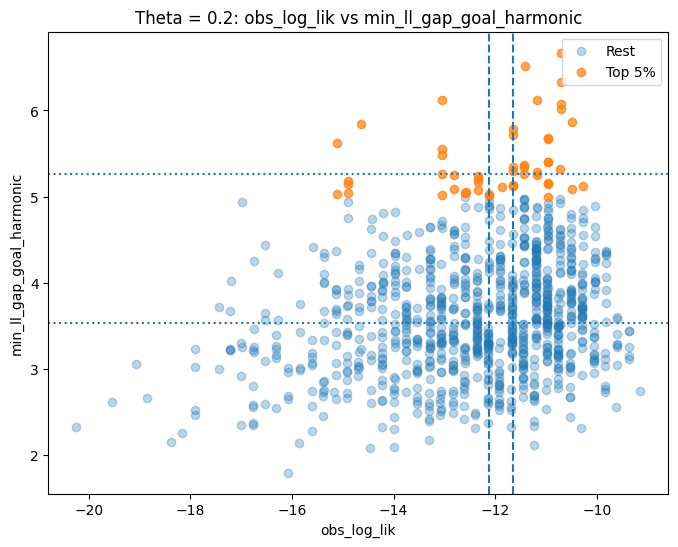


=== Theta = 0.3 ===
Top 5% threshold (min_ll_gap_goal_harmonic) = 3.952
Top: 50, Rest: 950


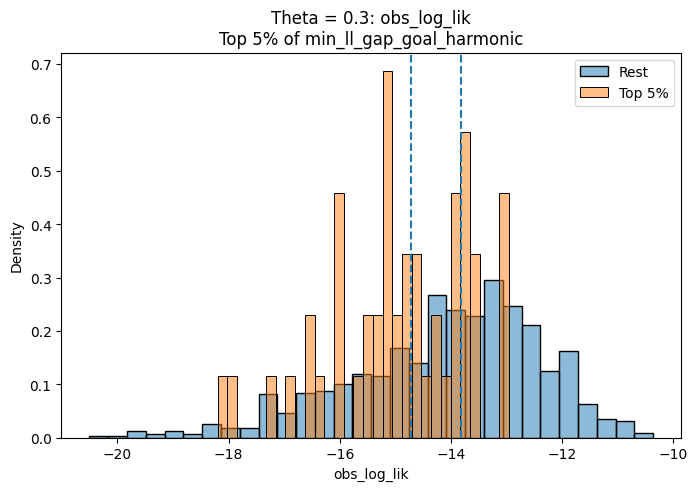

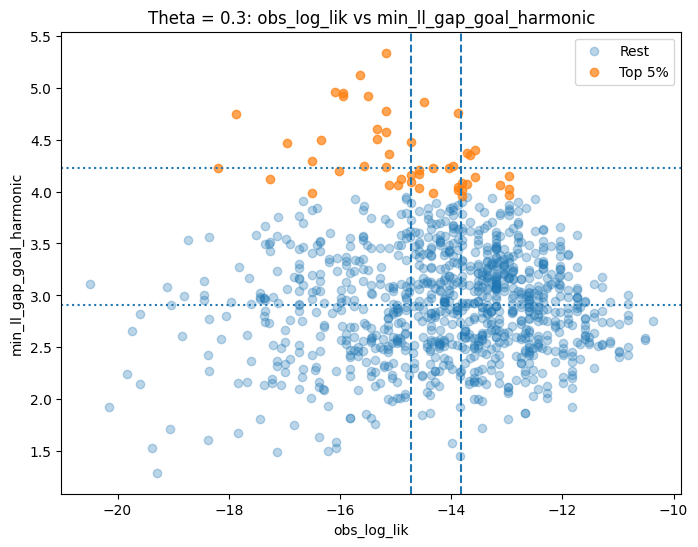

Strict overlap (same theta): 5


,psi_all,theta,obs_id,obs_seq_all,obs_log_lik_all,min_ll_gap_all_T_all,min_ll_gap_all_F_all,min_ll_gap_goal_T_all,min_ll_gap_goal_F_all,min_ll_gap_all_min_all,...,min_ll_gap_all_min_goal,min_ll_gap_all_mean_goal,min_ll_gap_all_harmonic_goal,min_ll_gap_goal_min_goal,min_ll_gap_goal_mean_goal,min_ll_gap_goal_harmonic_goal,scope_goal,method_goal,top_p_ll_goal,top_n_obs_goal
0,persp,0.2,765,"[(1, 0, 0, 0, 0, 0), (1, 0, 0, 0, 0, 0), (0, 1...",-10.487747,0.507615,0.585454,4.464258,8.568010,0.507615,...,0.507615,0.546535,0.543763,4.464258,6.516134,5.870015,goal,harmonic,5,20
1,persp,0.2,82,"[(1, 0, 0, 0, 0, 0), (1, 0, 0, 0, 0, 0), (1, 0...",-10.734607,0.550814,0.628212,4.102442,7.557282,0.550814,...,0.550814,0.589513,0.586973,4.102442,5.829862,5.318018,goal,harmonic,5,20
2,persp,0.2,276,"[(1, 0, 0, 0, 0, 0), (1, 0, 0, 0, 0, 0), (1, 0...",-10.957751,0.513539,0.541308,3.914566,7.488211,0.513539,...,0.513539,0.527424,0.527058,3.914566,5.701388,5.141396,goal,harmonic,5,20
3,persp,0.3,999,"[(1, 0, 0, 0, 0, 0), (0, 0, 1, 0, 0, 0), (1, 0...",-13.723359,0.550887,0.505500,3.191594,6.962681,0.505500,...,0.505500,0.528194,0.527219,3.191594,5.077137,4.376885,goal,harmonic,5,20
4,persp,0.3,141,"[(1, 0, 0, 0, 0, 0), (1, 0, 0, 0, 0, 0), (0, 1...",-13.808517,0.638735,0.492701,3.052555,5.863207,0.492701,...,0.492701,0.565718,0.556294,3.052555,4.457881,4.014859,goal,harmonic,5,20


In [15]:
# Find observations that are good for BOTH "all" and "goal" scopes
df_top_persp_all = analyze_ll_gap_by_theta(
    df_output,
    psi="persp",
    scope="all",
    method="harmonic",
    top_p_ll=10,
    top_n_obs=20,
    show_plots=True,
    run_tests=False
)

df_top_persp_goal = analyze_ll_gap_by_theta(
    df_output,
    psi="persp",
    scope="goal",
    method="harmonic",
    top_p_ll=5,
    top_n_obs=20,
    show_plots=True,
    run_tests=False
)

strict_overlap_persp = (
    df_top_persp_all.merge(
        df_top_persp_goal,
        on=["obs_id", "theta"],
        suffixes=("_all", "_goal"),
        how="inner"
    )
)

print(f"Strict overlap (same theta): {len(strict_overlap_persp)}")
strict_overlap_persp

In [16]:
print("Overlapping observation sequences for PERSP:")
for _, row in strict_overlap_persp.iterrows():
    print(f"  theta={row['theta']}, obs_id={row['obs_id']}: {row['obs_seq_all']}")

Overlapping observation sequences for PERSP:
  theta=0.2, obs_id=765: [(1, 0, 0, 0, 0, 0), (1, 0, 0, 0, 0, 0), (0, 1, 0, 0, 0, 0), (1, 0, 0, 0, 0, 0), (0, 1, 0, 0, 0, 0), (1, 0, 0, 0, 0, 0), (1, 0, 0, 0, 0, 0), (0, 1, 0, 0, 0, 0), (1, 0, 0, 0, 0, 0), (1, 0, 0, 0, 0, 0)]
  theta=0.2, obs_id=82: [(1, 0, 0, 0, 0, 0), (1, 0, 0, 0, 0, 0), (1, 0, 0, 0, 0, 0), (1, 0, 0, 0, 0, 0), (0, 1, 0, 0, 0, 0), (1, 0, 0, 0, 0, 0), (0, 0, 1, 0, 0, 0), (0, 1, 0, 0, 0, 0), (0, 1, 0, 0, 0, 0), (0, 1, 0, 0, 0, 0)]
  theta=0.2, obs_id=276: [(1, 0, 0, 0, 0, 0), (1, 0, 0, 0, 0, 0), (1, 0, 0, 0, 0, 0), (0, 0, 1, 0, 0, 0), (0, 1, 0, 0, 0, 0), (0, 1, 0, 0, 0, 0), (1, 0, 0, 0, 0, 0), (0, 1, 0, 0, 0, 0), (1, 0, 0, 0, 0, 0), (1, 0, 0, 0, 0, 0)]
  theta=0.3, obs_id=999: [(1, 0, 0, 0, 0, 0), (0, 0, 1, 0, 0, 0), (1, 0, 0, 0, 0, 0), (0, 0, 1, 0, 0, 0), (0, 1, 0, 0, 0, 0), (0, 1, 0, 0, 0, 0), (1, 0, 0, 0, 0, 0), (0, 1, 0, 0, 0, 0), (1, 0, 0, 0, 0, 0), (0, 0, 1, 0, 0, 0)]
  theta=0.3, obs_id=141: [(1, 0, 0, 0, 0, 0), (1, 0,

In [22]:
# Find observations that are good for BOTH "all" and "goal" scopes
df_top_persp_all = analyze_ll_gap_by_theta(
    df_output,
    psi="persp",
    scope="all",
    method="harmonic",
    top_p_ll=7,
    top_n_obs=20,
    show_plots=False,
    run_tests=False
)

df_top_persp_goal = analyze_ll_gap_by_theta(
    df_output,
    psi="persp",
    scope="goal",
    method="harmonic",
    top_p_ll=7,
    top_n_obs=20,
    show_plots=False,
    run_tests=False
)

strict_overlap_persp = (
    df_top_persp_all.merge(
        df_top_persp_goal,
        on=["obs_id", "theta"],
        suffixes=("_all", "_goal"),
        how="inner"
    )
)

print(f"Strict overlap (same theta): {len(strict_overlap_persp)}")
strict_overlap_persp


=== GLOBAL ANALYSIS: psi = persp ===

=== Theta = 0.2 ===
Top 7% threshold (min_ll_gap_all_harmonic) = 0.547
Top: 70, Rest: 929

=== Theta = 0.3 ===
Top 7% threshold (min_ll_gap_all_harmonic) = 0.538
Top: 70, Rest: 930

=== GLOBAL ANALYSIS: psi = persp ===

=== Theta = 0.2 ===
Top 7% threshold (min_ll_gap_goal_harmonic) = 4.864
Top: 70, Rest: 930

=== Theta = 0.3 ===
Top 7% threshold (min_ll_gap_goal_harmonic) = 3.828
Top: 70, Rest: 930
Strict overlap (same theta): 4


,psi_all,theta,obs_id,obs_seq_all,obs_log_lik_all,min_ll_gap_all_T_all,min_ll_gap_all_F_all,min_ll_gap_goal_T_all,min_ll_gap_goal_F_all,min_ll_gap_all_min_all,...,min_ll_gap_all_min_goal,min_ll_gap_all_mean_goal,min_ll_gap_all_harmonic_goal,min_ll_gap_goal_min_goal,min_ll_gap_goal_mean_goal,min_ll_gap_goal_harmonic_goal,scope_goal,method_goal,top_p_ll_goal,top_n_obs_goal
0,persp,0.2,452,"[(1, 0, 0, 0, 0, 0), (1, 0, 0, 0, 0, 0), (1, 0...",-10.041460,0.651856,0.504460,3.774431,6.962312,0.504460,...,0.504460,0.578158,0.568764,3.774431,5.368371,4.895110,goal,harmonic,7,20
1,persp,0.2,82,"[(1, 0, 0, 0, 0, 0), (1, 0, 0, 0, 0, 0), (1, 0...",-10.734607,0.550814,0.628212,4.102442,7.557282,0.550814,...,0.550814,0.589513,0.586973,4.102442,5.829862,5.318018,goal,harmonic,7,20
2,persp,0.2,641,"[(1, 0, 0, 0, 0, 0), (1, 0, 0, 0, 0, 0), (1, 0...",-10.734607,0.544456,0.606444,3.807817,7.156889,0.544456,...,0.544456,0.575450,0.573781,3.807817,5.482353,4.970881,goal,harmonic,7,20
3,persp,0.3,141,"[(1, 0, 0, 0, 0, 0), (1, 0, 0, 0, 0, 0), (0, 1...",-13.808517,0.638735,0.492701,3.052555,5.863207,0.492701,...,0.492701,0.565718,0.556294,3.052555,4.457881,4.014859,goal,harmonic,7,20



=== GLOBAL ANALYSIS: psi = persm ===


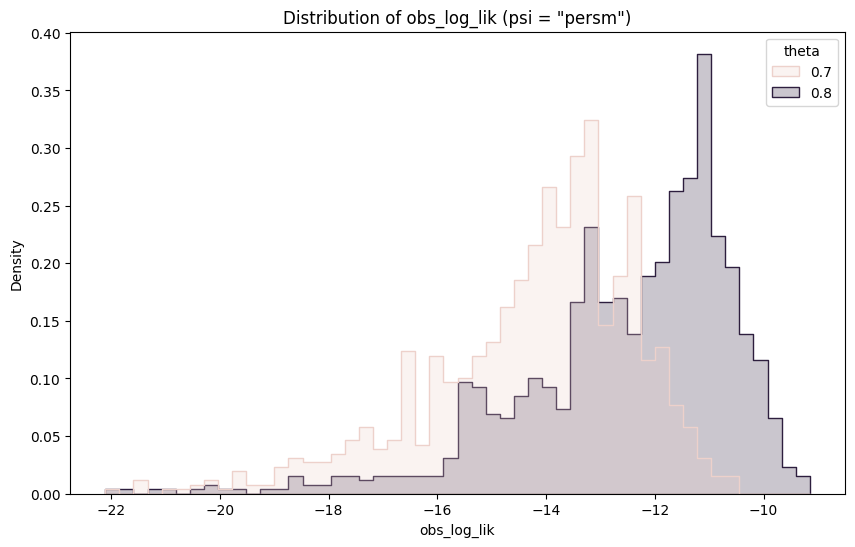

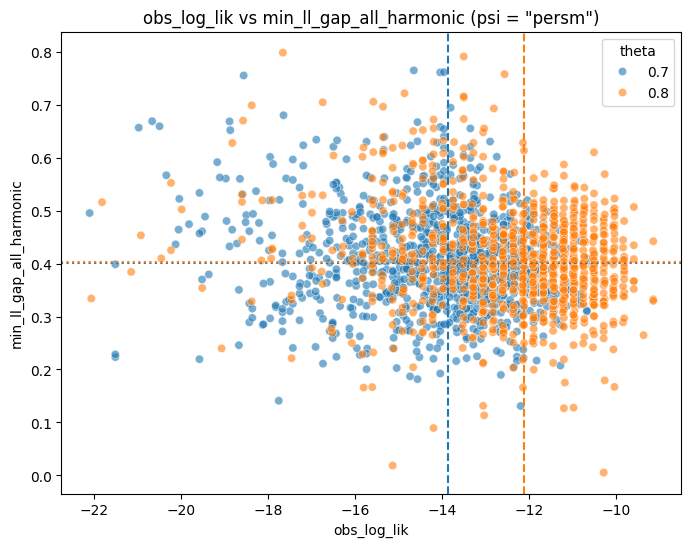


=== Theta = 0.7 ===
Top 8% threshold (min_ll_gap_all_harmonic) = 0.548
Top: 80, Rest: 920


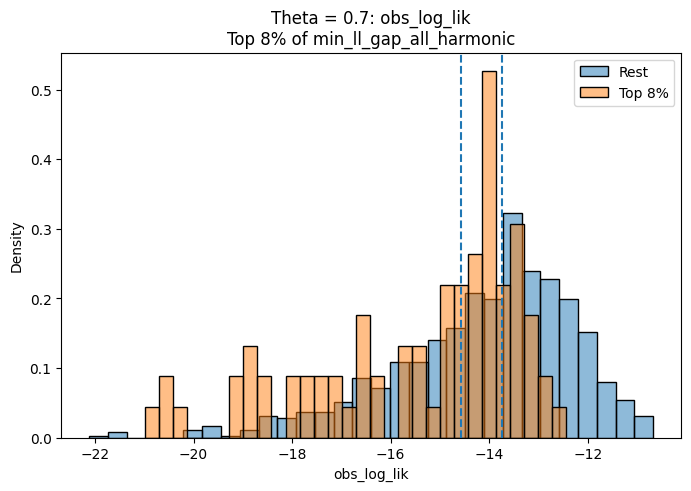

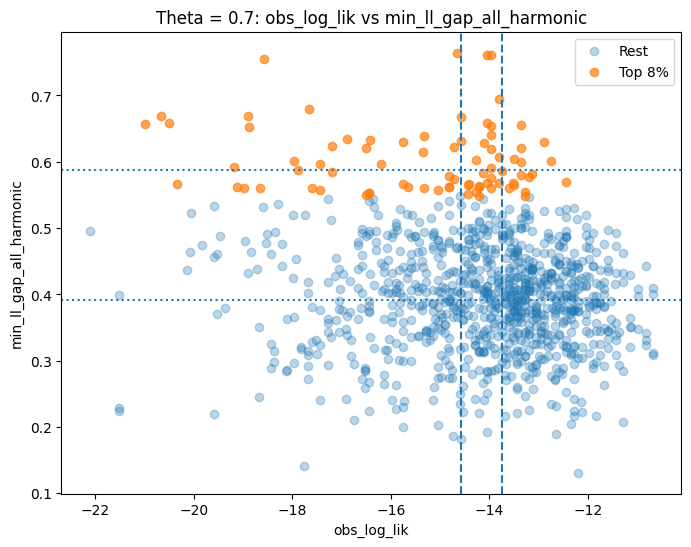


=== Theta = 0.8 ===
Top 8% threshold (min_ll_gap_all_harmonic) = 0.541
Top: 80, Rest: 919


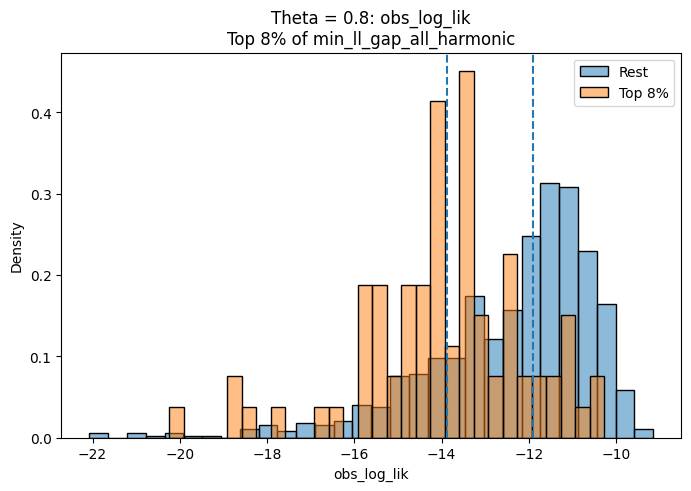

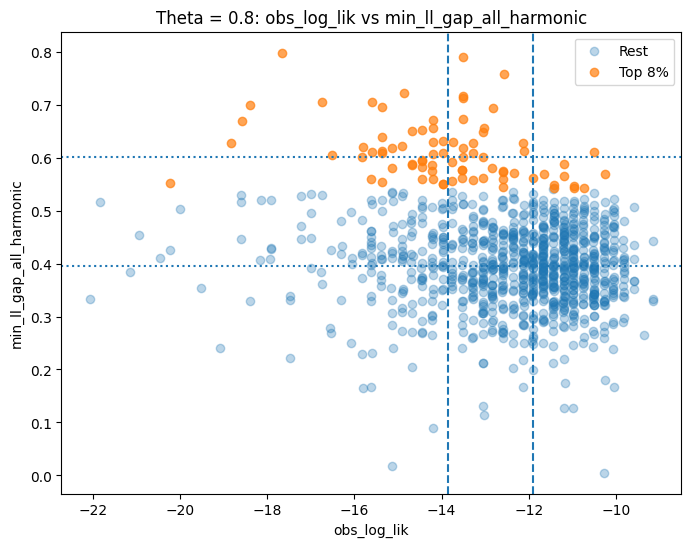


=== GLOBAL ANALYSIS: psi = persm ===


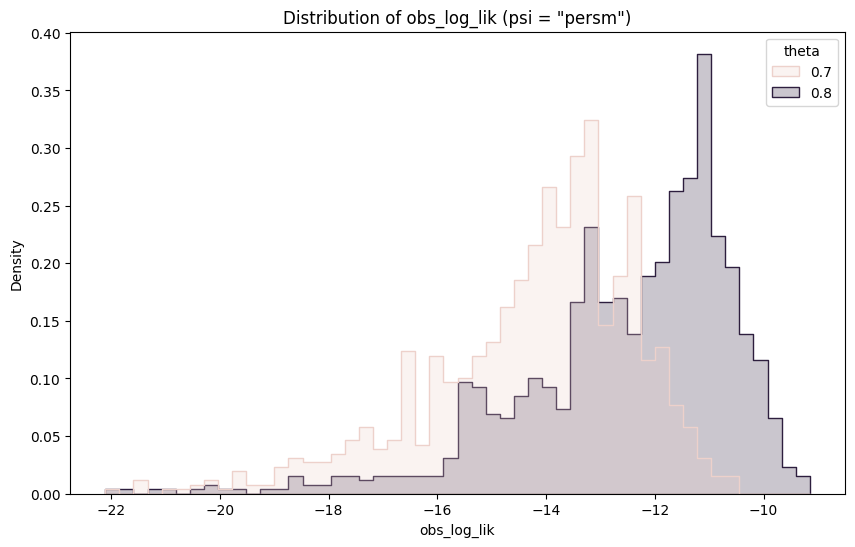

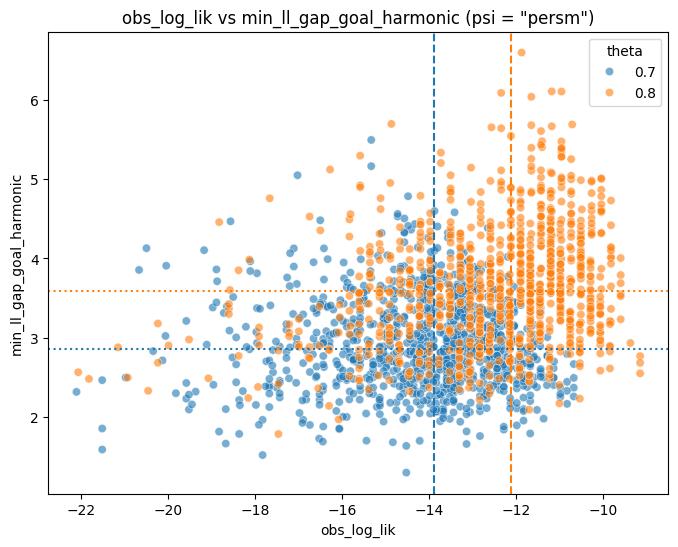


=== Theta = 0.7 ===
Top 6% threshold (min_ll_gap_goal_harmonic) = 3.861
Top: 60, Rest: 940


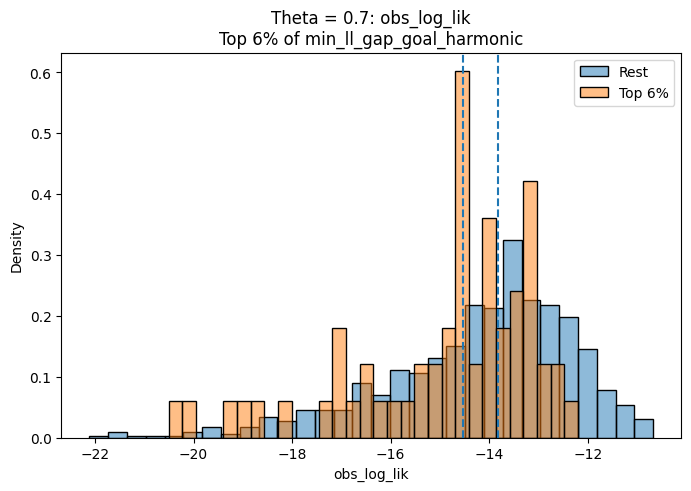

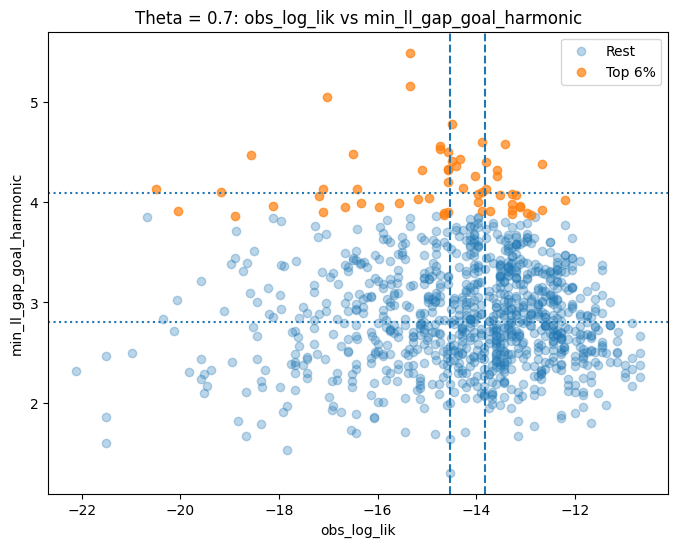


=== Theta = 0.8 ===
Top 6% threshold (min_ll_gap_goal_harmonic) = 4.883
Top: 60, Rest: 940


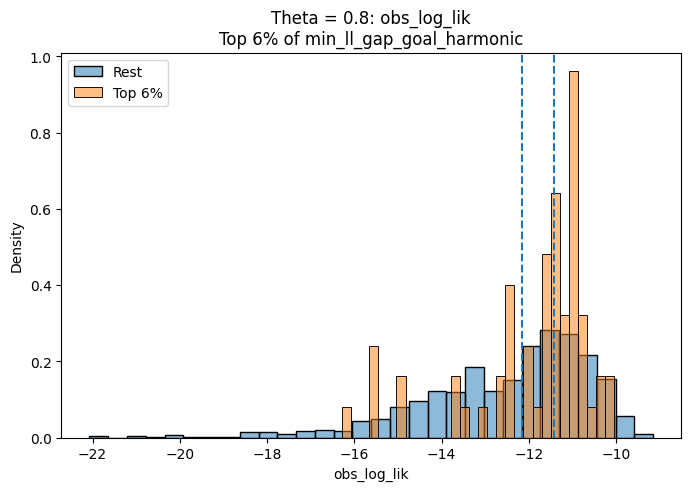

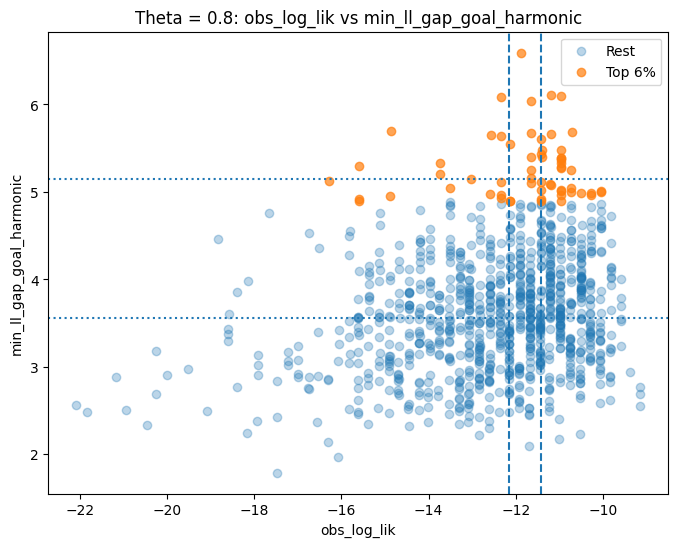

Strict overlap (same theta): 6


,psi_all,theta,obs_id,obs_seq_all,obs_log_lik_all,min_ll_gap_all_T_all,min_ll_gap_all_F_all,min_ll_gap_goal_T_all,min_ll_gap_goal_F_all,min_ll_gap_all_min_all,...,min_ll_gap_all_min_goal,min_ll_gap_all_mean_goal,min_ll_gap_all_harmonic_goal,min_ll_gap_goal_min_goal,min_ll_gap_goal_mean_goal,min_ll_gap_goal_harmonic_goal,scope_goal,method_goal,top_p_ll_goal,top_n_obs_goal
0,persm,0.7,383,"[(0, 0, 0, 0, 0, 1), (0, 0, 0, 0, 1, 0), (0, 0...",-13.508829,0.623125,0.587230,3.010159,6.275104,0.587230,...,0.587230,0.605178,0.604645,3.010159,4.642631,4.068610,goal,harmonic,6,20
1,persm,0.7,94,"[(0, 0, 0, 0, 0, 1), (0, 0, 0, 0, 0, 1), (0, 0...",-13.808517,0.482642,0.816582,3.393789,6.263992,0.482642,...,0.482642,0.649612,0.606696,3.393789,4.828890,4.402392,goal,harmonic,6,20
2,persm,0.7,858,"[(0, 0, 0, 0, 0, 1), (0, 0, 0, 0, 0, 1), (0, 0...",-13.808517,0.641128,0.756622,3.084707,6.252045,0.641128,...,0.641128,0.698875,0.694103,3.084707,4.668376,4.131143,goal,harmonic,6,20
3,persm,0.8,570,"[(0, 0, 0, 0, 0, 1), (0, 0, 0, 0, 0, 1), (0, 0...",-10.264603,0.507355,0.646729,3.669633,7.680765,0.507355,...,0.507355,0.577042,0.568626,3.669633,5.675199,4.966449,goal,harmonic,6,20
4,persm,0.8,673,"[(0, 0, 0, 0, 0, 1), (0, 0, 0, 0, 0, 1), (0, 0...",-10.957751,0.543547,0.542293,4.023096,7.671940,0.542293,...,0.542293,0.542920,0.542919,4.023096,5.847518,5.278300,goal,harmonic,6,20
5,persm,0.8,967,"[(0, 0, 0, 0, 0, 1), (0, 0, 0, 0, 0, 1), (0, 0...",-10.957751,0.675459,0.458302,4.203039,7.519885,0.458302,...,0.458302,0.566881,0.546084,4.203039,5.861462,5.392233,goal,harmonic,6,20


In [28]:
df_top_persm_all = analyze_ll_gap_by_theta(
    df_output,
    psi="persm",
    scope="all",
    method="harmonic",
    top_p_ll=8,
    top_n_obs=20,
    show_plots=True,
    run_tests=False
)

df_top_persm_goal = analyze_ll_gap_by_theta(
    df_output,
    psi="persm",
    scope="goal",
    method="harmonic",
    top_p_ll=6,
    top_n_obs=20,
    show_plots=True,
    run_tests=False
)

strict_overlap_persm = (
    df_top_persm_all.merge(
        df_top_persm_goal,
        on=["obs_id", "theta"],
        suffixes=("_all", "_goal"),
        how="inner"
    )
)

print(f"Strict overlap (same theta): {len(strict_overlap_persm)}")
strict_overlap_persm

In [46]:
print("Overlapping observation sequences for PERSM:")
for _, row in strict_overlap_persm.iterrows():
    print(f"  theta={row['theta']}, obs_id={row['obs_id']}: {row['obs_seq_all']}")

Overlapping observation sequences for PERSM:
  theta=0.7, obs_id=383: [(0, 0, 0, 0, 0, 1), (0, 0, 0, 0, 1, 0), (0, 0, 0, 0, 0, 1), (0, 0, 0, 1, 0, 0), (0, 0, 1, 0, 0, 0), (0, 0, 0, 0, 1, 0), (0, 0, 0, 1, 0, 0), (0, 0, 0, 1, 0, 0), (0, 0, 0, 1, 0, 0), (0, 0, 0, 1, 0, 0)]
  theta=0.7, obs_id=94: [(0, 0, 0, 0, 0, 1), (0, 0, 0, 0, 0, 1), (0, 0, 0, 0, 0, 1), (0, 0, 0, 0, 1, 0), (0, 0, 0, 1, 0, 0), (0, 0, 0, 0, 1, 0), (0, 0, 1, 0, 0, 0), (0, 0, 0, 0, 1, 0), (0, 0, 0, 0, 1, 0), (0, 0, 0, 1, 0, 0)]
  theta=0.7, obs_id=858: [(0, 0, 0, 0, 0, 1), (0, 0, 0, 0, 0, 1), (0, 0, 1, 0, 0, 0), (0, 0, 0, 0, 0, 1), (0, 0, 0, 1, 0, 0), (0, 0, 0, 0, 1, 0), (0, 0, 0, 1, 0, 0), (0, 0, 0, 0, 1, 0), (0, 0, 0, 0, 1, 0), (0, 0, 0, 0, 1, 0)]
  theta=0.7, obs_id=627: [(0, 0, 0, 0, 0, 1), (0, 0, 0, 0, 0, 1), (0, 0, 1, 0, 0, 0), (0, 0, 0, 0, 0, 1), (0, 0, 0, 1, 0, 0), (0, 0, 0, 0, 1, 0), (0, 0, 0, 0, 1, 0), (0, 0, 0, 1, 0, 0), (0, 0, 0, 1, 0, 0), (0, 0, 0, 0, 1, 0)]
  theta=0.7, obs_id=70: [(0, 0, 0, 0, 0, 1), (0, 0, 

# Summary: Selected Observation Sequences

For N=1, M=5, T=10, observations are sequences of 10 integers (each 0-5, representing successes in 5 trials).

These sequences will be used for the final behavioral experiment.

In [ ]:
# Combine all top observations
df_all_top = pd.concat([df_top_inf, df_top_persp, df_top_persm], ignore_index=True)

print(f"Total selected observations: {len(df_all_top)}")
print(f"\nBy psi:")
print(df_all_top.groupby("psi").size())
print(f"\nBy (psi, theta):")
print(df_all_top.groupby(["psi", "theta"]).size())

In [ ]:
# Save selected observations
df_all_top.to_csv("selected_obs_seq_n1m5.csv", index=False)
print("Saved to selected_obs_seq_n1m5.csv")

In [ ]:
# Display final selections in a nice format
print("=" * 70)
print("SELECTED OBSERVATION SEQUENCES FOR N=1, M=5, T=10")
print("=" * 70)

for psi in ["inf", "persp", "persm"]:
    psi_name = {"inf": "Informative", "persp": "Persuade-up", "persm": "Persuade-down"}[psi]
    print(f"\n{psi_name}:")
    
    for _, row in df_all_top[df_all_top["psi"] == psi].iterrows():
        print(f"  θ={row['theta']}, obs_id={row['obs_id']}: {row['obs_seq']}")
        print(f"    ll_gap_all_harmonic={row['min_ll_gap_all_harmonic']:.3f}, obs_log_lik={row['obs_log_lik']:.2f}")

SyntaxError: invalid syntax (207406165.py, line 2)